# RStanarm baysian and justifications

In [1]:
# Load packages
library(tidyverse) # for data manipulation
library(rstanarm) # For bayesian estimates of alpha and beta diversity
library(gridExtra) # For arranging ggplots
library(mgcv) # For beta distribution (beta diversity)
library(RColorBrewer) # colors for barplots
library(grid) # for text grobs in gridExtra
library(vegan) # for adonis
library(MASS) # for fitdistr
library(car) # for Anova
library(betareg) # for beta regression

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.0 ──
✔ ggplot2 3.2.1          ✔ purrr   0.3.3     
✔ tibble  2.1.3          ✔ dplyr   0.8.3     
✔ tidyr   1.0.0.9000     ✔ stringr 1.4.0     
✔ readr   1.3.1          ✔ forcats 0.4.0     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
Loading required package: Rcpp
Registered S3 method overwritten by 'xts':
  method     from
  as.zoo.xts zoo 
rstanarm (Version 2.19.2, packaged: 2019-10-01 20:20:33 UTC)
- Do not expect the default priors to remain the same in future rstanarm versions.
Thus, R scripts should specify priors explicitly, even if they are just the defaults.
- For execution on a local, multicore CPU with excess RAM we recommend calling
options(mc.cores = parallel::detectCores())
- bayesplot theme set to bayesplot::theme_default()
   * Does _not_ affect other ggplot2 plots
   * See ?bayesplot

In [2]:
# Read in mapping files and OTU tables

load("./3_5sp_mapping_otu_downstream/mf_alt_filt_final.RData")
load("./3_5sp_mapping_otu_downstream/otu_filt.RData")
load("./3_5sp_mapping_otu_downstream/otu_filt_inhibOnly.RData")
load("./3_5sp_mapping_otu_downstream/braycurtis_filt.Rdata")
load("./3_5sp_mapping_otu_downstream/unweighted_unifrac_filt.Rdata")
load("./3_5sp_mapping_otu_downstream/weighted_unifrac_filt.Rdata")
load("./3_5sp_mapping_otu_downstream/alpha_metrics.Rdata")
load("./3_5sp_mapping_otu_downstream/beta_metrics.Rdata")

mf_con <- mf_alt_filt_final %>%
filter(Bd_exposure == "Control")

mf_treat <- mf_alt_filt_final %>%
filter(Bd_exposure == "Bd-exposed")

dir.create("./4_Bayesian_models")

Warning message in dir.create("./4_Bayesian_models"):
“'./4_Bayesian_models' already exists”

## Visualizing data
First, let's visualize all our data. 

Warning message:
“Removed 515 rows containing missing values (geom_point).”

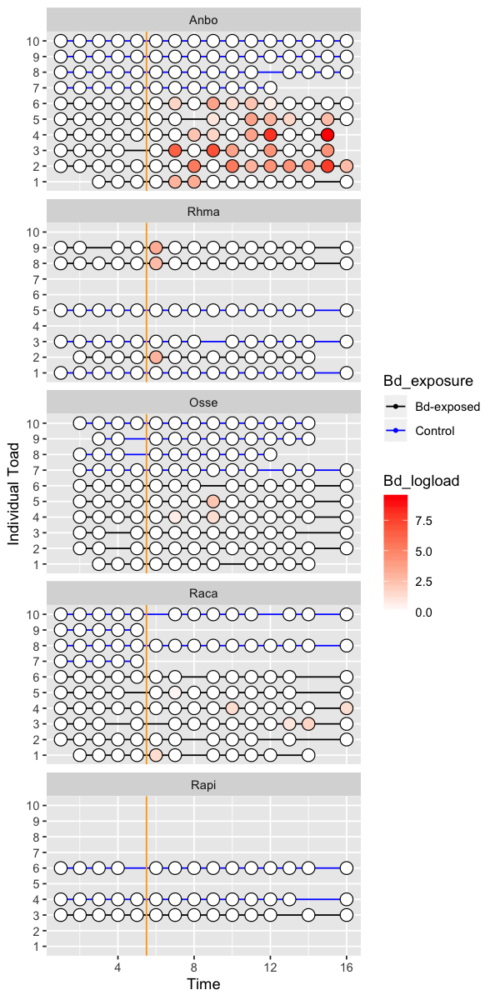

In [3]:
#### PLOTTING EXP DESIGN ####
options(repr.plot.width=5, repr.plot.height=10)
mf_alt_filt_final %>%
    mutate(Contaminated = factor(ifelse(orig_contam ==1, "!Contaminated",NA), levels=c("!Contaminated"))
          , Bd_logload = (Bd_load)) %>%
    ggplot(aes(x=time, y=indiv)) +
    geom_line(aes(group=indivID, col=Bd_exposure)) +
    geom_point(aes(group=indivID,bg=Bd_logload), cex=4, pch=21)+
    scale_color_manual(values=c("black","blue","orange")) +
    scale_fill_gradient(low = "white", high = "red") +
    geom_vline(aes(xintercept=5.5), col="orange")+
    geom_point(aes(group=indivID, col=Contaminated), cex=1, pch=19)+ ## NEW LINE
    facet_wrap(~species, nrow=5) +
    xlab("Time") +
    ylab("Individual Toad")


Each individual amphibian is a horizontal line. Time is on the x-axis, so horizontally aligned dots represent swabs from a single amphibian through time. Grey dots means no BD was detected OR the sample was not tested for BD. Coloured dots are coloured according to what the BD load is-- the brighter the red, the higher the BD load. Blue horizontal lines indicate control amphibians (not exposed to Bd) whereas black lines indicate Bd_exposure amphibians (exposed to Bd between timepoints 5 and 6; see vertical orange line.

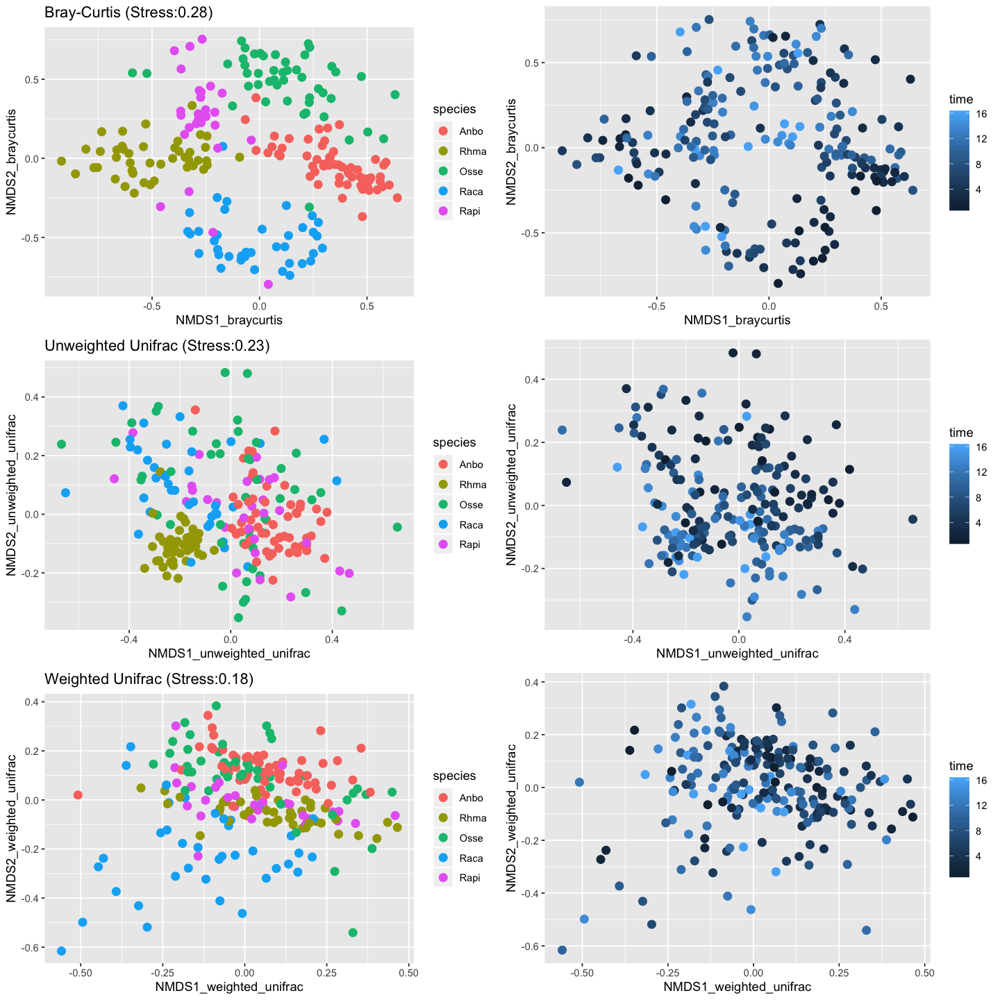

In [4]:
#### PLOTTING BETA COMPOSITION PLOTS ####
# What do different species look like? (Control only)
options(repr.plot.width=12, repr.plot.height=12)
gg_control_bc_sp <- mf_con %>%
    ggplot(aes(x=NMDS1_braycurtis, y=NMDS2_braycurtis)) +
    geom_point(aes(col=species), cex=3) +
    ggtitle(label = paste0("Bray-Curtis (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_braycurtis),0)/100),")"))

gg_control_uwu_sp <- mf_con %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac, y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(col=species), cex=3) +
    ggtitle(label = paste0("Unweighted Unifrac (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_unweighted_unifrac),0)/100),")"))

gg_control_wu_sp <- mf_con %>%
    ggplot(aes(x=NMDS1_weighted_unifrac, y=NMDS2_weighted_unifrac)) +
    geom_point(aes(col=species), cex=3) +
    ggtitle(label = paste0("Weighted Unifrac (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_weighted_unifrac),0)/100),")"))

gg_control_bc_time <- mf_con %>%
    ggplot(aes(x=NMDS1_braycurtis, y=NMDS2_braycurtis)) +
    geom_point(aes(col=time), cex=3)
gg_control_uwu_time <- mf_con %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac, y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(col=time), cex=3)
gg_control_wu_time <- mf_con %>%
    ggplot(aes(x=NMDS1_weighted_unifrac, y=NMDS2_weighted_unifrac)) +
    geom_point(aes(col=time), cex=3)

grid.arrange( gg_control_bc_sp,gg_control_bc_time
             , gg_control_uwu_sp,gg_control_uwu_time
             , gg_control_wu_sp,gg_control_wu_time 
            , nrow=3)


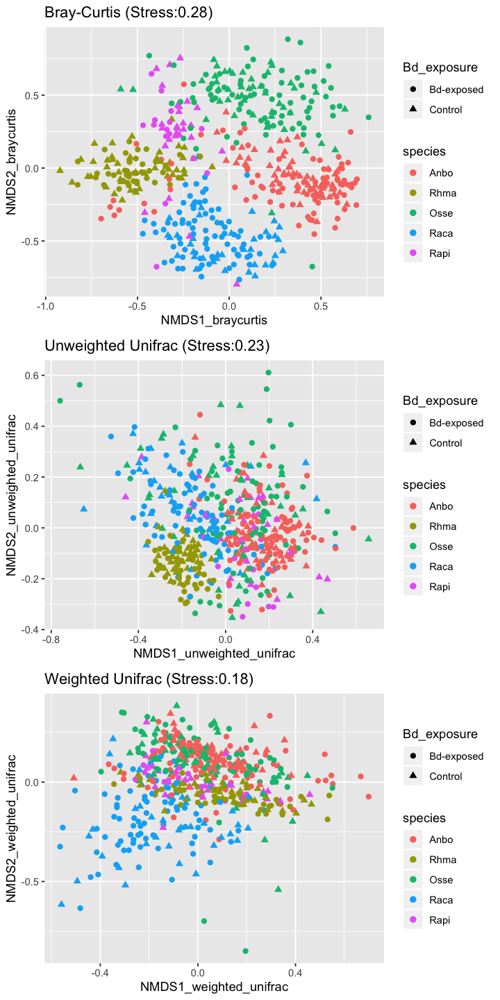

In [5]:
options(repr.plot.height=12, repr.plot.width=6) 
gg_all_bc <- mf_alt_filt_final %>%
    ggplot(aes(x=NMDS1_braycurtis, y=NMDS2_braycurtis)) +
    geom_point(aes(col=species,pch=Bd_exposure ), cex=2) +
    ggtitle(label = paste0("Bray-Curtis (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_braycurtis),0)/100),")"))
gg_all_uwu <- mf_alt_filt_final %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac, y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(col=species,pch=Bd_exposure ), cex=2) +
    ggtitle(label = paste0("Unweighted Unifrac (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_unweighted_unifrac),0)/100),")"))
gg_all_wu <- mf_alt_filt_final %>%
    ggplot(aes(x=NMDS1_weighted_unifrac, y=NMDS2_weighted_unifrac)) +
    geom_point(aes(col=species,pch=Bd_exposure ), cex=2) +
    ggtitle(label = paste0("Weighted Unifrac (Stress:",as.character(round(mean(mf_alt_filt_final$NMDS_stress_weighted_unifrac),0)/100),")"))
grid.arrange(gg_all_bc,gg_all_uwu, gg_all_wu
            , nrow=3)



In [6]:
# Check if marginal has an effect
adonis2(braycurtis_filt ~ species:time, data=mf_alt_filt_final, by="margin")
# Check main effects
adonis2(braycurtis_filt ~ species + time + species:time, data=mf_alt_filt_final)
# Include Bd_exposure
adonis2(braycurtis_filt ~ species*time*Bd_exposure, data=mf_alt_filt_final)

,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species:time,5,49.78383,0.2489781,33.74865,0.001
Residual,509,150.16880,0.7510219,NA,NA
Total,514,199.95263,1.0000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,53.601537,0.26807117,52.931861,0.001
time,1,8.576672,0.04289352,33.878076,0.001
species:time,4,9.927152,0.04964752,9.803127,0.001
Residual,505,127.847271,0.63938779,NA,NA
Total,514,199.952632,1.00000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,53.6015365,0.268071172,55.895270,0.001
time,1,8.5766724,0.042893521,35.774752,0.001
Bd_exposure,1,1.8811075,0.009407766,7.846418,0.001
species:time,4,9.8899481,0.049461455,10.313162,0.001
species:Bd_exposure,4,4.3440512,0.021725402,4.529943,0.001
time:Bd_exposure,1,0.8828279,0.004415185,3.682425,0.001
species:time:Bd_exposure,4,2.1047273,0.010526129,2.194793,0.001
Residual,495,118.6717614,0.593499370,NA,NA
Total,514,199.9526323,1.000000000,NA,NA


In [7]:
# Check if marginal has an effect
adonis2(unweighted_unifrac_filt ~ species:time, data=mf_alt_filt_final, by="margin")
# Check main effects
adonis2(unweighted_unifrac_filt ~ species + time + species:time, data=mf_alt_filt_final)
# Include Bd_exposure
adonis2(unweighted_unifrac_filt ~ species*time*Bd_exposure, data=mf_alt_filt_final)

,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species:time,5,20.26918,0.1663771,20.31757,0.001
Residual,509,101.55756,0.8336229,NA,NA
Total,514,121.82674,1.0000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,20.640009,0.16942100,28.067032,0.001
time,1,3.855803,0.03164989,20.973040,0.001
species:time,4,4.488869,0.03684633,6.104126,0.001
Residual,505,92.842062,0.76208278,NA,NA
Total,514,121.826743,1.00000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,20.6400092,0.169421005,29.080795,0.001
time,1,3.8558026,0.031649886,21.730573,0.001
Bd_exposure,1,0.7817910,0.006417237,4.406026,0.001
species:time,4,4.4846827,0.036811972,6.318705,0.001
species:Bd_exposure,4,2.4417899,0.020043135,3.440366,0.001
time:Bd_exposure,1,0.4393842,0.003606632,2.476286,0.001
species:time:Bd_exposure,4,1.3520827,0.011098407,1.905020,0.001
Residual,495,87.8312003,0.720951726,NA,NA
Total,514,121.8267426,1.000000000,NA,NA


In [8]:
# Check if marginal has an effect
adonis2(weighted_unifrac_filt ~ species:time, data=mf_alt_filt_final, by="margin")
# Check main effects
adonis2(weighted_unifrac_filt ~ species + time + species:time, data=mf_alt_filt_final)
# Include Bd_exposure
adonis2(weighted_unifrac_filt ~ species*time*Bd_exposure, data=mf_alt_filt_final)

,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species:time,5,12.15164,0.2420864,32.5161,0.001
Residual,509,38.04383,0.7579136,NA,NA
Total,514,50.19547,1.0000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,12.045046,0.23996282,45.300898,0.001
time,1,2.599064,0.05177887,39.099875,0.001
species:time,4,1.982771,0.03950100,7.457117,0.001
Residual,505,33.568584,0.66875731,NA,NA
Total,514,50.195465,1.00000000,NA,NA


,Df,SumOfSqs,R2,F,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
species,4,12.0450455,0.239962823,46.990393,0.001
time,1,2.5990642,0.051778865,40.558103,0.001
Bd_exposure,1,0.3280161,0.006534775,5.118654,0.001
species:time,4,1.9767162,0.039380375,7.711608,0.001
species:Bd_exposure,4,0.7725424,0.015390682,3.013859,0.001
time:Bd_exposure,1,0.1843190,0.003672025,2.876277,0.007
species:time:Bd_exposure,4,0.5689290,0.011334271,2.219518,0.001
Residual,495,31.7208326,0.631946184,NA,NA
Total,514,50.1954651,1.000000000,NA,NA


There is a significant effect of species AND time AND interaction on COMPOSITION


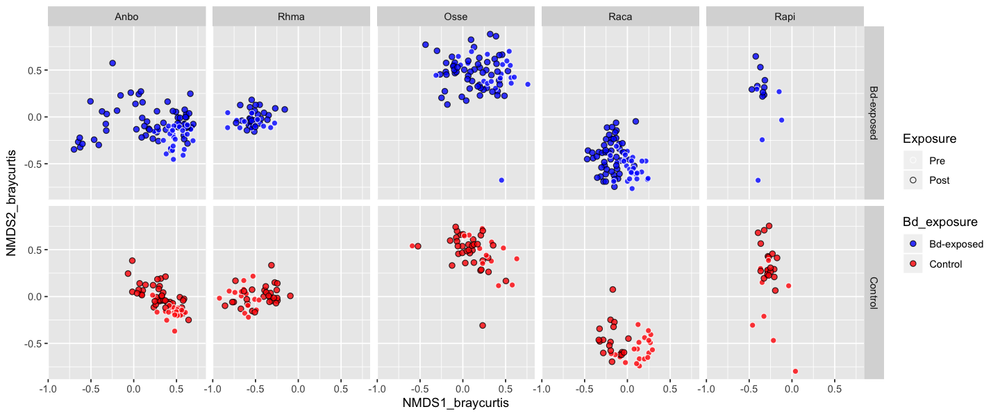

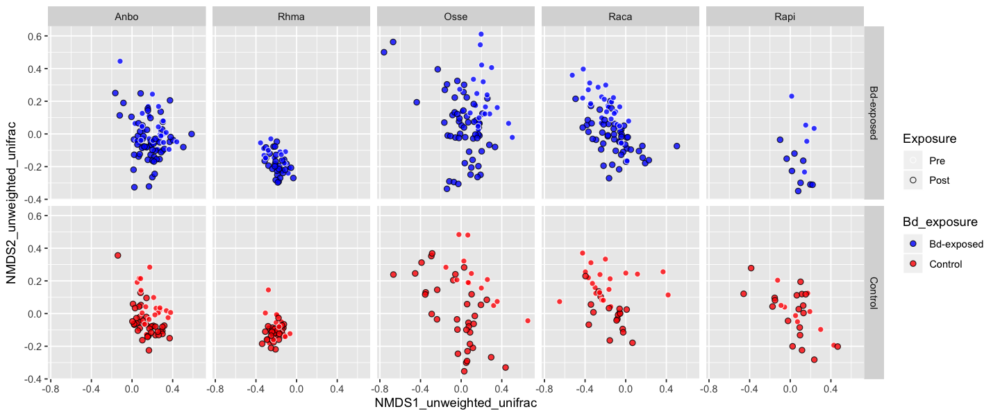

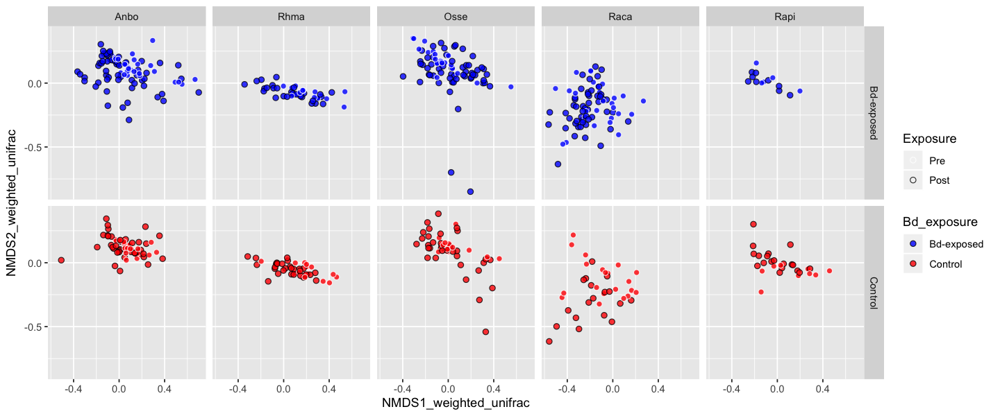

In [9]:
options(repr.plot.height=5, repr.plot.width=12)
# Bray curtis
mf_alt_filt_final %>%
    mutate(Exposure=factor(prepost, levels=c("Pre","Post"))) %>%
    ggplot(aes(x=NMDS1_braycurtis,y=NMDS2_braycurtis)) +
    geom_point(aes(bg=Bd_exposure, col=Exposure), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))
# Unweighted Unifrac
mf_alt_filt_final %>%
    mutate(Exposure=factor(prepost, levels=c("Pre","Post"))) %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac,y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(bg=Bd_exposure, col=Exposure), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))
# Weighted Unifrac
mf_alt_filt_final %>%
    mutate(Exposure=factor(prepost, levels=c("Pre","Post"))) %>%
    ggplot(aes(x=NMDS1_weighted_unifrac,y=NMDS2_weighted_unifrac)) +
    geom_point(aes(bg=Bd_exposure, col=Exposure), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))

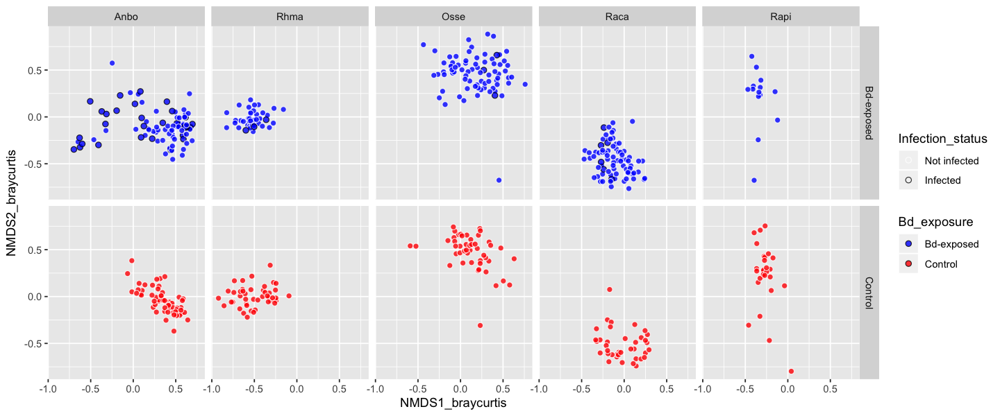

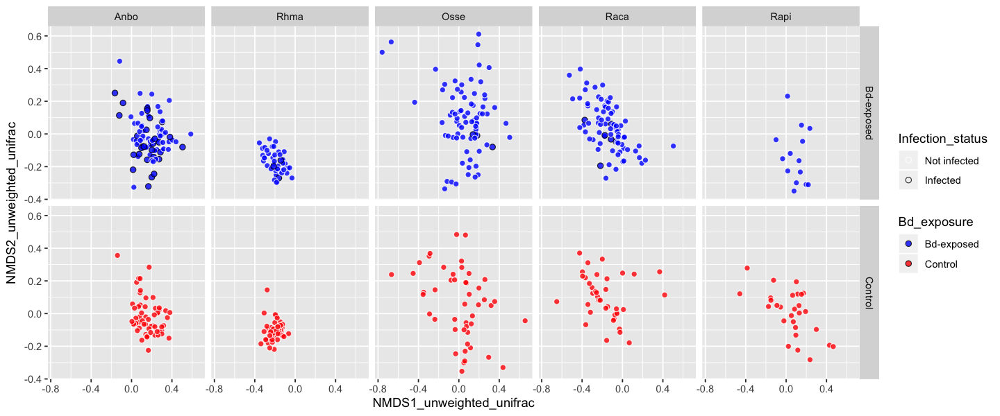

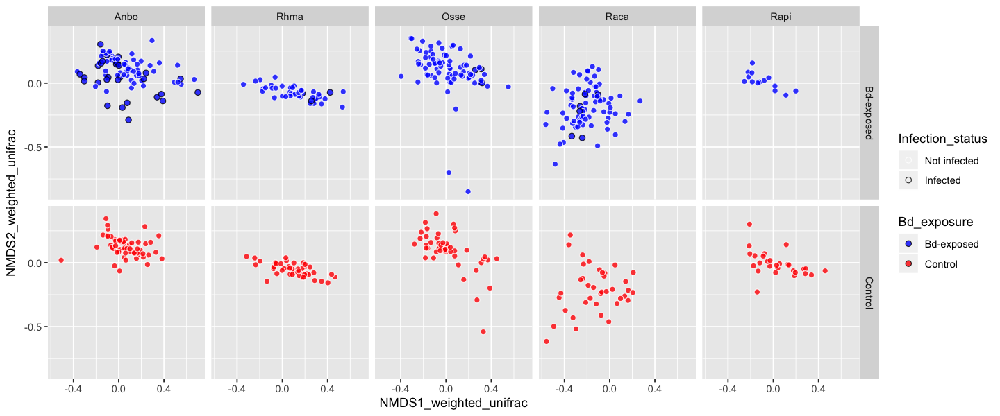

In [10]:
options(repr.plot.height=5, repr.plot.width=12)
# Bray curtis
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    ggplot(aes(x=NMDS1_braycurtis,y=NMDS2_braycurtis)) +
    geom_point(aes(bg=Bd_exposure, col=Infection_status), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))
# Unweighted Unifrac
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac,y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(bg=Bd_exposure, col=Infection_status), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))
# Weighted Unifrac
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    ggplot(aes(x=NMDS1_weighted_unifrac,y=NMDS2_weighted_unifrac)) +
    geom_point(aes(bg=Bd_exposure, col=Infection_status), cex=2, alpha=0.8, pch=21) +
    facet_grid(Bd_exposure ~ species) +
    scale_color_manual(values=c("white","black")) +
    scale_fill_manual(values=c("blue","red"))

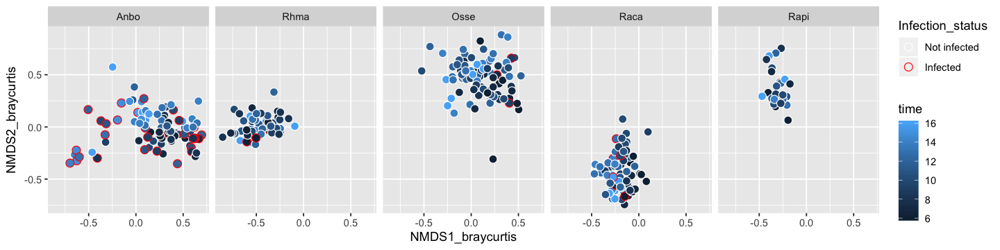

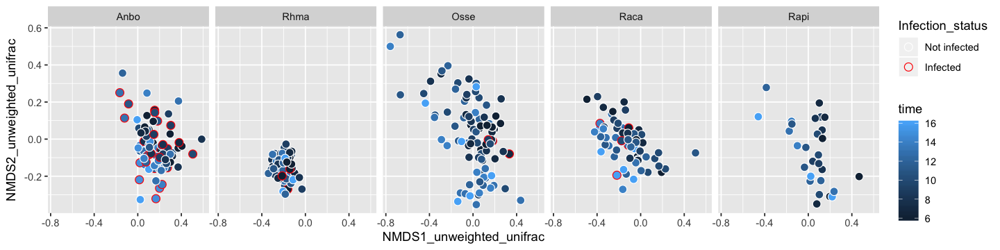

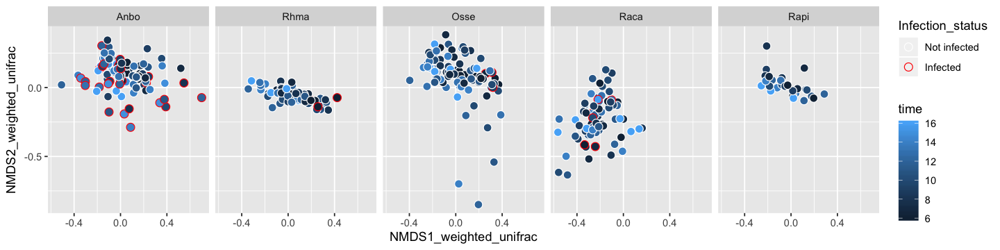

In [11]:
options(repr.plot.height=3, repr.plot.width=12)
# Bray curtis
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    filter(prepost=="Post") %>%
    ggplot(aes(x=NMDS1_braycurtis, y=NMDS2_braycurtis)) +
    geom_point(aes(bg=time, col=Infection_status), cex=3, pch=21) +
    scale_color_manual(values=c("white","red"))+
    facet_wrap(~species, nrow=1)
# Unweighted Unifrac
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    filter(prepost=="Post") %>%
    ggplot(aes(x=NMDS1_unweighted_unifrac, y=NMDS2_unweighted_unifrac)) +
    geom_point(aes(bg=time, col=Infection_status), cex=3, pch=21) +
    scale_color_manual(values=c("white","red"))+
    facet_wrap(~species, nrow=1)
# Weighted Unifrac
mf_alt_filt_final %>%
    mutate(Infection_status=factor(ifelse(PABD==0,"Not infected","Infected"), levels=c("Not infected","Infected"))) %>%
    filter(prepost=="Post") %>%
    ggplot(aes(x=NMDS1_weighted_unifrac, y=NMDS2_weighted_unifrac)) +
    geom_point(aes(bg=time, col=Infection_status), cex=3, pch=21) +
    scale_color_manual(values=c("white","red"))+
    facet_wrap(~species, nrow=1)


## Alpha Diversity visualization


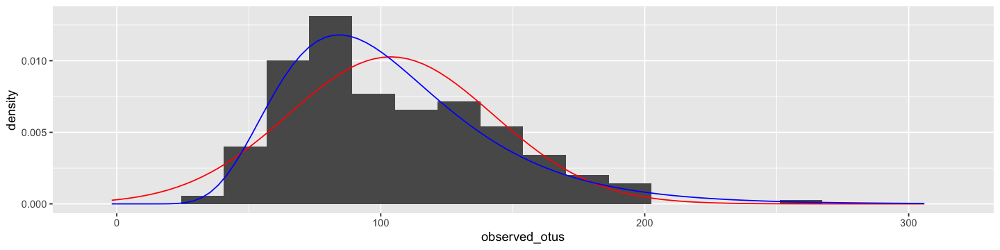

In [12]:
# Fit normal and lognormal distributions to each of the alpha diversity values

# Observed OTUs
    x.fit.norm <- seq(min(mf_con$observed_otus)-sd(mf_con$observed_otus)
                     , max(mf_con$observed_otus)+sd(mf_con$observed_otus)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$observed_otus, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$observed_otus, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    
    ggplot(data=mf_con, aes(x=observed_otus)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue")

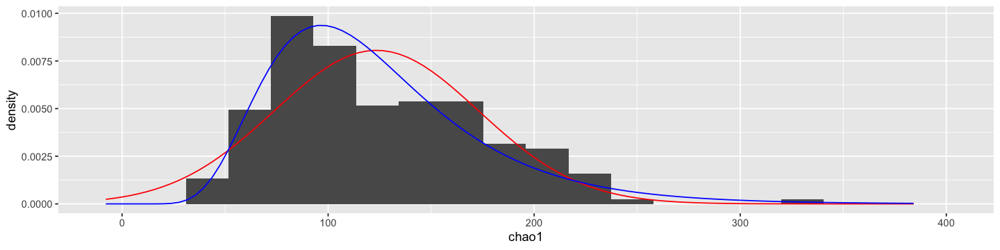

In [13]:
# Chao1
    x.fit.norm <- seq(min(mf_con$chao1)-sd(mf_con$chao1)
                     , max(mf_con$chao1)+sd(mf_con$chao1)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$chao1, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$chao1, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    
    ggplot(data=mf_con, aes(x=chao1)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue")

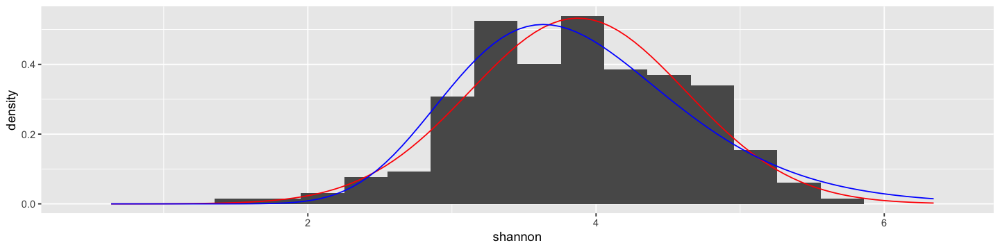

In [14]:
# Shannon
    x.fit.norm <- seq(min(mf_con$shannon)-sd(mf_con$shannon)
                     , max(mf_con$shannon)+sd(mf_con$shannon)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$shannon, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$shannon, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    
    ggplot(data=mf_con, aes(x=shannon)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue")

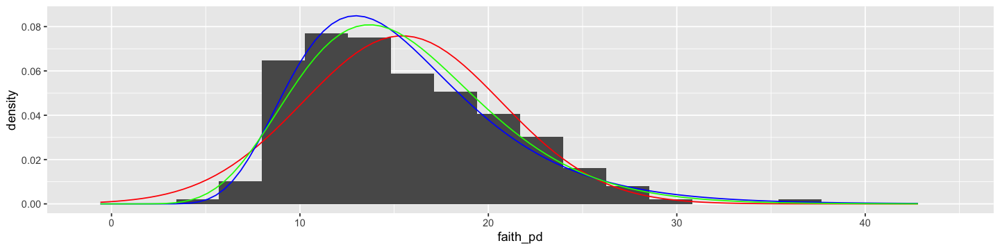

In [15]:
# Faith's PD
    x.fit.norm <- seq(min(mf_con$faith_pd)-sd(mf_con$faith_pd)
                     , max(mf_con$faith_pd)+sd(mf_con$faith_pd)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$faith_pd, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$faith_pd, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma distribution
    param.gamma <- fitdistr(mf_con$faith_pd, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    
    ggplot(data=mf_con, aes(x=faith_pd)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green")

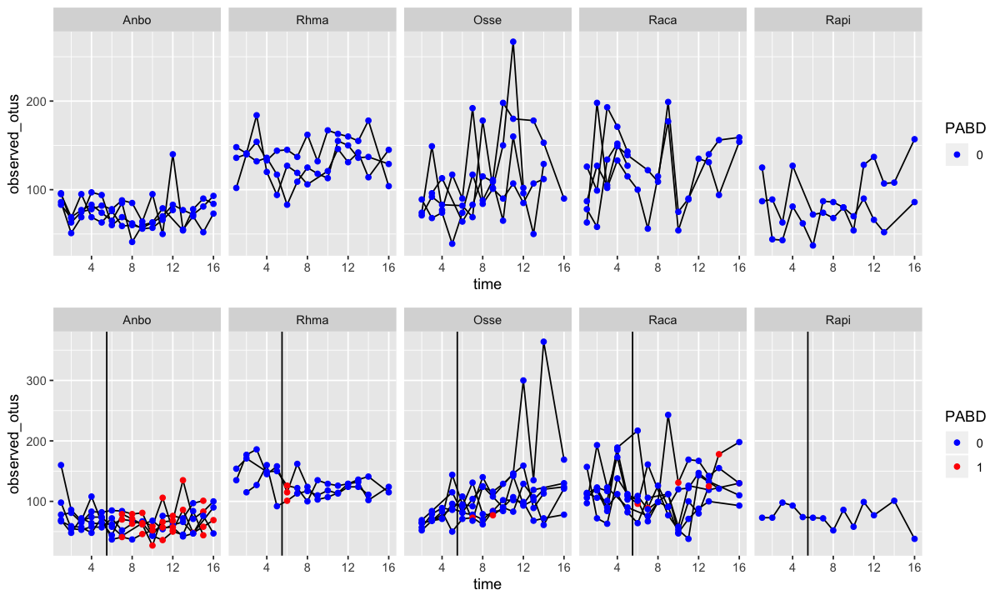

In [16]:
# Check to see if turnover is changing with time significantly
options(repr.plot.height=6, repr.plot.width=10)
gg_divtime_con <- mf_con %>%
    filter(!is.na(observed_otus)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=observed_otus)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_divtime_treat <- mf_treat %>%
    filter(!is.na(observed_otus)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=observed_otus)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5)) +
    facet_grid(~species)
grid.arrange(gg_divtime_con, gg_divtime_treat, nrow=2)


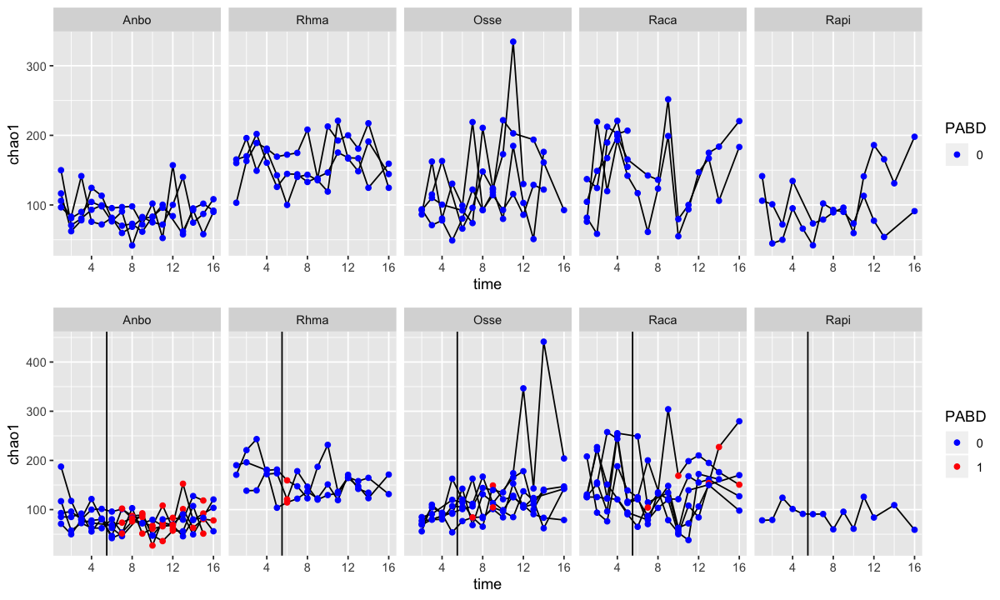

In [17]:
# Check to see if turnover is changing with time significantly
options(repr.plot.height=6, repr.plot.width=10)
gg_divtime_con <- mf_con %>%
    filter(!is.na(chao1)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=chao1)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_divtime_treat <- mf_treat %>%
    filter(!is.na(chao1)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=chao1)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5)) +
    facet_grid(~species)
grid.arrange(gg_divtime_con, gg_divtime_treat, nrow=2)


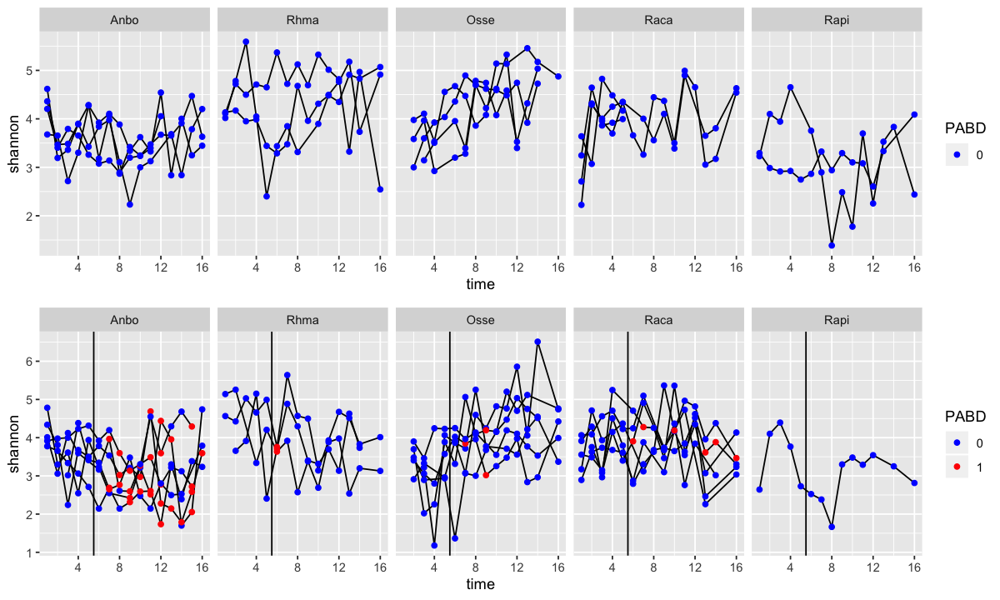

In [18]:
# Check to see if turnover is changing with time significantly
options(repr.plot.height=6, repr.plot.width=10)
gg_divtime_con <- mf_con %>%
    filter(!is.na(shannon)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=shannon)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_divtime_treat <- mf_treat %>%
    filter(!is.na(shannon)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=shannon)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5)) +
    facet_grid(~species)
grid.arrange(gg_divtime_con, gg_divtime_treat, nrow=2)


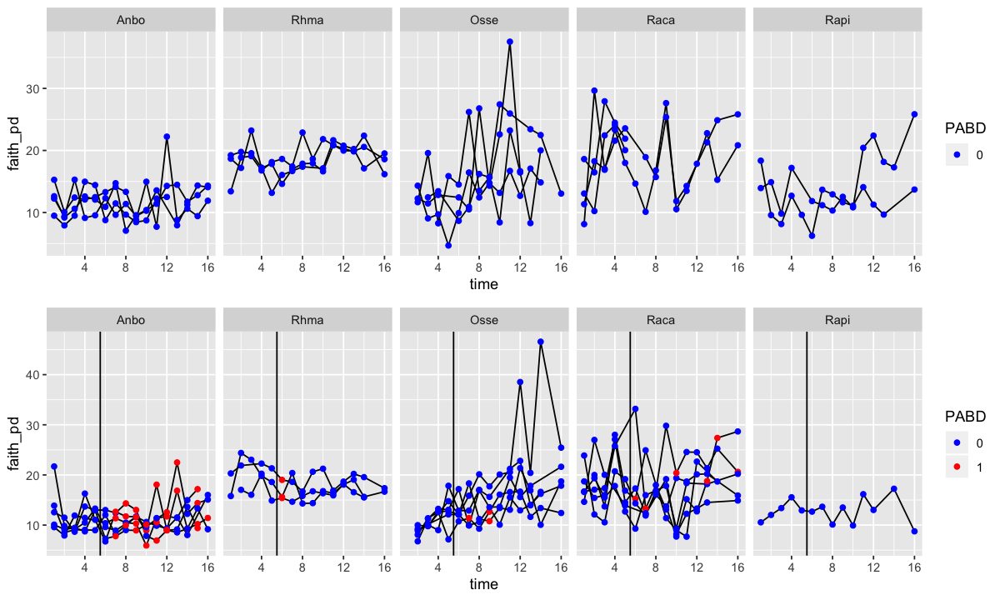

In [19]:
# Check to see if turnover is changing with time significantly
options(repr.plot.height=6, repr.plot.width=10)
gg_divtime_con <- mf_con %>%
    filter(!is.na(faith_pd)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=faith_pd)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_divtime_treat <- mf_treat %>%
    filter(!is.na(faith_pd)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=faith_pd)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5)) +
    facet_grid(~species)
grid.arrange(gg_divtime_con, gg_divtime_treat, nrow=2)


To determine whether diversity is changing with species, time, and Bd_exposure group, I first do a type I (sequential) ANOVA to test if interactions are significant. If interactions are NOT significant, then you can actually re-run the ANOVA without that interaction to test for other effects (Type II ANOVA; no interaction assumed). However, since we have multiple interacting factors, we should assess them one at a time by using a type III (marginal) ANOVA so that we test species:Bd_exposure while accounting for (species, time, Bd_exposure, time:Bd_exposure, species:time).

In [20]:
# Make a function to calculate this so we don't have to type it out every time
anova_log_lm_3way <- function(mf, dep, indep1, indep2, indep3) {
    # change names in mapping file
    temp_mf <- mf_alt_filt_final %>%
    rename(indep1=(indep1), indep2=(indep2), indep3=(indep3), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2, indep3)
    
    inter_3way <- anova(lm(log(dep) ~ indep1*indep2*indep3, data=temp_mf)) # First do a sequential test
    inter_3way_sig <- inter_3way$`Pr(>F)`[7] < 0.05
    if ( inter_3way_sig ) { # if indep1:time:Bd_exposure IS significant, we should do an ANOVA III to test all 2-way effects
        # Test each 2-way interaction
        inter_2way <- Anova(lm(log(dep) ~ indep1*indep2*indep3, data=temp_mf), type=3) 
        indep1_indep2_sig <- (inter_2way$`Pr(>F)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>F)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>F)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*Bd_exposure-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*Bd_exposure-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2, data=temp_mf), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2-species:indep3, data=temp_mf), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        }


    } else { # if there is NO 3-way significant interaction

        # Test each 2-way interaction
        inter_2way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf), type=3)
        indep1_indep2_sig <- (inter_2way$`Pr(>F)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>F)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>F)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2, data=temp_mf), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(lm(log(dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(lm(log(dep) ~ indep1+indep2+indep3, data=temp_mf), type=3)
                }
            }
        }
    }
    
    ## Now, spit out results
    print("3-way interaction")
    print(paste0(indep1,":", indep2,":", indep3, " p = ",inter_3way$`Pr(>F)`[7], ", F(",inter_3way$Df[7],",",inter_3way$Df[length(inter_3way$Df)],") = ",inter_3way$`F value`[7]))
    
    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>F)`[5], ", F(",inter_2way$Df[5],",",inter_2way$Df[length(inter_2way$Df)],") = ",inter_2way$`F value`[5]))
    print(paste0(indep1,":", indep3, " p = ",inter_2way$`Pr(>F)`[6], ", F(",inter_2way$Df[6],",",inter_2way$Df[length(inter_2way$Df)],") = ",inter_2way$`F value`[6]))
    print(paste0(indep2,":", indep3, " p = ",inter_2way$`Pr(>F)`[7], ", F(",inter_2way$Df[7],",",inter_2way$Df[length(inter_2way$Df)],") = ",inter_2way$`F value`[7]))
    
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>F)`[2], ", F(",main_1way$Df[2],",",inter_3way$Df[length(inter_3way$Df)],") = ",main_1way$`F value`[2]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>F)`[3], ", F(",main_1way$Df[3],",",inter_3way$Df[length(inter_3way$Df)],") = ",main_1way$`F value`[3]))
    print(paste0(indep3, " p = ",main_1way$`Pr(>F)`[4], ", F(",main_1way$Df[4],",",inter_3way$Df[length(inter_3way$Df)],") = ",main_1way$`F value`[4]))

    return(list(inter_3way, inter_2way, main_1way))

}

In [21]:
# Loop through all alpha diversity metrics
for ( a in alpha_metrics ) {
    print("-------------")
    print(a)
    assign(paste0("anova_",a), anova_log_lm_3way(mf=mf_alt_filt_final, dep=paste0(a), indep1="species", indep2="time", indep3="Bd_exposure"))
}


[1] "-------------"
[1] "observed_otus"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.281586333560066, F(4,495) = 1.26794091530175"
[1] "2-way interaction"
[1] "species:time p = 1.39010637776659e-06, F(4,499) = 8.42565261946424"
[1] "species:Bd_exposure p = 0.925624301434885, F(4,499) = 0.222895696278359"
[1] "time:Bd_exposure p = 0.241741735268746, F(1,499) = 1.37366916620789"
[1] "1-way main interactions"
[1] "species p = 5.88947659698197e-18, F(4,495) = 23.6707936679131"
[1] "time p = 0.336981331871965, F(1,495) = 0.923642088611239"
[1] "Bd_exposure p = 0.002055338808181, F(1,495) = 9.59912806734385"
[1] "-------------"
[1] "chao1"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.448150013097119, F(4,495) = 0.926548227683268"
[1] "2-way interaction"
[1] "species:time p = 6.23910894743295e-05, F(4,499) = 6.2741720138224"
[1] "species:Bd_exposure p = 0.884493187885575, F(4,499) = 0.289981865686314"
[1] "time:Bd_exposure p = 0.376248405627729, F(1,499) = 0.7843

In [22]:
# Or do manual comparisons of control and Bd_exposure
# Make a function to calculate this so we don't have to type it out every time
anova_log_lm_2way <- function(mf, dep, indep1, indep2) {
    # change names in mapping file
    temp_mf <- mf %>%
    rename(indep1=(indep1), indep2=(indep2), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2)
    
    inter_2way <- anova(lm(log(dep) ~ indep1*indep2, data=temp_mf)) 
    inter_2way_sig <- inter_2way$`Pr(>F)`[3] < 0.05
    if ( inter_2way_sig ) {
        main_1way <- Anova(lm(log(dep) ~ indep1*indep2, data=temp_mf), type=3)
    } else {
        main_1way <- Anova(lm(log(dep) ~ indep1+indep2, data=temp_mf), type=3)
    }

    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>F)`[3], ", F(",inter_2way$Df[3],",",inter_2way$Df[length(inter_2way$Df)],") = ",inter_2way$`F value`[3]))
     
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>F)`[2], ", F(",main_1way$Df[2],",",main_1way$Df[length(main_1way$Df)],") = ",main_1way$`F value`[2]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>F)`[3], ", F(",main_1way$Df[3],",",main_1way$Df[length(main_1way$Df)],") = ",main_1way$`F value`[3]))

    return(list(inter_2way, main_1way))

}

In [23]:
# separated controls and Bd_exposures
for ( a in alpha_metrics ) {
    print("-------")
    print(a)
    print("CONTROL")
    assign(paste0("anova_", a, "con"), anova_log_lm_2way(mf=mf_con, dep = paste0(a), indep1="species", indep2="time"))
    print("Bd_exposure")
    assign(paste0("anova_", a, "treat"), anova_log_lm_2way(mf=mf_treat, dep = paste0(a), indep1="species", indep2="time"))
}



[1] "-------"
[1] "observed_otus"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.0632314548581625, F(4,206) = 2.26678754684032"
[1] "1-way main interactions"
[1] "species p = 7.89810393153774e-23, F(4,210) = 35.8638748376736"
[1] "time p = 0.0245543160060272, F(1,210) = 5.12869896303142"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 1.25763508404044e-05, F(4,289) = 7.31913638167554"
[1] "1-way main interactions"
[1] "species p = 2.11007114225772e-11, F(4,289) = 15.358968133514"
[1] "time p = 0.416667885543009, F(1,289) = 0.661592533639563"
[1] "-------"
[1] "chao1"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.0761962978211546, F(4,206) = 2.14771231845094"
[1] "1-way main interactions"
[1] "species p = 1.52854167670683e-19, F(4,210) = 29.6290722527069"
[1] "time p = 0.0743241802795942, F(1,210) = 3.216813435654"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.000649338599978664, F(4,289) = 5.00449606975323"
[1] "1-way m

## Beta dispersion visualization


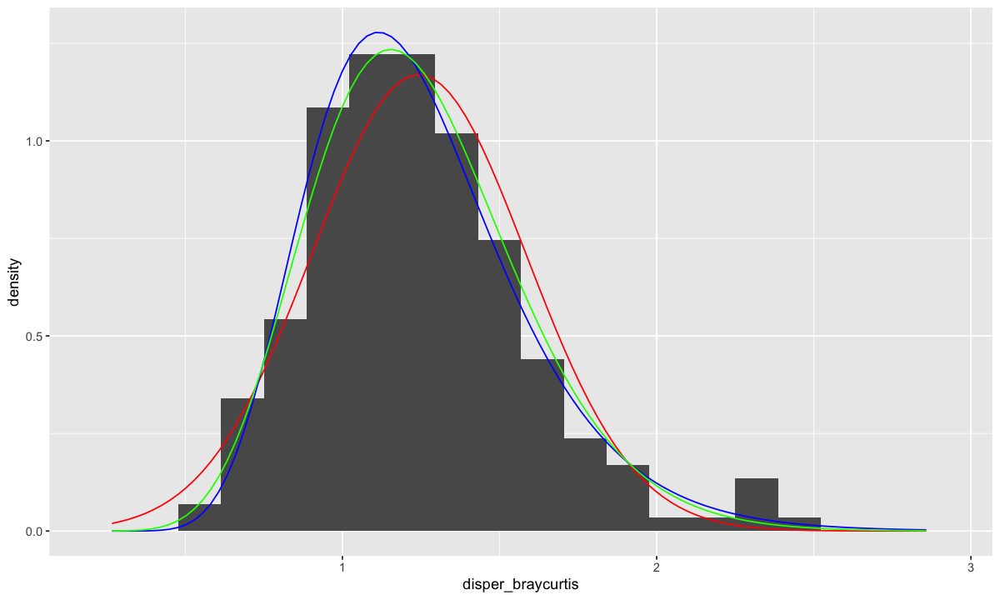

In [24]:
#### Dispersion ####
# Bray-curtis
    x.fit.norm <- seq(min(mf_con$disper_braycurtis)-sd(mf_con$disper_braycurtis)
                     , max(mf_con$disper_braycurtis)+sd(mf_con$disper_braycurtis)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$disper_braycurtis, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$disper_braycurtis, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(mf_con$disper_braycurtis, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    
    ggplot(data=mf_con, aes(x=disper_braycurtis)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green")

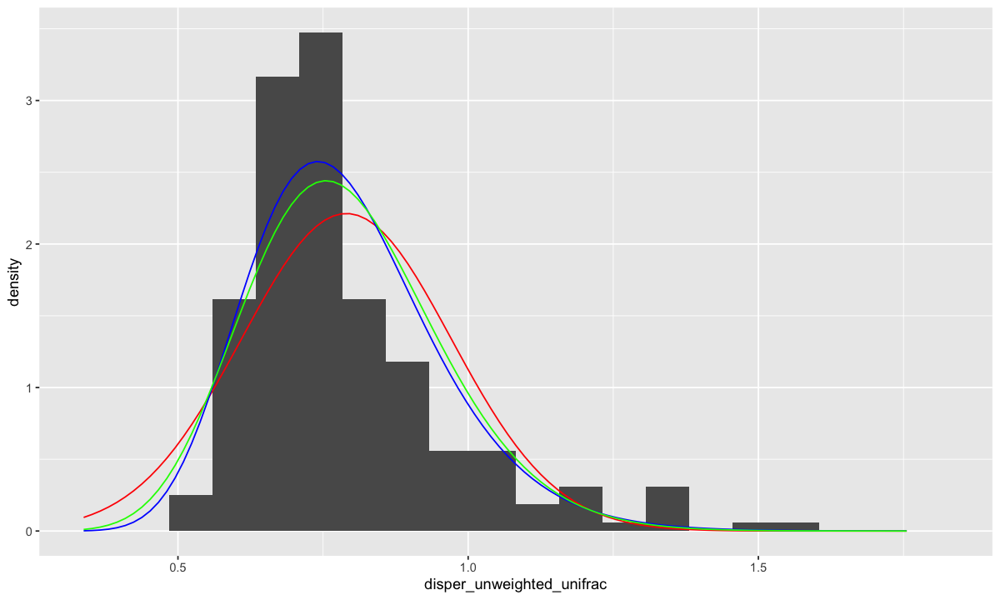

In [25]:
# Unweighted Unifrac
    x.fit.norm <- seq(min(mf_con$disper_unweighted_unifrac)-sd(mf_con$disper_unweighted_unifrac)
                     , max(mf_con$disper_unweighted_unifrac)+sd(mf_con$disper_unweighted_unifrac)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$disper_unweighted_unifrac, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$disper_unweighted_unifrac, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(mf_con$disper_unweighted_unifrac, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    
    ggplot(data=mf_con, aes(x=disper_unweighted_unifrac)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green")

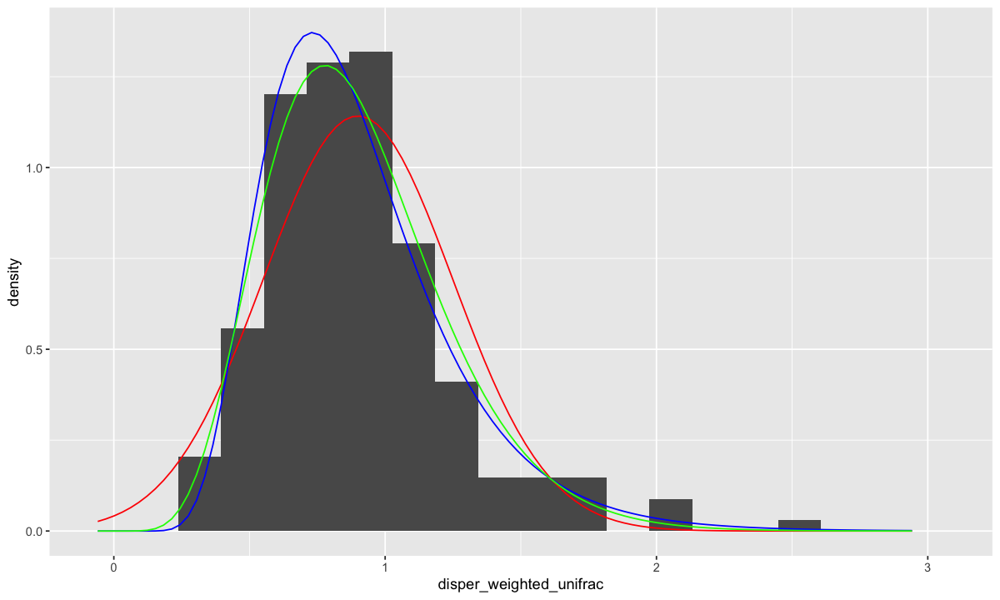

In [26]:
# Weighted Unifrac
    x.fit.norm <- seq(min(mf_con$disper_weighted_unifrac)-sd(mf_con$disper_weighted_unifrac)
                     , max(mf_con$disper_weighted_unifrac)+sd(mf_con$disper_weighted_unifrac)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$disper_weighted_unifrac, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$disper_weighted_unifrac, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(mf_con$disper_weighted_unifrac, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    
    ggplot(data=mf_con, aes(x=disper_weighted_unifrac)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green")

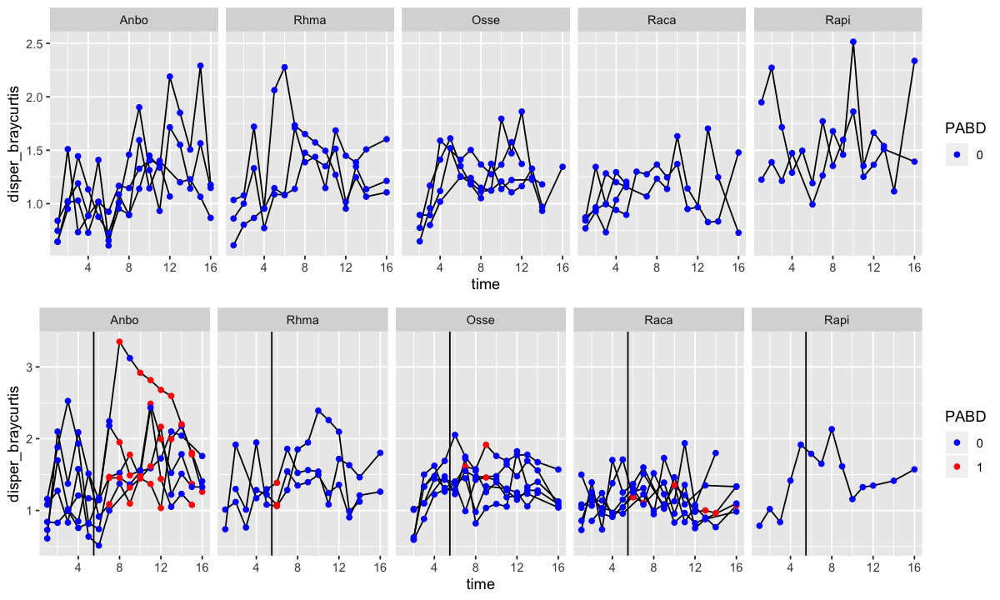

In [27]:
## Braycurtis
# Check to see if turnover is changing with time significantly
gg_dispertime_con <- mf_con %>%
    filter(!is.na(disper_braycurtis)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_braycurtis)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_dispertime_treat <- mf_treat %>%
    filter(!is.na(disper_braycurtis)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_braycurtis)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_dispertime_con, gg_dispertime_treat, nrow=2)



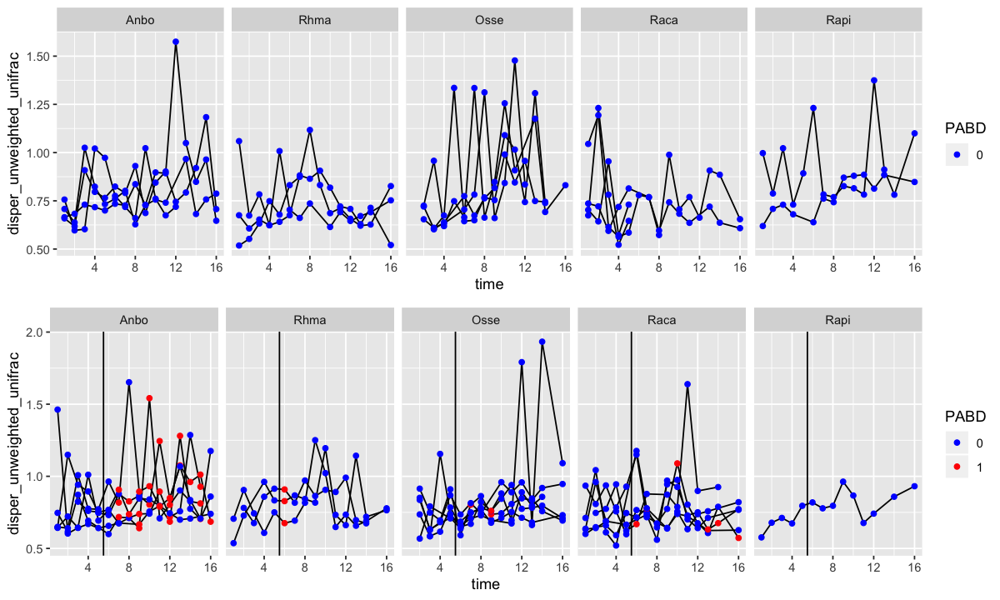

In [28]:
## Unweighted Unifrac
# Check to see if turnover is changing with time significantly
gg_dispertime_con <- mf_con %>%
    filter(!is.na(disper_unweighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_unweighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_dispertime_treat <- mf_treat %>%
    filter(!is.na(disper_unweighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_unweighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_dispertime_con, gg_dispertime_treat, nrow=2)


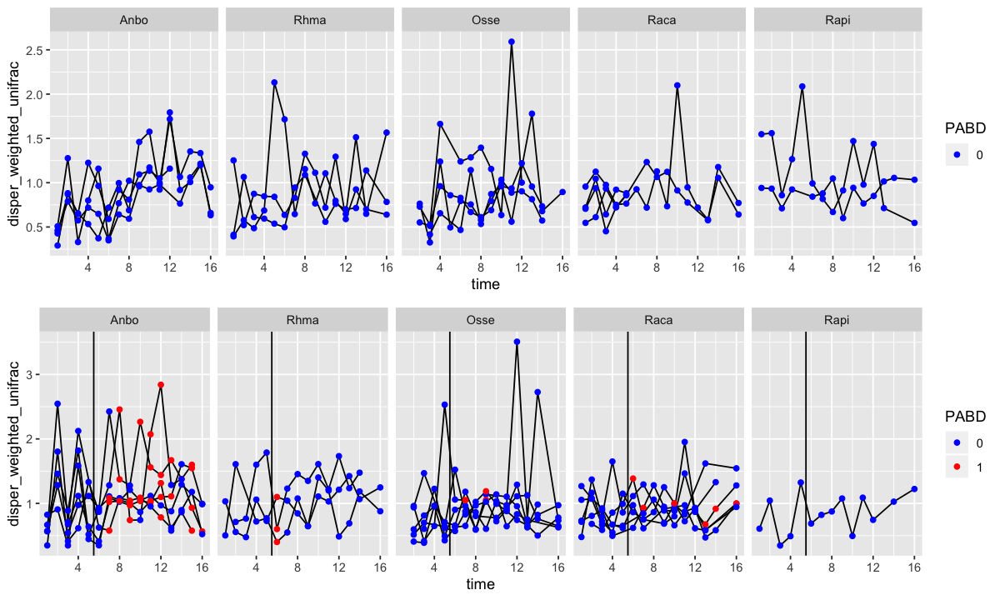

In [29]:
## Weighted Unifrac
# Check to see if turnover is changing with time significantly
gg_dispertime_con <- mf_con %>%
    filter(!is.na(disper_weighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_weighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_dispertime_treat <- mf_treat %>%
    filter(!is.na(disper_weighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=disper_weighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_dispertime_con, gg_dispertime_treat, nrow=2)


 Now, we can run an ANOVA like we did with alpha diversity--

In [30]:
for ( b in beta_metrics ) {
    print("--------")
    print(b)
    assign(paste0("anova_disper_",b), anova_log_lm_3way(mf=mf_alt_filt_final, dep = paste0("disper_",b), indep1="species", indep2="time", indep3="Bd_exposure"))
}


[1] "--------"
[1] "braycurtis"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.630085983403839, F(4,495) = 0.645779878589656"
[1] "2-way interaction"
[1] "species:time p = 0.00061040058581474, F(4,499) = 4.97645554861041"
[1] "species:Bd_exposure p = 0.00546418986218119, F(4,499) = 3.7114966033594"
[1] "time:Bd_exposure p = 0.653052709497064, F(1,499) = 0.202316635538872"
[1] "1-way main interactions"
[1] "species p = 0.51624589409124, F(4,495) = 0.814532886716958"
[1] "time p = 1.01307946358475e-12, F(1,495) = 53.546725992438"
[1] "Bd_exposure p = 4.17370966378774e-07, F(1,495) = 26.3064904874292"
[1] "--------"
[1] "unweighted_unifrac"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.696004962132921, F(4,495) = 0.554253224648829"
[1] "2-way interaction"
[1] "species:time p = 0.00201544419101792, F(4,499) = 4.29034421859866"
[1] "species:Bd_exposure p = 0.0136780837044633, F(4,499) = 3.17170563148351"
[1] "time:Bd_exposure p = 0.869598017747192, F(1,499) = 0.02

In [31]:
# Manual for weighted unifrac
Anova(lm(log(disper_weighted_unifrac) ~ species*time*Bd_exposure, data = mf_alt_filt_final), type=3)

,Sum Sq,Df,F value,Pr(>F)
,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),0.7374543,1,5.3391049,0.021262351
species,0.4572924,4,0.8276892,0.507920462
time,0.8098590,1,5.8633090,0.015818157
Bd_exposure,1.2530210,1,9.0717631,0.002728648
species:time,0.3484022,4,0.6306005,0.640866468
species:Bd_exposure,1.9809027,4,3.5853907,0.006783086
time:Bd_exposure,0.5529700,1,4.0034549,0.045952652
species:time:Bd_exposure,1.2161813,4,2.2012618,0.067792474
Residuals,68.3709877,495,NA,NA


In [32]:
for ( b in beta_metrics ) {
    print("-------")
    print(b)
    print("CONTROL")
    assign(paste0("anova_disper_",b,"_con"),anova_log_lm_2way(mf=mf_con, dep = paste0("disper_",b), indep1="species", indep2="time"))
    print("Bd_exposure")
    assign(paste0("anova_disper_",b,"_treat"),anova_log_lm_2way(mf=mf_treat, dep = paste0("disper_",b), indep1="species", indep2="time"))

}


[1] "-------"
[1] "braycurtis"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.0719983796529365, F(4,206) = 2.18398948209259"
[1] "1-way main interactions"
[1] "species p = 1.13449473842694e-06, F(4,210) = 8.92031779463094"
[1] "time p = 7.23788719502915e-08, F(1,210) = 31.1762693787111"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.0101036470931872, F(4,289) = 3.37849289856146"
[1] "1-way main interactions"
[1] "species p = 0.882003676298468, F(4,289) = 0.293629658875859"
[1] "time p = 2.9371611793151e-07, F(1,289) = 27.573017331104"
[1] "-------"
[1] "unweighted_unifrac"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.0123981417057312, F(4,206) = 3.28009797529143"
[1] "1-way main interactions"
[1] "species p = 0.600602692904124, F(4,206) = 0.688597813546892"
[1] "time p = 0.0244481935551682, F(1,206) = 5.13785653604999"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.182866618258819, F(4,289) = 1.56802389453821"
[1] "1

## Beta distance visualization

Warning message:
“Removed 33 rows containing non-finite values (stat_bin).”

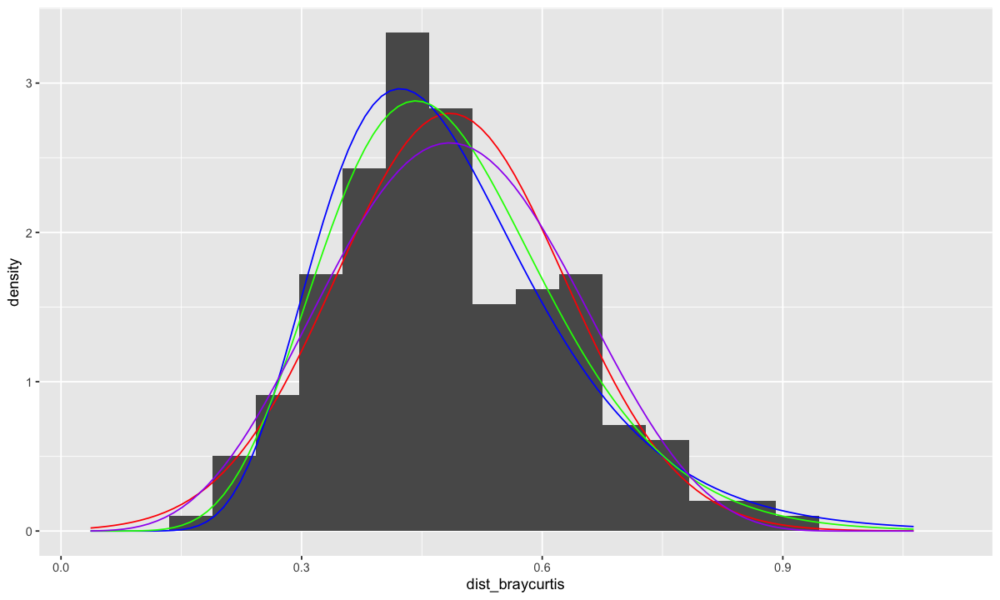

In [33]:
# Bray-curtis
    # eliminate NAs
    beta_values <- mf_con$dist_braycurtis[!is.na(mf_con$dist_braycurtis)]
    x.fit.norm <- seq(min(beta_values)-sd(beta_values)
                     , max(beta_values)+sd(beta_values)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(beta_values, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(beta_values, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(beta_values, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    # Fit a beta
    param.beta <- fitdistr(beta_values, densfun="beta", start=list(shape1=6,shape2=6))
    y.pred.beta <- dbeta(x.fit.norm, shape1=param.beta$estimate[1], shape2 = param.beta$estimate[2])
    
    
    ggplot(data=mf_con, aes(x=dist_braycurtis)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.beta), aes(x=x, y=y), col="purple") 

Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message:
“Removed 33 rows containing non-finite values (stat_bin).”

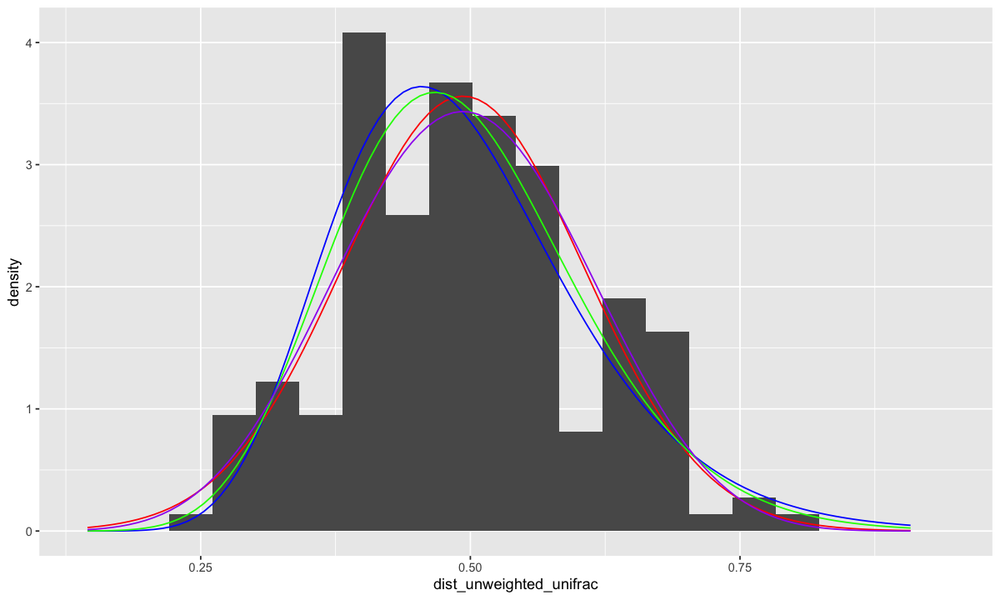

In [34]:
# Unweighted Unifrac
    # eliminate NAs
    beta_values <- mf_con$dist_unweighted_unifrac[!is.na(mf_con$dist_unweighted_unifrac)]
    x.fit.norm <- seq(min(beta_values)-sd(beta_values)
                     , max(beta_values)+sd(beta_values)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(beta_values, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(beta_values, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(beta_values, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    # Fit a beta
    param.beta <- fitdistr(beta_values, densfun="beta", start=list(shape1=6,shape2=6))
    y.pred.beta <- dbeta(x.fit.norm, shape1=param.beta$estimate[1], shape2 = param.beta$estimate[2])
    
    ggplot(data=mf_con, aes(x=dist_unweighted_unifrac)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.beta), aes(x=x, y=y), col="purple")

Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message:
“Removed 33 rows containing non-finite values (stat_bin).”

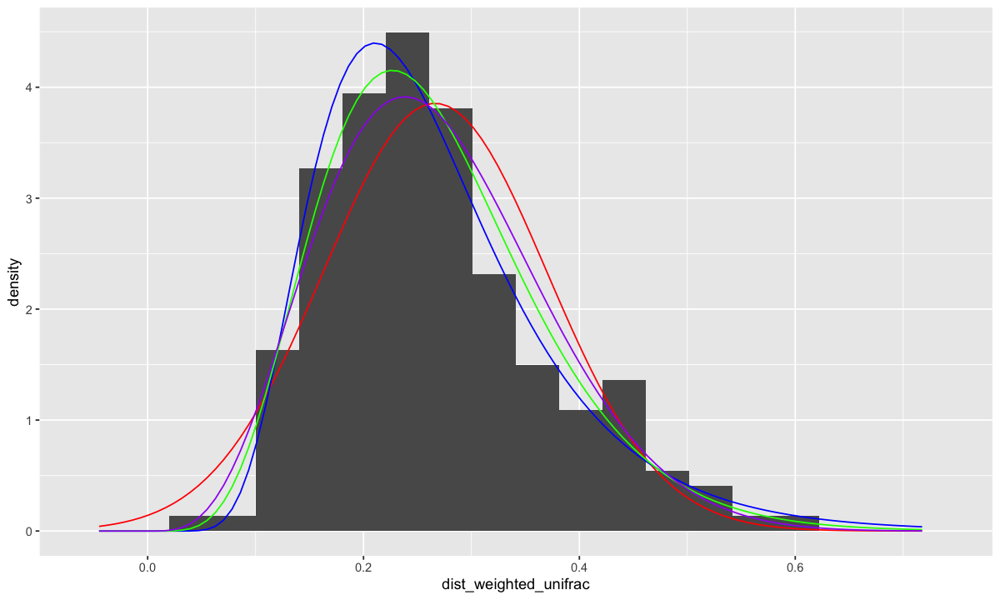

In [35]:
# Weighted Unifrac
    # eliminate NAs
    beta_values <- mf_con$dist_weighted_unifrac[!is.na(mf_con$dist_weighted_unifrac)]
    x.fit.norm <- seq(min(beta_values)-sd(beta_values)
                     , max(beta_values)+sd(beta_values)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(beta_values, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(beta_values, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(beta_values, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    # Fit a beta
    param.beta <- fitdistr(beta_values, densfun="beta", start=list(shape1=6,shape2=6))
    y.pred.beta <- dbeta(x.fit.norm, shape1=param.beta$estimate[1], shape2 = param.beta$estimate[2])

    
    ggplot(data=mf_con, aes(x=dist_weighted_unifrac)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green") + 
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.beta), aes(x=x, y=y), col="purple")

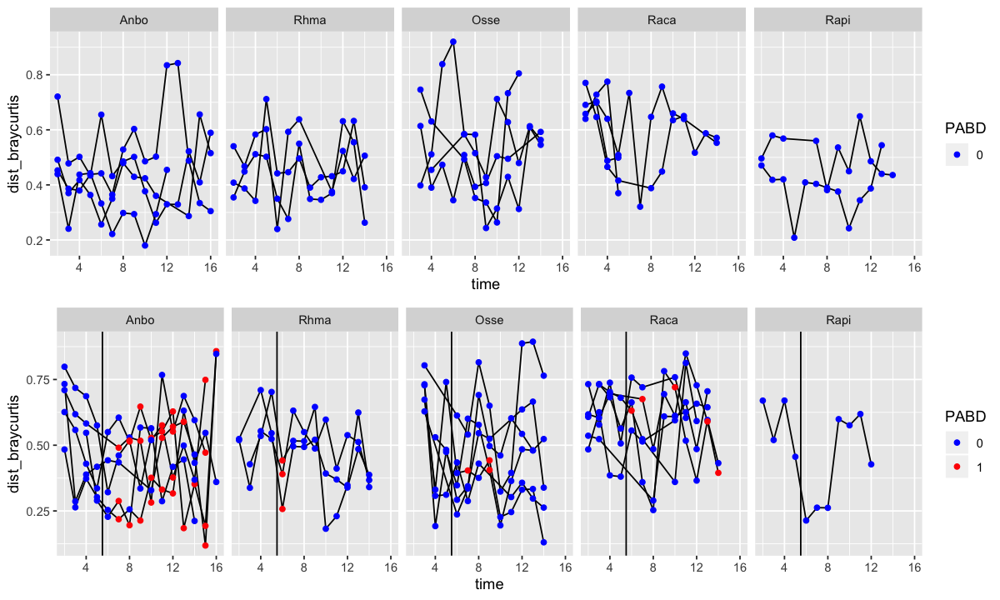

In [36]:
## Braycurtis
# Check to see if turnover is changing with time significantly
gg_disttime_con <- mf_con %>%
    filter(!is.na(dist_braycurtis)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_braycurtis)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_disttime_treat <- mf_treat %>%
    filter(!is.na(dist_braycurtis)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_braycurtis)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_disttime_con, gg_disttime_treat, nrow=2)

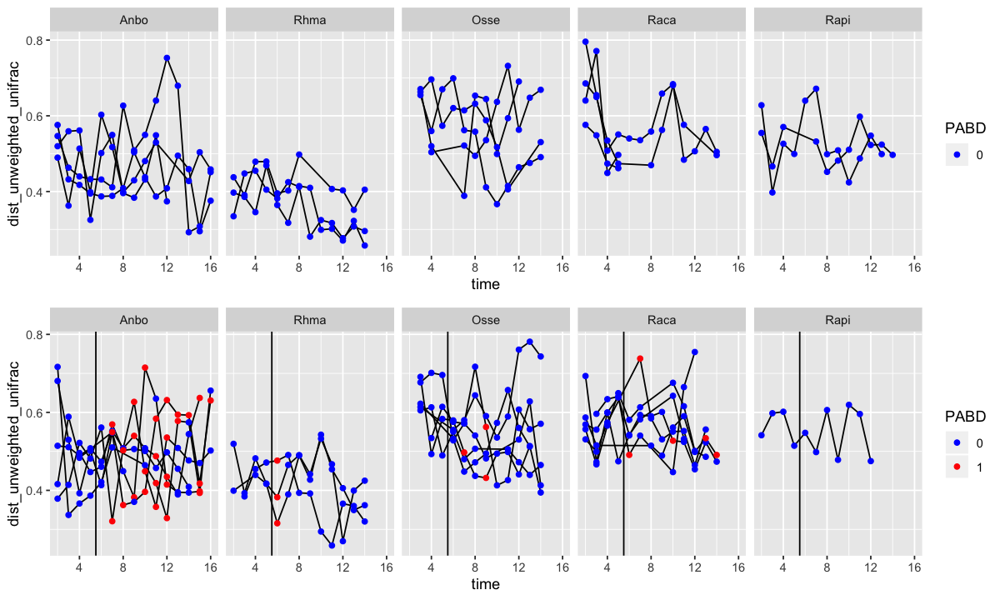

In [37]:
## Unweighted Unifrac
# Check to see if turnover is changing with time significantly
gg_disttime_con <- mf_con %>%
    filter(!is.na(dist_unweighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_unweighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_disttime_treat <- mf_treat %>%
    filter(!is.na(dist_unweighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_unweighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_disttime_con, gg_disttime_treat, nrow=2)

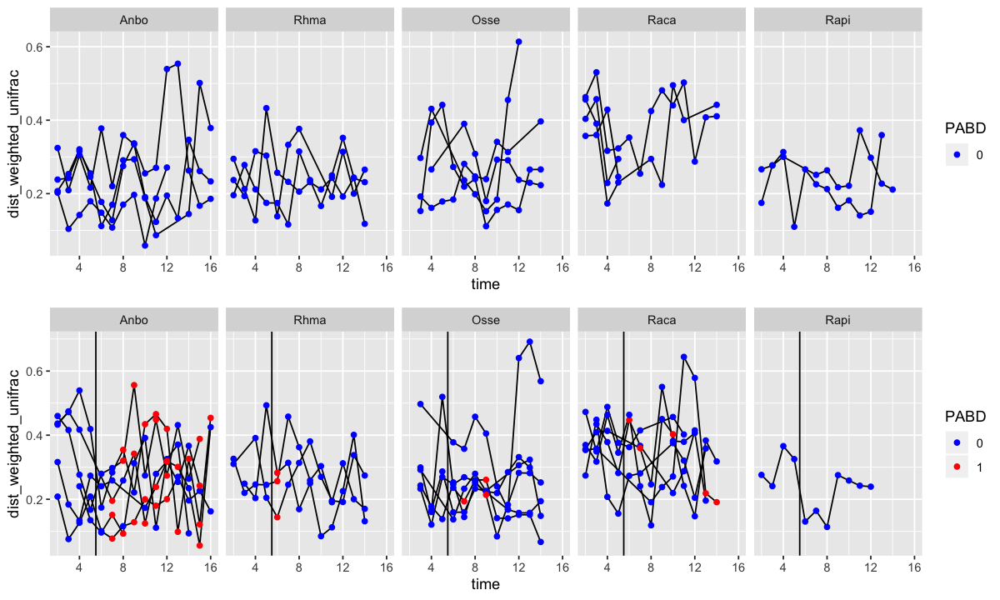

In [38]:
## Weighted Unifrac
# Check to see if turnover is changing with time significantly
gg_disttime_con <- mf_con %>%
    filter(!is.na(dist_weighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_weighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_disttime_treat <- mf_treat %>%
    filter(!is.na(dist_weighted_unifrac)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=dist_weighted_unifrac)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_disttime_con, gg_disttime_treat, nrow=2)

In [39]:
# Set up a function to calculate ANOVAs
# Make a function to calculate this so we don't have to type it out every time
anova_betareg_3way <- function(mf, dep, indep1, indep2, indep3) {
    # change names in mapping file
    temp_mf <- mf_alt_filt_final %>%
    rename(indep1=(indep1), indep2=(indep2), indep3=(indep3), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2, indep3)
    
    inter_3way <- Anova(betareg((dep) ~ indep1*indep2*indep3, data=temp_mf), type=3) # First do a sequential test
    inter_3way_sig <- inter_3way$`Pr(>Chisq)`[8] < 0.05
    if ( inter_3way_sig ) { # if indep1:time:Bd_exposure IS significant, we should do an ANOVA III to test all 2-way effects
        # Test each 2-way interaction
        inter_2way <- Anova(betareg((dep) ~ indep1*indep2*indep3, data=temp_mf), type=3) 
        indep1_indep2_sig <- (inter_2way$`Pr(>Chisq)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>Chisq)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>Chisq)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*Bd_exposure-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*Bd_exposure-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2, data=temp_mf), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2-species:indep3, data=temp_mf), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        }


    } else { # if there is NO 3-way significant interaction

        # Test each 2-way interaction
        inter_2way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf), type=3)
        indep1_indep2_sig <- (inter_2way$`Pr(>Chisq)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>Chisq)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>Chisq)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3-indep2:indep3, data=temp_mf), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2, data=temp_mf), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep2:indep3, data=temp_mf), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(betareg((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep1:indep3, data=temp_mf), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(betareg((dep) ~ indep1+indep2+indep3, data=temp_mf), type=3)
                }
            }
        }
    }
    ## Now, spit out results
    print("3-way interaction")
    print(paste0(indep1,":", indep2,":", indep3, " p = ",inter_3way$`Pr(>Chisq)`[8], ", Chisq(",inter_3way$Df[8],") = ",inter_3way$`Chisq`[8]))
    
    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>Chisq)`[5], ", Chisq(",inter_2way$Df[5],") = ",inter_2way$`Chisq`[5]))
    print(paste0(indep1,":", indep3, " p = ",inter_2way$`Pr(>Chisq)`[6], ", Chisq(",inter_2way$Df[6],") = ",inter_2way$`Chisq`[6]))
    print(paste0(indep2,":", indep3, " p = ",inter_2way$`Pr(>Chisq)`[7], ", Chisq(",inter_2way$Df[7],") = ",inter_2way$`Chisq`[7]))
    
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>Chisq)`[2], ", Chisq(",main_1way$Df[2],") = ",main_1way$`Chisq`[2]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>Chisq)`[3], ", Chisq(",main_1way$Df[3],") = ",main_1way$`Chisq`[3]))
    print(paste0(indep3, " p = ",main_1way$`Pr(>Chisq)`[4], ", Chisq(",main_1way$Df[4],") = ",main_1way$`Chisq`[4]))

    return(list(inter_3way, inter_2way, main_1way))

}


In [40]:
for ( b in beta_metrics) {
    print("--------")
    print(b)
    assign(paste0(b,"_dist_anova"), anova_betareg_3way(mf=mf_alt_filt_final, dep = paste0("dist_",b), indep1="species", indep2="time", indep3="Bd_exposure"))
}


[1] "--------"
[1] "braycurtis"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.858766048125945, Chisq(4) = 1.31534882062691"
[1] "2-way interaction"
[1] "species:time p = 0.830179419310584, Chisq(4) = 1.47999316665709"
[1] "species:Bd_exposure p = 0.354081176527826, Chisq(4) = 4.40401365280203"
[1] "time:Bd_exposure p = 0.416860211833961, Chisq(1) = 0.659149926026109"
[1] "1-way main interactions"
[1] "species p = 1.09910424510229e-09, Chisq(4) = 47.6825539505676"
[1] "time p = 0.21804219242779, Chisq(1) = 1.5172099980203"
[1] "Bd_exposure p = 0.849223423270906, Chisq(1) = 0.0361415747511262"
[1] "--------"
[1] "unweighted_unifrac"
[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.988836982189307, Chisq(4) = 0.314827971450356"
[1] "2-way interaction"
[1] "species:time p = 0.0796371019133813, Chisq(4) = 8.34780482559164"
[1] "species:Bd_exposure p = 0.183834777088311, Chisq(4) = 6.21244204283143"
[1] "time:Bd_exposure p = 0.150918531644647, Chisq(1) = 2.0629421612

In [41]:
# Or do manual comparisons of control and Bd_exposure
# Make a function to calculate this so we don't have to type it out every time
anova_betareg_2way <- function(mf, dep, indep1, indep2) {
    # change names in mapping file
    temp_mf <- mf %>%
    rename(indep1=(indep1), indep2=(indep2), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2)
    
    inter_2way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=3) 
    inter_2way_sig <- inter_2way$`Pr(>Chisq)`[4] < 0.05
    if ( inter_2way_sig ) {
        main_1way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=3)
    } else {
        main_1way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=2)
    }

    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>Chisq)`[4], ", Chisq(",inter_2way$Df[4],") = ",inter_2way$`Chisq`[4]))
     
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>Chisq)`[1], ", Chisq(",main_1way$Df[1],") = ",main_1way$`Chisq`[1]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>Chisq)`[2], ", Chisq(",main_1way$Df[2],") = ",main_1way$`Chisq`[2]))

    return(list(inter_2way, main_1way))

}

In [42]:
for ( b in beta_metrics ) {
    print("-------")
    print(b)
    print("CONTROL")
    assign(paste0("anova_dist_",b,"_con"),anova_betareg_2way(mf=mf_con, dep = paste0("dist_",b), indep1="species", indep2="time"))
    print("Bd_exposure")
    assign(paste0("anova_dist_",b,"_treat"),anova_betareg_2way(mf=mf_treat, dep = paste0("dist_",b), indep1="species", indep2="time"))

}

[1] "-------"
[1] "braycurtis"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.796211181230552, Chisq(4) = 1.66971564653508"
[1] "1-way main interactions"
[1] "species p = 1.38764340701417e-06, Chisq(4) = 32.6819517794248"
[1] "time p = 0.785205319517455, Chisq(1) = 0.0742791291292705"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.863871838162616, Chisq(4) = 1.28525730344115"
[1] "1-way main interactions"
[1] "species p = 8.59432493188854e-05, Chisq(4) = 23.841300385566"
[1] "time p = 0.183649949413768, Chisq(1) = 1.76783735965566"
[1] "-------"
[1] "unweighted_unifrac"
[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 0.506531077478599, Chisq(4) = 3.31517774558746"
[1] "1-way main interactions"
[1] "species p = 4.49048061163884e-28, Chisq(4) = 134.385522574168"
[1] "time p = 0.000769755801892831, Chisq(1) = 11.3127765634732"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.25073863535415, Chisq(4) = 5.3771757387196"
[1] "1-w

## Inhibitory proportion visualization

Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”

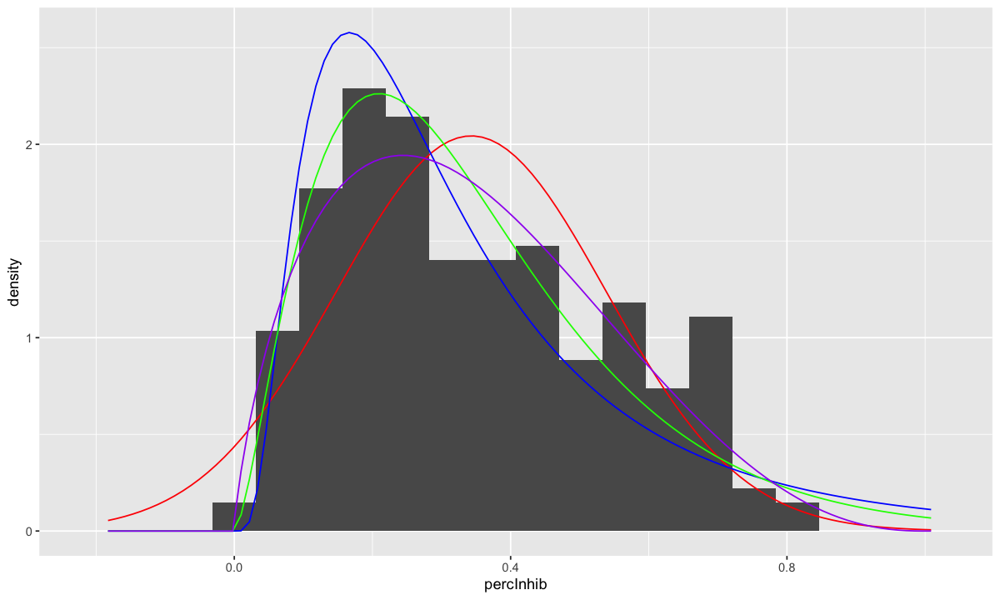

In [43]:
# Inhibitory proportion
    # eliminate NAs
    x.fit.norm <- seq(min(mf_con$percInhib)-sd(mf_con$percInhib)
                     , max(mf_con$percInhib)+sd(mf_con$percInhib)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(mf_con$percInhib, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(mf_con$percInhib, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(mf_con$percInhib, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    # Fit a beta
    param.beta <- fitdistr(mf_con$percInhib, densfun="beta", start=list(shape1=6,shape2=6))
    y.pred.beta <- dbeta(x.fit.norm, shape1=param.beta$estimate[1], shape2 = param.beta$estimate[2])

    
    ggplot(data=mf_con, aes(x=percInhib)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green") + 
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.beta), aes(x=x, y=y), col="purple")

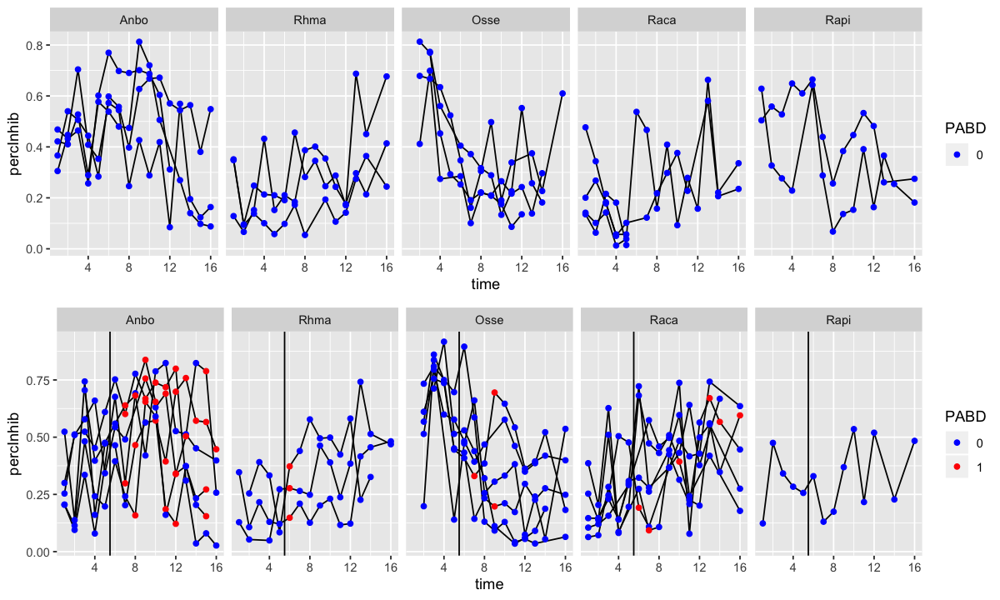

In [44]:
# Check to see if turnover is changing with time significantly
gg_percInhibtime_con <- mf_con %>%
    filter(!is.na(percInhib)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=percInhib)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_percInhibtime_treat <- mf_treat %>%
    filter(!is.na(percInhib)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=percInhib)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_percInhibtime_con, gg_percInhibtime_treat, nrow=2)

In [45]:
# Check ANOVAs to see if statistical change in percent inhibitory. I think the beta distribution above looks the best.
percInhib_anova <- anova_betareg_3way(mf=mf_alt_filt_final, dep="percInhib", indep1="species", indep2="time", indep3="Bd_exposure")


[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.203688453280079, Chisq(4) = 5.93981215805638"
[1] "2-way interaction"
[1] "species:time p = 1.11677862256583e-24, Chisq(4) = 118.500196243288"
[1] "species:Bd_exposure p = 0.0160985724741914, Chisq(4) = 12.1746678239264"
[1] "time:Bd_exposure p = 0.0715952510467093, Chisq(1) = 3.24606262112476"
[1] "1-way main interactions"
[1] "species p = 2.06836863420317e-23, Chisq(4) = 112.561319972827"
[1] "time p = 0.226725883902658, Chisq(1) = 1.46128431138861"
[1] "Bd_exposure p = 0.822140226664606, Chisq(1) = 0.0505319421160109"


In [46]:
# Or do manual comparisons of control and Bd_exposure
# Make a function to calculate this so we don't have to type it out every time
anova_betareg_2way_percInhib <- function(mf, dep, indep1, indep2) {
    # change names in mapping file
    temp_mf <- mf %>%
    rename(indep1=(indep1), indep2=(indep2), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2)
    
    inter_2way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=3) 
    inter_2way_sig <- inter_2way$`Pr(>Chisq)`[4] < 0.05
    if ( inter_2way_sig ) {
        main_1way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=3)
    } else {
        main_1way <- Anova(betareg((dep) ~ indep1*indep2, data=temp_mf), type=2)
    }

    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>Chisq)`[4], ", Chisq(",inter_2way$Df[4],") = ",inter_2way$`Chisq`[4]))
     
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>Chisq)`[2], ", Chisq(",main_1way$Df[2],") = ",main_1way$`Chisq`[2]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>Chisq)`[3], ", Chisq(",main_1way$Df[3],") = ",main_1way$`Chisq`[3]))

    return(list(inter_2way, main_1way))

}

In [47]:
# Separate control and treat
print("CONTROL")
anova_percInhib_con <- anova_betareg_2way_percInhib(mf=mf_con, dep = "percInhib", indep1="species", indep2="time")
print("Bd_exposure")
anova_percInhib_treat <- anova_betareg_2way_percInhib(mf=mf_treat, dep = "percInhib", indep1="species", indep2="time")


[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 5.63841182540648e-10, Chisq(4) = 49.0727029612388"
[1] "1-way main interactions"
[1] "species p = 6.18261617198646e-19, Chisq(4) = 91.5453488168655"
[1] "time p = 0.0137739292096693, Chisq(1) = 6.06688982957216"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 3.43433461985765e-15, Chisq(4) = 73.8819702469578"
[1] "1-way main interactions"
[1] "species p = 1.09508879526298e-15, Chisq(4) = 76.2288649176893"
[1] "time p = 0.842929262332258, Chisq(1) = 0.0392626341490796"


## Inhibitory richness visualization

Warning message in densfun(x, parm[1], parm[2], ...):
“NaNs produced”

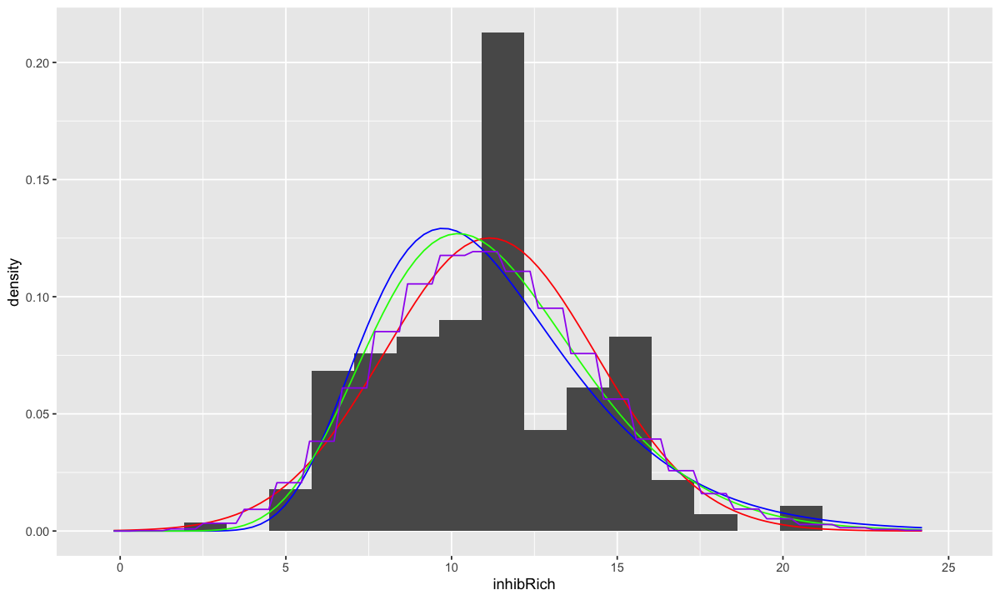

In [48]:
# Inhibitory richness
    # eliminate NAs
    inhibRich_dat <- mf_con$inhibRich
    x.fit.norm <- seq(min(inhibRich_dat)-sd(inhibRich_dat)
                     , max(inhibRich_dat)+sd(inhibRich_dat)
                     , length.out = 100)
    # Fit normal distribution
    param.norm <- fitdistr(inhibRich_dat, densfun="normal")
    y.pred.norm <- dnorm(x.fit.norm, mean = param.norm$estimate[1], sd = param.norm$estimate[2])
    # Fit a lognormal distribution
    param.lnorm <- fitdistr(inhibRich_dat, densfun="lognormal")
    y.pred.lnorm <- dlnorm(x.fit.norm, meanlog=param.lnorm$estimate[1], sdlog = param.lnorm$estimate[2])
    # Fit a gamma
    param.gamma <- fitdistr(inhibRich_dat, densfun="gamma")
    y.pred.gamma <- dgamma(x.fit.norm, shape=param.gamma$estimate[1], rate = param.gamma$estimate[2])
    # Fit a poisson
    param.pois <- fitdistr(inhibRich_dat, densfun="poisson")
    y.pred.pois <- dpois(round(x.fit.norm), lambda=param.pois$estimate[1])

    
    ggplot(data=mf_con, aes(x=inhibRich)) +
    geom_histogram(aes(y=..density..), bins=20) +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.norm), aes(x=x, y=y), col="red") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.lnorm), aes(x=x, y=y), col="blue") +
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.gamma), aes(x=x, y=y), col="green") + 
    geom_line(data=data.frame(x=x.fit.norm, y=y.pred.pois), aes(x=x, y=y), col="purple")

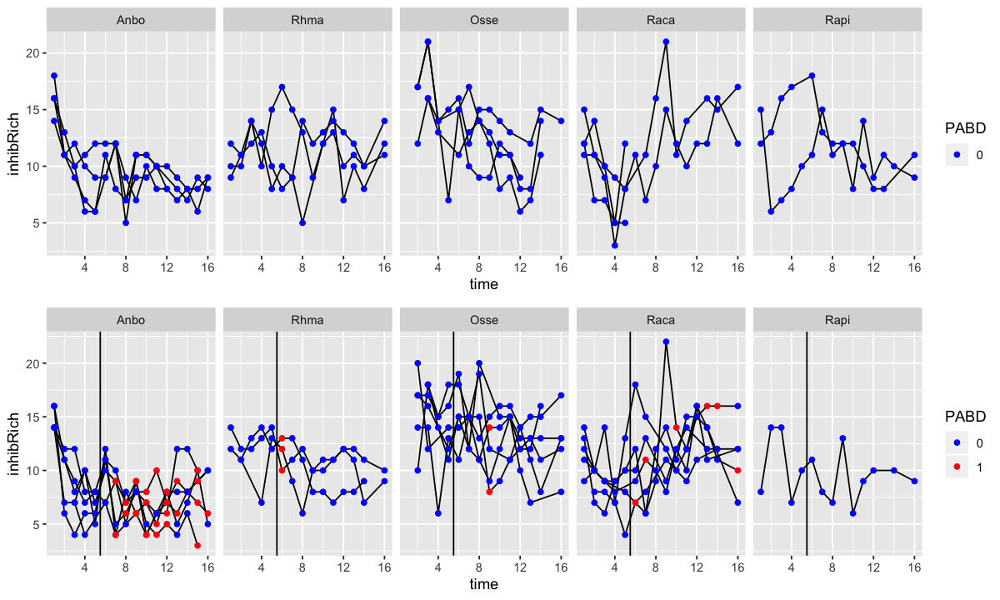

In [49]:
# Check to see if turnover is changing with time significantly
gg_inhibRichtime_con <- mf_con %>%
    filter(!is.na(inhibRich)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=inhibRich)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    facet_grid(~species)
gg_inhibRichtime_treat <- mf_treat %>%
    filter(!is.na(inhibRich)) %>%
    mutate(PABD=factor(PABD)) %>%
    ggplot(aes(x=time, y=inhibRich)) + 
    geom_line(aes(group=indivID)) +
    geom_point(aes(group=indivID, col=PABD)) +
    scale_color_manual(values=c("blue","red"))+
    geom_vline(aes(xintercept=5.5))+
    facet_grid(~species)
grid.arrange(gg_inhibRichtime_con, gg_inhibRichtime_treat, nrow=2)

In [50]:
# Set up a function to calculate ANOVAs
# Make a function to calculate this so we don't have to type it out every time
anova_poisson_3way <- function(mf, dep, indep1, indep2, indep3) {
    # change names in mapping file
    temp_mf <- mf_alt_filt_final %>%
    rename(indep1=(indep1), indep2=(indep2), indep3=(indep3), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2, indep3)
    
    inter_3way <- Anova(glm((dep) ~ indep1*indep2*indep3, data=temp_mf, family=poisson(link="identity")), type=3) # First do a sequential test
    print(inter_3way)
    inter_3way_sig <- inter_3way$`Pr(>Chisq)`[8] < 0.05
    if ( inter_3way_sig ) { # if indep1:time:Bd_exposure IS significant, we should do an ANOVA III to test all 2-way effects
        # Test each 2-way interaction
        inter_2way <- Anova(glm((dep) ~ indep1*indep2*indep3, data=temp_mf, family=poisson(link="identity")), type=3) 
        indep1_indep2_sig <- (inter_2way$`Pr(>Chisq)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>Chisq)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>Chisq)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*Bd_exposure-indep1:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*Bd_exposure-indep1:indep3-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2-species:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2-indep1:indep3-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            }
        }


    } else { # if there is NO 3-way significant interaction

        # Test each 2-way interaction
        inter_2way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
        indep1_indep2_sig <- (inter_2way$`Pr(>Chisq)`[5] < 0.05)
        indep1_indep3_sig <- (inter_2way$`Pr(>Chisq)`[6] < 0.05)
        indep2_indep3_sig <- (inter_2way$`Pr(>Chisq)`[7] < 0.05)

        if ( indep1_indep2_sig ) {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # if all 3 are sig
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # if 1,2 and 1,3 are sig, NOT 2,3
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    #if 1,2 and 2,3 are sig ( NOT 1,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # if 1,2 is sig (NOT 1,3 or 2,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep3-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            }
        } else {
            if ( indep1_indep3_sig ) {
                if ( indep2_indep3_sig ) {
                    # 1,3 and 2,3 is significant (NOT 1,2)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # 1,3 is sig (NOT 1,2 and 2,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep2:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            } else {
                if ( indep2_indep3_sig ) {
                    # 2,3 is sig (NOT 1,2 and 1,3)
                    main_1way <- Anova(glm((dep) ~ indep1*indep2*indep3-indep1:indep2:indep3-indep1:indep2-indep1:indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                } else {
                    # Nothing is significant
                    main_1way <- Anova(glm((dep) ~ indep1+indep2+indep3, data=temp_mf, family=poisson(link="identity")), type=3)
                }
            }
        }
    }
    ## Now, spit out results
    print("3-way interaction")
    print(paste0(indep1,":", indep2,":", indep3, " p = ",inter_3way$`Pr(>Chisq)`[8], ", Chisq(",inter_3way$Df[8],") = ",inter_3way$`Chisq`[8]))
    
    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>Chisq)`[5], ", Chisq(",inter_2way$Df[5],") = ",inter_2way$`Chisq`[5]))
    print(paste0(indep1,":", indep3, " p = ",inter_2way$`Pr(>Chisq)`[6], ", Chisq(",inter_2way$Df[6],") = ",inter_2way$`Chisq`[6]))
    print(paste0(indep2,":", indep3, " p = ",inter_2way$`Pr(>Chisq)`[7], ", Chisq(",inter_2way$Df[7],") = ",inter_2way$`Chisq`[7]))
    
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>Chisq)`[2], ", Chisq(",main_1way$Df[2],") = ",main_1way$`Chisq`[2]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>Chisq)`[3], ", Chisq(",main_1way$Df[3],") = ",main_1way$`Chisq`[3]))
    print(paste0(indep3, " p = ",main_1way$`Pr(>Chisq)`[4], ", Chisq(",main_1way$Df[4],") = ",main_1way$`Chisq`[4]))

    return(list(inter_3way, inter_2way, main_1way))

}


In [51]:
# Check ANOVAs to see if statistical change in percent inhibitory. I think the beta distribution above looks the best.
inhibRich_anova <- anova_betareg_3way(mf=mf_alt_filt_final, dep="percInhib", indep1="species", indep2="time", indep3="Bd_exposure")


[1] "3-way interaction"
[1] "species:time:Bd_exposure p = 0.203688453280079, Chisq(4) = 5.93981215805638"
[1] "2-way interaction"
[1] "species:time p = 1.11677862256583e-24, Chisq(4) = 118.500196243288"
[1] "species:Bd_exposure p = 0.0160985724741914, Chisq(4) = 12.1746678239264"
[1] "time:Bd_exposure p = 0.0715952510467093, Chisq(1) = 3.24606262112476"
[1] "1-way main interactions"
[1] "species p = 2.06836863420317e-23, Chisq(4) = 112.561319972827"
[1] "time p = 0.226725883902658, Chisq(1) = 1.46128431138861"
[1] "Bd_exposure p = 0.822140226664606, Chisq(1) = 0.0505319421160109"


In [52]:
# Or do manual comparisons of control and Bd_exposure
# Make a function to calculate this so we don't have to type it out every time
anova_pois_2way <- function(mf, dep, indep1, indep2) {
    # change names in mapping file
    temp_mf <- mf %>%
    rename(indep1=(indep1), indep2=(indep2), dep=(dep)) %>%
    dplyr::select(dep, indep1, indep2)
    
    inter_2way <- Anova(glm((dep) ~ indep1*indep2, data=temp_mf, family=poisson(link="identity")), type=3) 
    inter_2way_sig <- inter_2way$`Pr(>Chisq)`[3] < 0.05
    if ( inter_2way_sig ) {
        main_1way <- Anova(glm((dep) ~ indep1*indep2, data=temp_mf, family=poisson(link="identity")), type=3)
    } else {
        main_1way <- Anova(glm((dep) ~ indep1*indep2, data=temp_mf, family=poisson(link="identity")), type=2)
    }
    print("2-way interaction")
    print(paste0(indep1,":", indep2, " p = ",inter_2way$`Pr(>Chisq)`[3], ", LR Chisq(",inter_2way$Df[3],") = ",inter_2way$`LR Chisq`[3]))
     
    print("1-way main interactions")
    print(paste0(indep1, " p = ",main_1way$`Pr(>Chisq)`[1], ", LR Chisq(",main_1way$Df[1],") = ",main_1way$`LR Chisq`[1]))
    print(paste0(indep2, " p = ",main_1way$`Pr(>Chisq)`[2], ", LR Chisq(",main_1way$Df[2],") = ",main_1way$`LR Chisq`[2]))

    return(list(inter_2way, main_1way))

}

In [53]:
print("CONTROL")
anova_inhibRich_con <- anova_pois_2way(mf=mf_con, dep="inhibRich", indep1="species", indep2="time")
print("Bd_exposure")
anova_inhibRich_treat <- anova_pois_2way(mf=mf_treat, dep="inhibRich", indep1="species", indep2="time")



[1] "CONTROL"
[1] "2-way interaction"
[1] "species:time p = 1.70092047496161e-05, LR Chisq(4) = 27.3347640458686"
[1] "1-way main interactions"
[1] "species p = 3.34024732013679e-05, LR Chisq(4) = 25.8835399629209"
[1] "time p = 0.00173243232616666, LR Chisq(1) = 9.813418002345"
[1] "Bd_exposure"
[1] "2-way interaction"
[1] "species:time p = 0.000107499808542882, LR Chisq(4) = 23.355760508068"
[1] "1-way main interactions"
[1] "species p = 7.30857417726049e-08, LR Chisq(4) = 38.8991912997543"
[1] "time p = 0.00316994978254601, LR Chisq(1) = 8.70697391284472"


## Bayesian models

First, let's make a function to extract values and plot results from rstanarm


In [54]:
process_glmer <- function(g_lmer, dep, name_dep, transform_raw_func, intercept_present, fit_distr, time_factor=FALSE, overdispersion=FALSE, mf_con, mf_treat) {
  
  # ### FOR TESTING
  # g_lmer = glmer_inhibRich
  # dep= "inhibRich"
  # name_dep="inhibRich"
  # transform_raw_func="None"
  # intercept_present=T
  # fit_distr="Poisson"
  # overdispersion=F
  # time_factor=T

  
  # Need overdispersion term for poisson
  
  if (transform_raw_func == "log") {
    trans_func <- log
    alt_samps <- function(x) {return(x)} 
  } else if (transform_raw_func == "None") {
    trans_func <- function(x) {return(x)} 
    alt_samps <- function(x) {return(x)} 
  } else if (transform_raw_func == "beta") {
    trans_func <- function(x) {return(x)}
    a <- function(mu,phi){
      mu*phi
    }
    b <- function(mu,phi) {
      phi-mu*phi
    }
    mu <- function(a,phi) {
      a/phi
    }
    alt_samps <- function(x) {
      exp(x)/(exp(x)+1)
    }
    logit <- function(p) {
      log(p/(1-p))
    }
    mu_ab <- function(a,b) {
      a/(a+b)
    }
  } 
  
  
  # Alter mapping files
  mf_con_temp <- mf_con %>%
    rename(dep=paste0(dep)) %>%
    mutate(dep=trans_func(dep)) 
  mf_treat_temp <- mf_treat %>%
    rename(dep=paste0(dep)) %>%
    mutate(dep=trans_func(dep)) 
  # Look at distributions according to models
  samps <- rstan::extract(g_lmer$stanfit)
  pre_test_set <- mf_treat_temp %>%
    filter(time<6)
  # If time factor present
  if ( time_factor & intercept_present ) {
    t_var <- alt_samps(mean(samps$beta[,5]))
  } else if (time_factor) {
    t_var <- alt_samps(mean(samps$beta[,6]))
  } else {
    t_var <- 0
  }
  
  ## PLOT OF EXPECTED FOR EACH SPECIES
  if ( intercept_present ) {
    samps$beta <- samps$beta %>%
      as.data.frame() %>%
      mutate(Anbo=samps$alpha) %>%
      mutate(Rhma=alt_samps(Anbo+V1), Osse=alt_samps(Anbo+V2), Raca=alt_samps(Anbo+V3), Rapi=alt_samps(Anbo+V4)) %>%
      dplyr::select(Anbo, Rhma, Osse, Raca, Rapi) %>%
      rename(V1=Anbo, V2=Rhma, V3=Osse, V4=Raca, V5=Rapi) %>%
      as.matrix()
    gg_distr <- samps$beta %>%
      as.data.frame() %>%
      rename(Anbo=V1, Rhma=V2, Osse=V3, Raca=V4, Rapi=V5) %>%
      dplyr::select(Anbo,Rhma,Osse,Raca,Rapi) %>%
      gather(key=species, value=dependent_var) %>%
      mutate(species=factor(species, levels=c("Anbo","Rhma","Osse","Raca","Rapi"))) %>%
      ggplot(mapping=aes(x=species, y=dependent_var))+
      geom_violin() +
      geom_point(data=mf_con_temp, aes(y=dep-time*(t_var), x=species), position = position_jitter(width = 0.1, height=0), col="blue") +
      geom_point(data=pre_test_set, aes(y=dep-time*(t_var), x=species), position=position_jitter(width = 0.1, height=0), col="red") +
      ylab(label=paste0(name_dep))
    
  } else {
    gg_distr <- samps$beta %>%
      as.data.frame() %>%
      rename(Anbo=V1, Rhma=V2, Osse=V3, Raca=V4, Rapi=V5) %>%
      mutate(Anbo=alt_samps(Anbo), Rhma=alt_samps(Rhma), Osse=alt_samps(Osse), Raca=alt_samps(Raca), Rapi=alt_samps(Rapi)) %>%
      dplyr::select(Anbo,Rhma,Osse,Raca,Rapi) %>%
      gather(key=species, value=depenent_var) %>%
      mutate(species=factor(species, levels=c("Anbo","Rhma","Osse","Raca","Rapi"))) %>%
      ggplot(mapping=aes(x=species, y=depenent_var))+
      geom_violin() +
      geom_point(data=mf_con_temp, aes(y=dep-time*(t_var), x=species), position = position_jitter(width = 0.1, height=0), col="blue") +
      geom_point(data=pre_test_set, aes(y=dep-time*(t_var), x=species), position=position_jitter(width = 0.1, height=0), col="red") +
      ylab(label=paste0(name_dep))
    # Blue is controls, which the model is base don
    # Red is treatment individuals, which we are testing
  }
  
  ## Get standard deviation between toad individuals and samples
  ## For poisson, need to account for overdispersion
  # sd (variation) between samples
  samp_sigma <- samps$aux
  if ( overdispersion ) { 
    # sd (variation) between individuals of the same species
    indiv_intercept <- ranef(g_lmer)$indivID
    indivID_sigma <- sd(samps$b[,ncol(samps$b)])
    # sd (variation) between samples taken (overdispersion)
    samp_intercept <- ranef(g_lmer)$SampleID
    sampleID_sigma <- sd(samps$b[,nrow(samp_intercept)+1])
    # get toad_samps, which is change per toad
    # Get standard deviation between toad individuals and samples
    samp_indiv <- samps$b[,(nrow(samp_intercept)+2):(nrow(samp_intercept)+1+nrow(indiv_intercept))]
    colnames(samp_indiv) <- rownames(indiv_intercept)
    
  } else {
    # sd (variation) between individuals of the same species
    indivID_sigma <- sd(samps$b[,ncol(samps$b)])
    sampleID_sigma <- 0
  }
  
  
  # Now, we can calculate the probability that the "test" dataset values come from this distribution
  # List of individuals
  treat_indiv <- unique(mf_treat_temp$indivID)
  # List of each species
  species_list <- levels(factor(mf_con_temp$species))
  
  
  species_key <- treat_indiv %>%
    as_tibble() %>%
    rename(indivID=value) %>%
    separate(indivID,into=c("species","indiv"), remove=FALSE)
  
  exp_distr <- as.data.frame(matrix(ncol=length(species_list), nrow=4000, dimnames = list(1:4000, species_list)))
  for ( num_sp in 1:length(species_list)) {
    if ( fit_distr == "normal" ) {
      # Expected value at each species level
      exp_sp <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=indivID_sigma)
      # Expected value after "sampling"
      exp_distr[,num_sp] <- rnorm(length(samps$beta[,num_sp]), mean=exp_sp, sd=samp_sigma)
    } else if ( fit_distr == "Gamma" ) {
      # Expected value at each species level
      exp_sp <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=indivID_sigma)
      # Expected value after "sampling"
      exp_distr[,num_sp] <- rgamma(n=length(samps$beta[,num_sp]), shape=exp_sp, scale=1) # pretty sure default is 1
    } else if  ( fit_distr == "Beta" ) {
      
      ## TEST
      mu <- alt_samps(rnorm(4000, mean=samps$beta[,num_sp], sd=indivID_sigma))
      
      exp_distr[,num_sp] <-  rbeta(length(samps$beta[,num_sp])
                                   ,shape1=a(mu,(samps$aux))
                                   ,shape2=b(mu,(samps$aux)))
      
      # # ORIGINAL
      # mu <- alt_samps(rnorm(4000, mean=samps$beta[,num_sp], sd=indivID_sigma))
      # # exp_distr[,nump_sp] <- mu
      # exp_distr[,num_sp] <- rbeta(length(samps$beta[,num_sp])
      #                             ,shape1=a(mu,samps$aux)
      #                             ,shape2=b(mu,samps$aux))
      # 
      
    } else if ( fit_distr == "Poisson" ) {
      mu <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=sampleID_sigma)
      rpois(length(samps$beta[,num_sp]), lambda=mu)
      exp_distr[,num_sp] <- rpois(length(samps$beta[,num_sp]), lambda=mu)
      
    }
    
  }
  
  # Loop through and calculate probability of having diversity at that level
  pre_exp_indiv <- data.frame(indivID=treat_indiv, exp=rep(NA, length(treat_indiv)), p=rep(NA, length(treat_indiv)), infect=rep(NA, length(treat_indiv)))
  for ( i in treat_indiv ) {
    n_row <- match(i, treat_indiv)
    sp <- unlist(strsplit(i,"_"))
    num_sp <- match(sp[1], levels(factor(mf_con_temp$species)))
    temp_dep <- mf_treat_temp %>%
      filter(indivID==i, time <=5 ) %>%
      dplyr::select(dep) %>%
      pull()
    temp_time <- mf_treat_temp %>%
      filter(indivID==i, time <=5 ) %>%
      dplyr::select(time) %>%
      pull()
    
    x.fit <- temp_dep-temp_time*mean(t_var)
    x.fit <- x.fit[!is.na(x.fit)]
    # I don't use a beta distribution here because often times optimization fails.
    # I think the sample size is too small to adequeately estimate shape1 and shape2?
    if ( fit_distr != "Beta" ) {
      if ( length(x.fit)>1 ) {
        fitted <- fitdistr(x.fit, densfun = paste0(fit_distr))$estimate
        if ( fit_distr!="Gamma") {
          exp <- fitted[1]
        } else {
          exp <-  fitted[1]/fitted[2]
          
        }
      } else if (length(x.fit) == 1 ) {
        exp <- x.fit
      } else {
        exp <- NA
      }
    } else {
      if ( length(x.fit)>1 ) {
        exp <-  fitdistr(x.fit, densfun = "normal")$estimate[1]
      } else if (length(x.fit) == 1) {
        exp <- (x.fit)
      } else {
        exp <- NA
      }
    }
    
    
    # pred_distr <- rnorm(length(samps_lmer_shannon$beta[,num_sp]), mean=rnorm(length(samps_lmer_shannon$beta[,num_sp]), mean=samps_lmer_shannon$beta[,num_sp], sd=toadID_sigma), sd=samp_sigma)
    p <- sum(exp_distr[,sp[1]]<exp)/length(exp_distr[,sp[1]])
    
    ### Did they get infected?
    infect <- max(mf_treat %>%
                    filter(indivID==i) %>%
                    dplyr::select(Bd_load) %>%
                    pull()
    )
    
    pre_exp_indiv[n_row,c("exp","p","infect")] <- c(exp, p, infect)
    
  }
  
  if ( intercept_present ) {
    # Get estimates for control toads
    species_exp <- fixef(g_lmer)[1:5]  %>%
      tibble::enframe() %>%
      dplyr::select(value) %>%
      t() %>%
      as.data.frame() %>%
      mutate("Anbo"=V1, "Rhma"=V1+V2, "Osse"=V1+V3, "Raca"=V1+V4, "Rapi"=V1+V5) %>%
      dplyr::select(Anbo, Rhma, Osse, Raca, Rapi) %>%
      t() %>%
      as.data.frame()  %>%
      mutate(species=c("Anbo","Rhma","Osse","Raca","Rapi")) %>%
      rename(value=V1)
  } else {
    # Get estimates for control toads
    species_exp <- fixef(g_lmer)[1:5]  %>%
      tibble::enframe() %>%
      mutate(species=c("Anbo", "Rhma","Osse","Raca","Rapi"))
  }
  
  # Need to extract ranef manually for beta; not sure why fixef works and ranef doesn't
  if ( fit_distr == "Beta" ) {
    randeffects_dist <- g_lmer$coefficients[grep("Intercept", names(g_lmer$coefficients))]
    names_randef <- names(randeffects_dist)
    names(randeffects_dist) <- gsub("]","",gsub("^.* indivID:", "", x=names_randef), fixed=TRUE)
    temp_randeffects <- data.frame(X=as.numeric(randeffects_dist), row.names = names(randeffects_dist))
    temp_randeffects <- temp_randeffects %>%
      rename(sp_est="X")
  } else {
    temp_randeffects <- ranef(g_lmer)$indivID %>%
      rename(sp_est="(Intercept)")
  }
  
  con_toad_est <- temp_randeffects %>%
    mutate(indivID=rownames(temp_randeffects)) %>%
    separate(indivID, into=c("species","num"), sep="_",remove=FALSE) %>%
    dplyr::select(-num) %>%
    left_join(species_exp, by = "species") %>%
    mutate(est=sp_est+value)
  
  con_exp_indiv <- data.frame(indivID=con_toad_est$indivID, exp=rep(NA, length(con_toad_est$indivID)), p=rep(NA, length(con_toad_est$indivID)))
  for ( i in 1:nrow(con_toad_est) ) {
    s <- con_toad_est[i,"species"]
    
    exp <- alt_samps(con_toad_est[i,"est"])
    p <- sum(exp_distr[,s]<exp)/length(exp_distr[,s])
    
    con_exp_indiv[i,c("exp","p")] <- c(exp, p)
  }
  con_exp_indiv <- con_exp_indiv %>%
    separate(indivID, into=c("species","indiv"), remove=FALSE)
  
  
  # create species column
  pre_exp_indiv <- pre_exp_indiv %>%
    separate(indivID, into=c("species","indiv"), remove = FALSE) %>%
    mutate(species=factor(species, levels=c("Anbo","Rhma","Osse","Raca","Rapi")))
  # Plot results 
  gg_p <- ggplot(pre_exp_indiv, aes(x=p, y=log(infect+1))) +
    geom_point(aes(color=species), cex=4) +
    geom_smooth(aes(color=species),method=lm, se = FALSE) +
    geom_smooth(method=lm, se=FALSE, col="black") +
    xlab(label=paste0("p_",name_dep))
  # if we'd JUST plotted raw values
  gg_raw <- ggplot(pre_exp_indiv, aes(x=exp, y=log(infect+1)))+
    geom_point(aes(color=species), cex=4) +
    geom_smooth(method=lm, se=FALSE, col="black") +
    geom_smooth(aes(color=species),method=lm, se = FALSE) +
    xlab(label=paste0("exp_",name_dep))
  #grid.arrange(gg_p, gg_raw, nrow=1)
  
  gg_exp_distr <- exp_distr %>%
    # add time adjustment to raw data values
    gather(key=species, value=dep_var) %>%
    mutate(species=factor(species,levels=c("Anbo","Rhma","Osse","Raca","Rapi")))%>%
    ggplot(aes(x=species, y=dep_var)) +
    geom_violin() +
    geom_point(data=pre_exp_indiv, aes(x=species, y=exp, col=log(infect+1)), cex=4, position=position_jitter(height=0, width=0.1)) +
    ylab(label=paste0(name_dep))
  
  gg_exp_distr_controls <- exp_distr %>%
    # add time adjustment to raw data values
    gather(key=species, value=dep_var) %>%
    mutate(species=factor(species,levels=c("Anbo","Rhma","Osse","Raca","Rapi")))%>%
    ggplot(aes(x=species, y=dep_var)) +
    geom_violin() +
    geom_point(data=con_exp_indiv, aes(x=species, y=exp), cex=3, position=position_jitter(height=0, width=0.1)) +
    ylab(label=paste0(name_dep))
  
  all_p <- pre_exp_indiv %>%
    dplyr::select(indivID, exp, p,infect) 
  
  # Make list of items
  output <- list()
  output[["Var"]] <- data.frame( dep=dep, name_dep=name_dep
                                 , transform_raw_func=transform_raw_func
                                 , intercept_present=intercept_present
                                 ,fit_distr=fit_distr)
  output[["gg_model_Distribution_of_all_values"]] <- gg_distr
  output[["Control_individuals"]] <- con_exp_indiv
  output[["gg_p"]] <- gg_p
  output[["gg_raw"]] <- gg_raw
  output[["gg_ExpectedDistribution_and_Bd_exposed"]] <- gg_exp_distr
  output[["gg_ExpectedDistribution_controls"]] <- gg_exp_distr_controls
  output[["all_p"]] <- all_p
  
  return(output)
}


In [55]:
# Re-run everything?
RERUN_RICH = FALSE
RERUN_DIST = FALSE
RERUN_DISP = FALSE
RERUN_PERCINHIB = FALSE
RERUN_INHIBRICH = FALSE


### Observed OTUs
For observed OTUs, we saw that the lognormal fit was the best. So, our bayesian model is as follows:


log(u) ~ N(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [56]:
if ( RERUN_RICH ) {

  lmer_log_observed_otus <- stan_lmer(log(observed_otus) ~ -1 + species + (1|indivID), data=mf_con
                              , prior = normal(0, 10, autoscale = TRUE)
                              #, family = gaussian(link="log")
                              , seed = 988735
                              , adapt_delta = 0.999

  )
  save(lmer_log_observed_otus, file="./4_Bayesian_models/lmer_log_observed_otus.RData")
} else {
  load("./4_Bayesian_models/lmer_log_observed_otus.RData")
}
prior_summary(lmer_log_observed_otus)


Priors for model 'lmer_log_observed_otus' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [3.75,3.75,3.75,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.7)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Calling `as_tibble()` on a vector is discouraged, because the behavior is likely to change in the future. Use `tibble::enframe(name = NULL)` instead.
This warning is displayed once per session.”

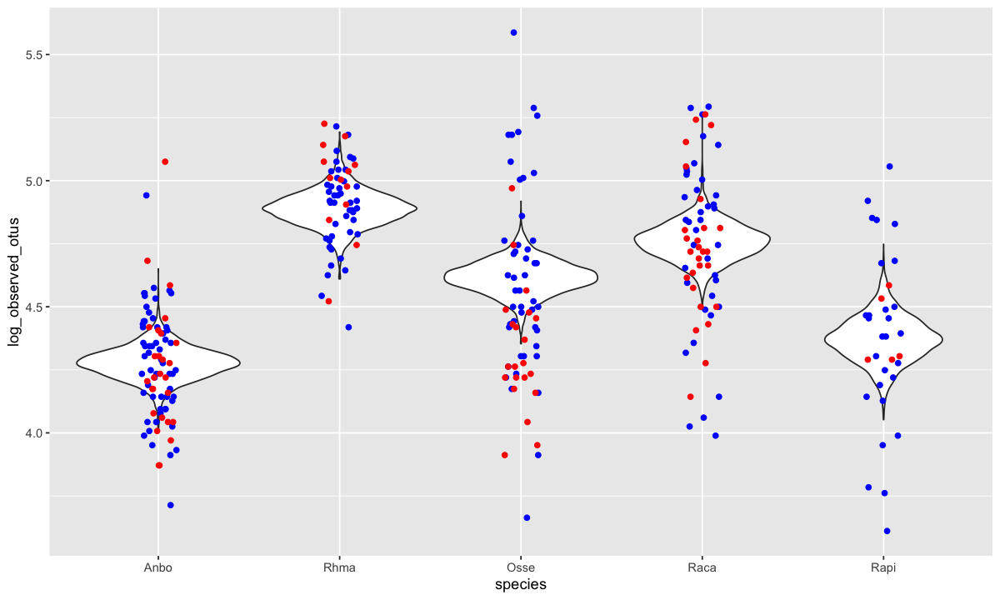

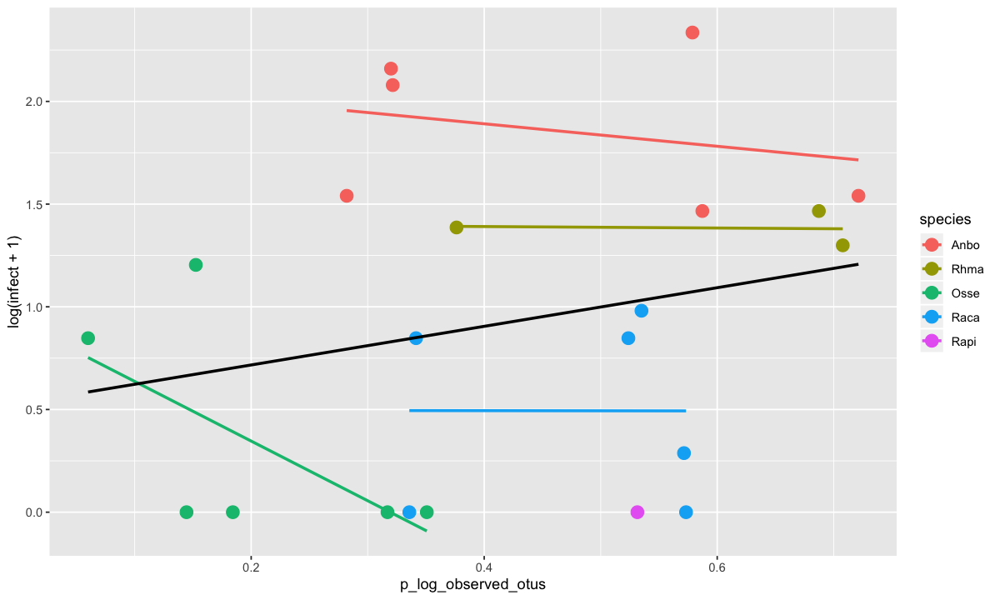

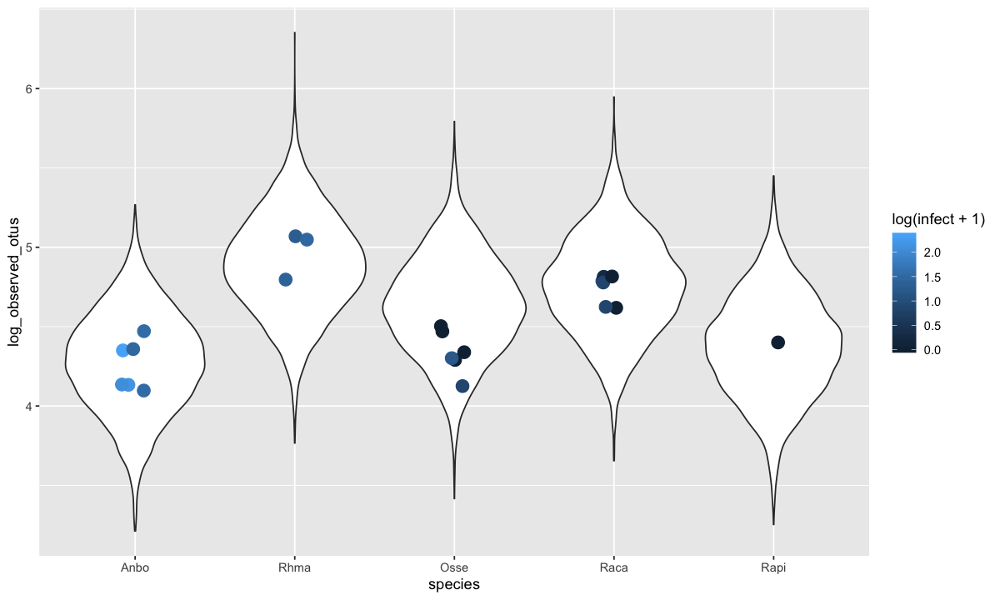

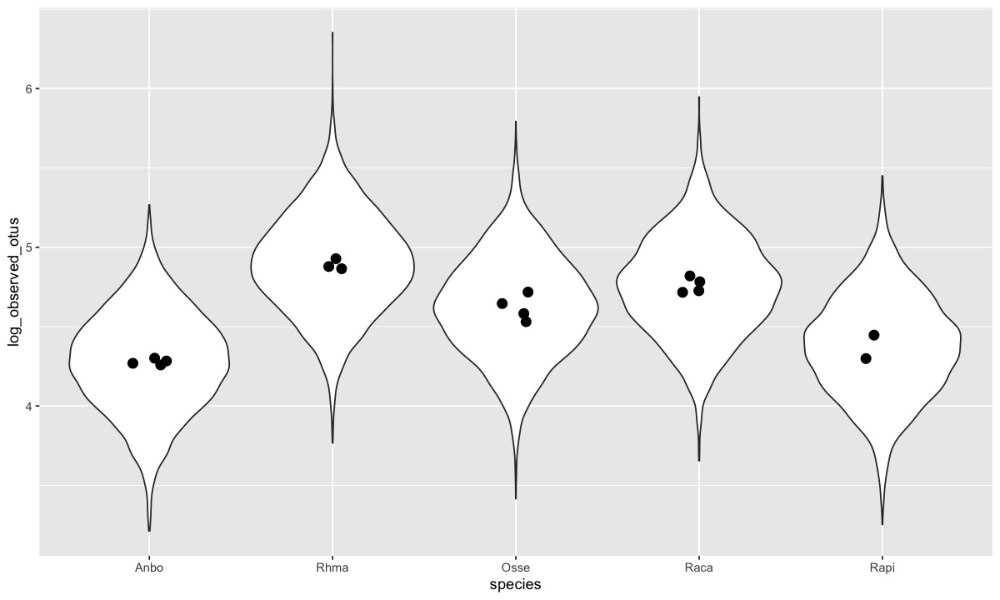

In [57]:

observed_otus_processed <- process_glmer(g_lmer = lmer_log_observed_otus
                      , dep= "observed_otus"
                      , name_dep="log_observed_otus"
                      , transform_raw_func="log"
                      , intercept_present=F
                      , fit_distr="normal"
                      , mf_con=mf_con
                      , mf_treat=mf_treat)
observed_otus_processed$gg_model_Distribution_of_all_values
observed_otus_processed$gg_p
observed_otus_processed$gg_ExpectedDistribution_and_Bd_exposed
observed_otus_processed$gg_ExpectedDistribution_controls

### Chao1
For Chao1, we saw that the lognormal fit was the best. So, our bayesian model is as follows:


log(u) ~ N(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species



In [58]:
##### Chao1 #######

if ( RERUN_RICH ) {
  
  lmer_log_chao1 <- stan_lmer(log(chao1) ~ -1 + species + (1|indivID), data=mf_con
                                      , prior = normal(0, 10, autoscale = TRUE)
                                      #, family = gaussian(link="log")
                                      , seed = 5793482
                                      , adapt_delta = 0.999
                                      
  )
  save(lmer_log_chao1, file="./4_Bayesian_models/lmer_log_chao1.RData")
} else {
  load("./4_Bayesian_models/lmer_log_chao1.RData")
}
prior_summary(lmer_log_chao1)


Priors for model 'lmer_log_chao1' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [4.07,4.07,4.07,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.5)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

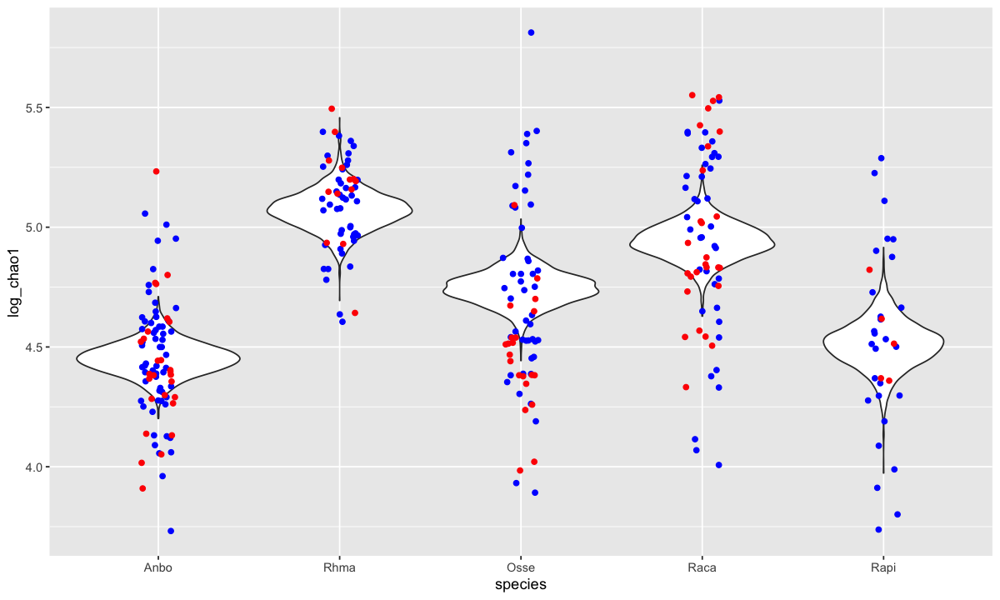

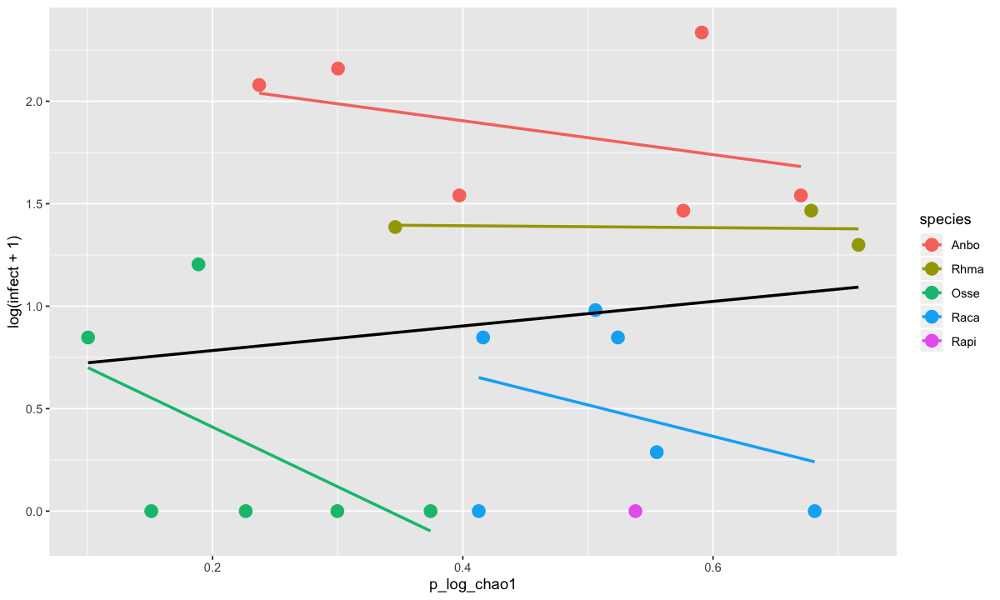

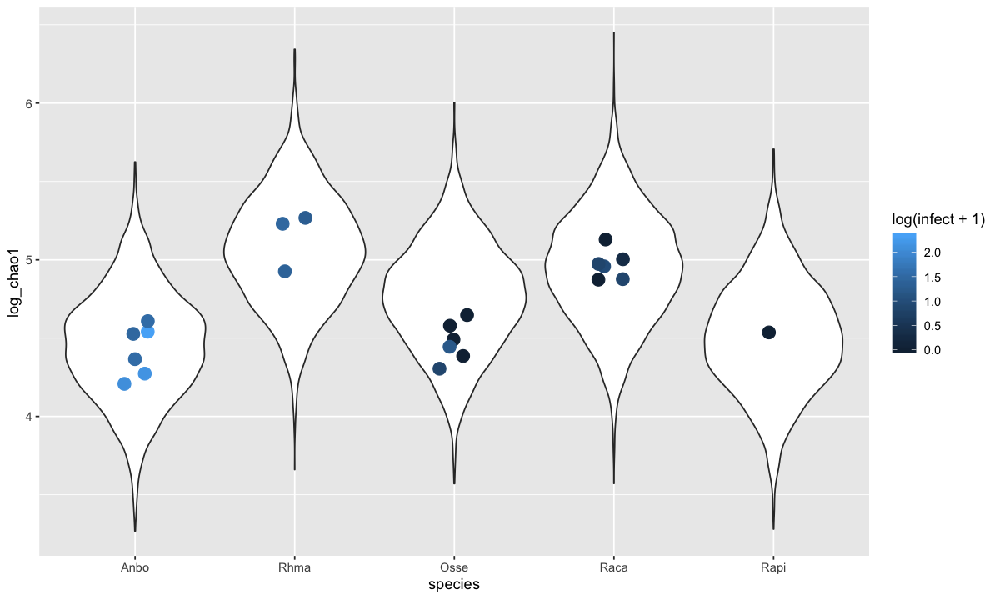

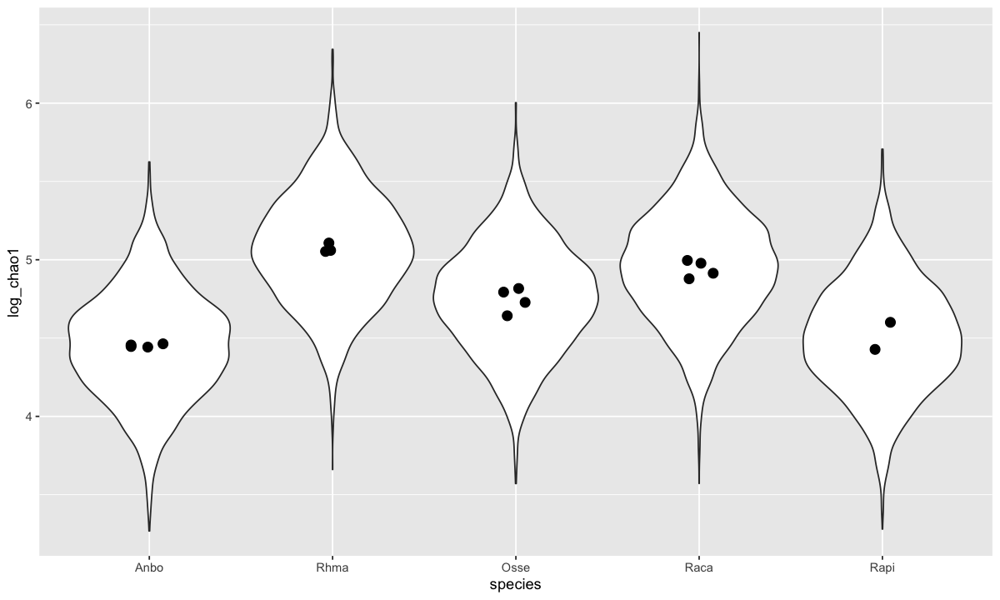

In [59]:
chao1_processed <- process_glmer(g_lmer = lmer_log_chao1
              , dep= "chao1"
              , name_dep="log_chao1"
              , transform_raw_func="log"
              , intercept_present=F
              , fit_distr="normal"
              , mf_con=mf_con
              , mf_treat=mf_treat)
chao1_processed$gg_model_Distribution_of_all_values
chao1_processed$gg_p
chao1_processed$gg_ExpectedDistribution_and_Bd_exposed
chao1_processed$gg_ExpectedDistribution_controls


### Shannon
For shannon, we saw that the normal fit was the best. So, our bayesian model is as follows:


u ~ N(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species


In [60]:
if ( RERUN_RICH ) {
  
  lmer_shannon <- stan_lmer(shannon ~ -1 + species + (1|indivID), data=mf_con
                              , prior = normal(0, 10, autoscale = TRUE)
                              , seed = 5793482
                              , adapt_delta = 0.999
                              
  )
  save(lmer_shannon, file="./4_Bayesian_models/lmer_shannon.RData")
} else {
  load("./4_Bayesian_models/lmer_shannon.RData")
}
prior_summary(lmer_shannon)



Priors for model 'lmer_shannon' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [7.51,7.51,7.51,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.3)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

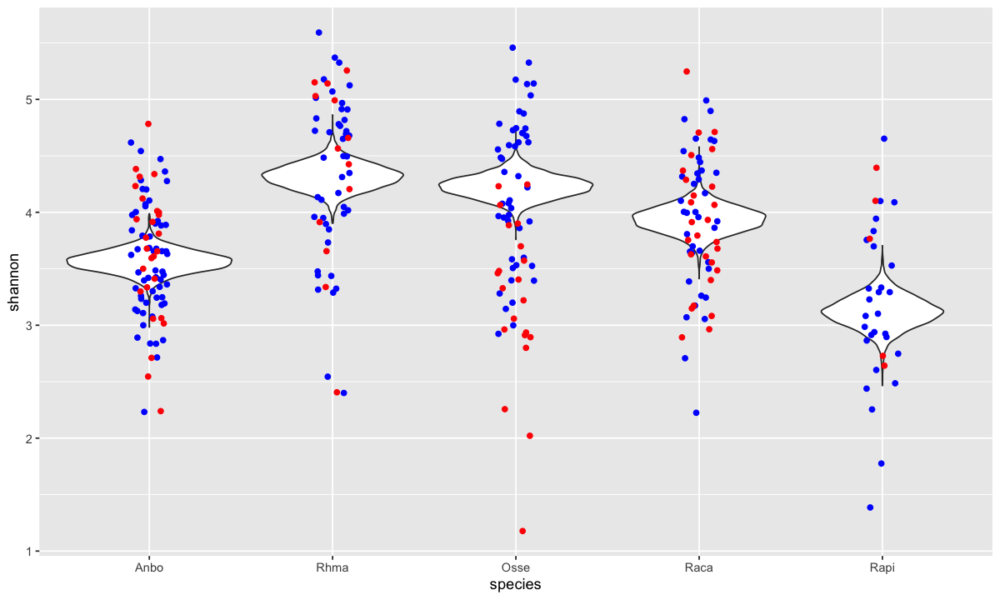

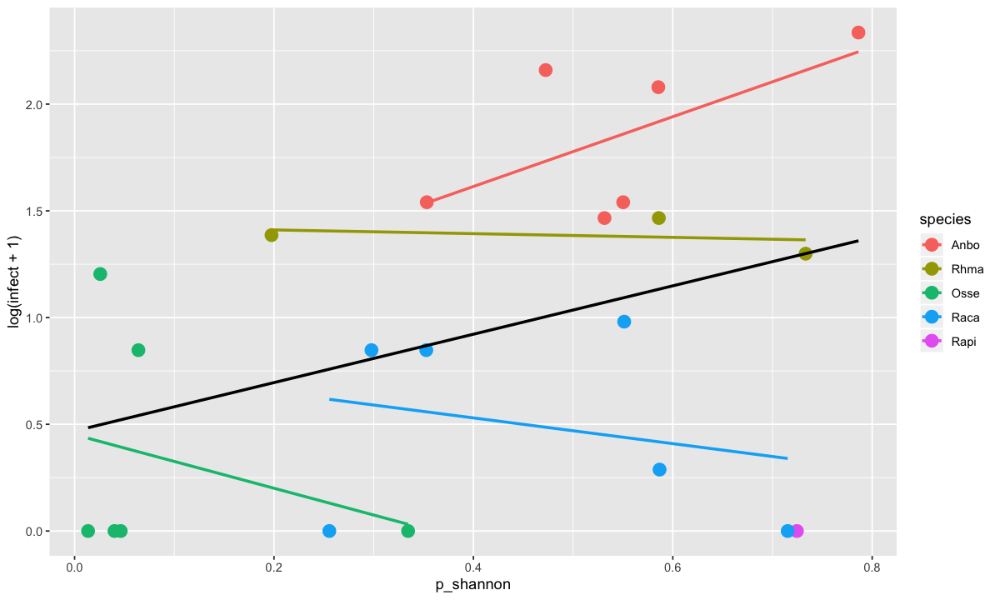

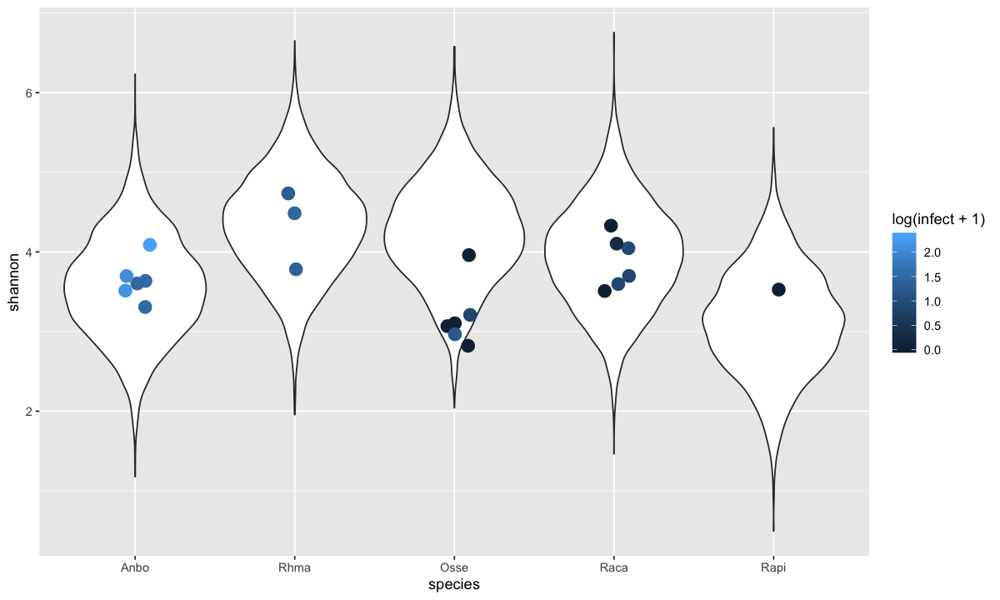

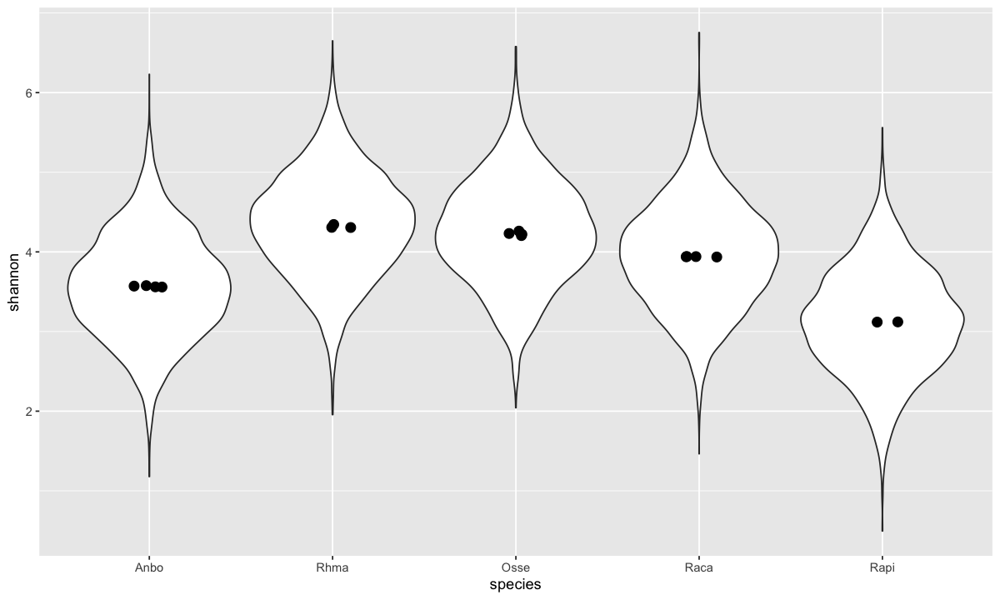

In [61]:
shannon_processed <- process_glmer(g_lmer = lmer_shannon
                                 , dep= "shannon"
                                 , name_dep="shannon"
                                 , transform_raw_func="None"
                                 , intercept_present=F
                                 , fit_distr="normal"
                                 , mf_con=mf_con
                                 , mf_treat=mf_treat)
shannon_processed$gg_model_Distribution_of_all_values
shannon_processed$gg_p
shannon_processed$gg_ExpectedDistribution_and_Bd_exposed
shannon_processed$gg_ExpectedDistribution_controls

### Faith's PD
For faith's PD, we saw that the gamma fit was the best. So, our bayesian model is as follows:


u ~ G(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [62]:
if ( RERUN_RICH ) {
  
  glmer_faith_pd <- stan_glmer(faith_pd ~ species + (1|indivID), data=mf_con
                            , prior = normal(0, 10, autoscale = TRUE)
                            , seed = 5793482
                            , family=Gamma(link="identity")
                            , adapt_delta = 0.999

  )
  save(glmer_faith_pd, file="./4_Bayesian_models/glmer_faith_pd.RData")
} else {
  load("./4_Bayesian_models/glmer_faith_pd.RData")
}
prior_summary(glmer_faith_pd)

Priors for model 'glmer_faith_pd' 
------
Intercept (after predictors centered)
 ~ normal(location = 0, scale = 10)

Coefficients
 ~ normal(location = [0,0,0,...], scale = [10,10,10,...])

Auxiliary (shape)
 ~ exponential(rate = 1)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

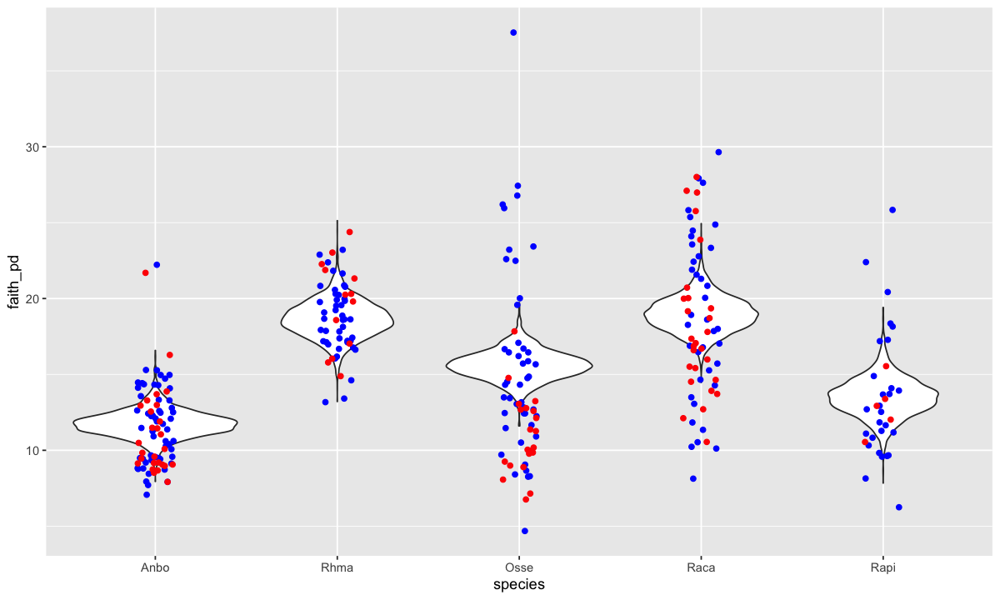

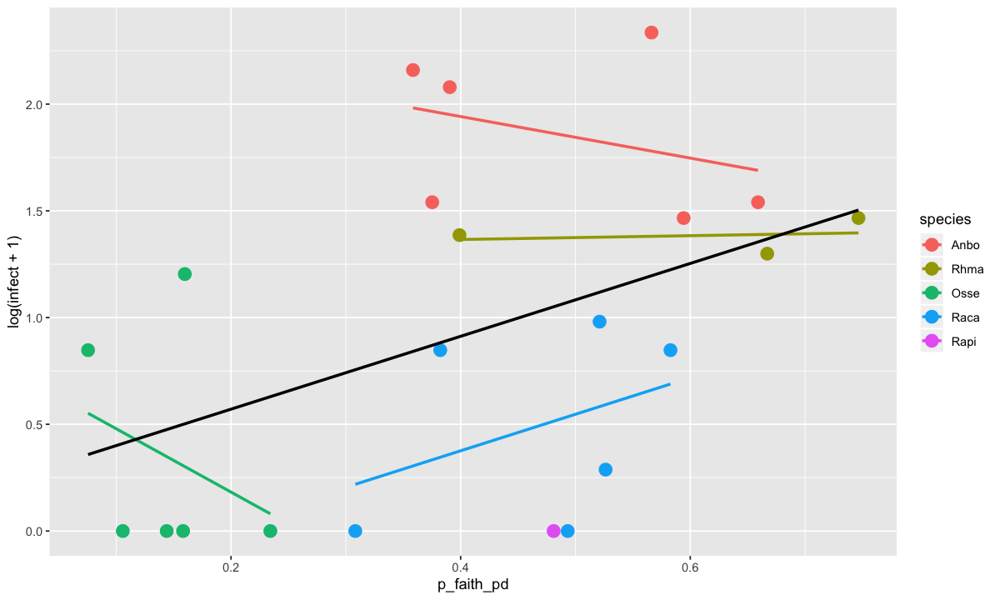

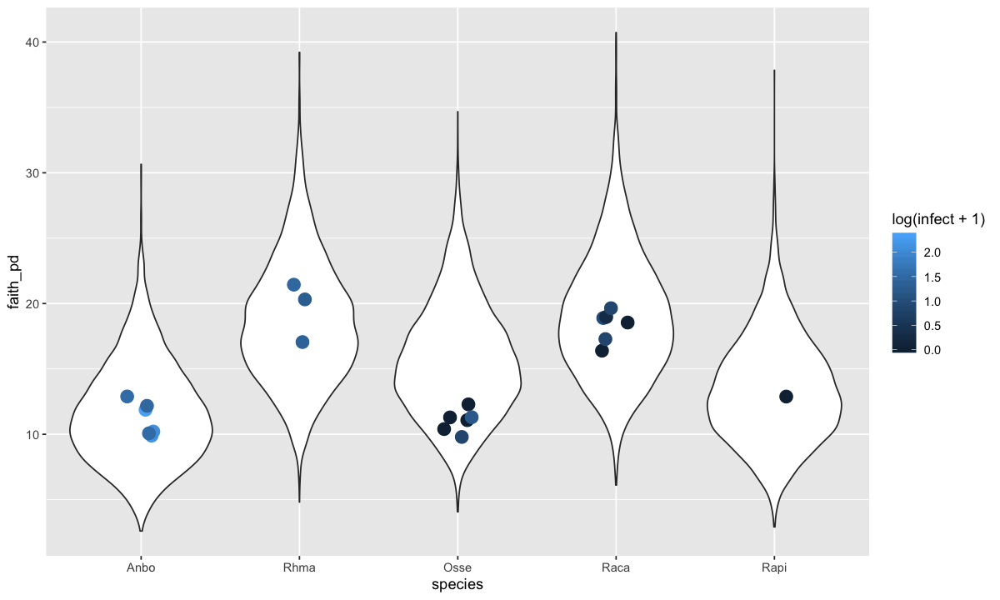

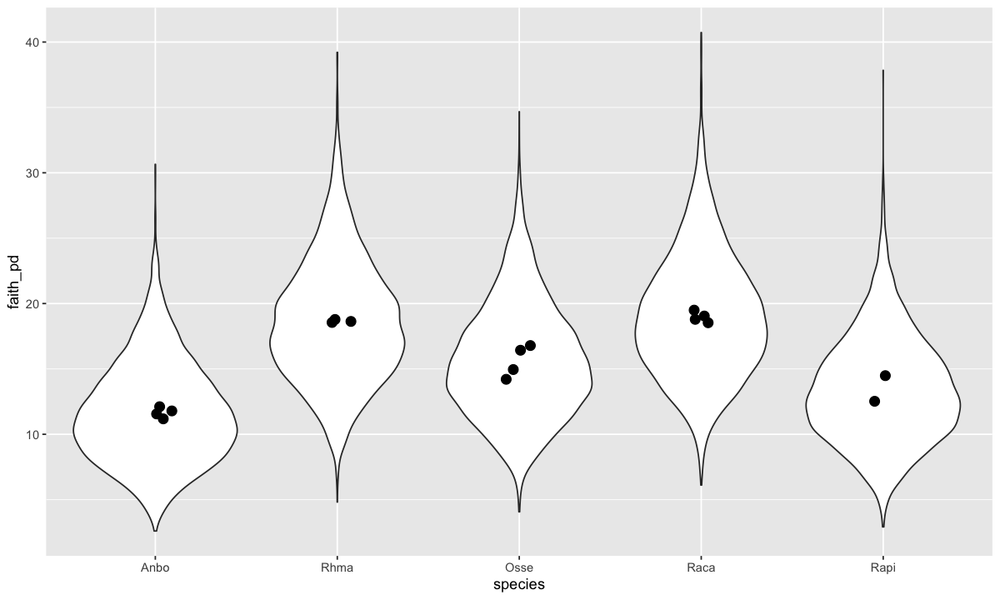

In [63]:
faith_pd_processed <- process_glmer(g_lmer = glmer_faith_pd
                                   , dep= "faith_pd"
                                   , name_dep="faith_pd"
                                   , transform_raw_func="None"
                                   , intercept_present=T
                                   , fit_distr="Gamma"
                                   , mf_con = mf_con
                                   , mf_treat=mf_treat
                                   )

faith_pd_processed$gg_model_Distribution_of_all_values
faith_pd_processed$gg_p
faith_pd_processed$gg_ExpectedDistribution_and_Bd_exposed
faith_pd_processed$gg_ExpectedDistribution_controls


### Braycurtis Dispersion 
log(u) ~ N(u_i, sigma_i)\
u_i = a_j + t_j\
a_j ~ N(u_sp, sigma_sp)\
t_j ~ N(t, sigma_t\
where i = sample, j = individual, sp = species, t = time

In [64]:
if ( RERUN_DISP ) {
  
  lmer_disper_braycurtis <- stan_lmer(log(disper_braycurtis) ~ -1 + species + (1|indivID) + time
                             , data=mf_con
                             , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                             , prior = normal(location=0, scale=5, autoscale=TRUE)
                             , seed= 29473
  )
  save(lmer_disper_braycurtis, file="./4_Bayesian_models/lmer_disper_braycurtis.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_braycurtis.RData")
}
prior_summary(lmer_disper_braycurtis)

Priors for model 'lmer_disper_braycurtis' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.35,1.35,1.35,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 3.7)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

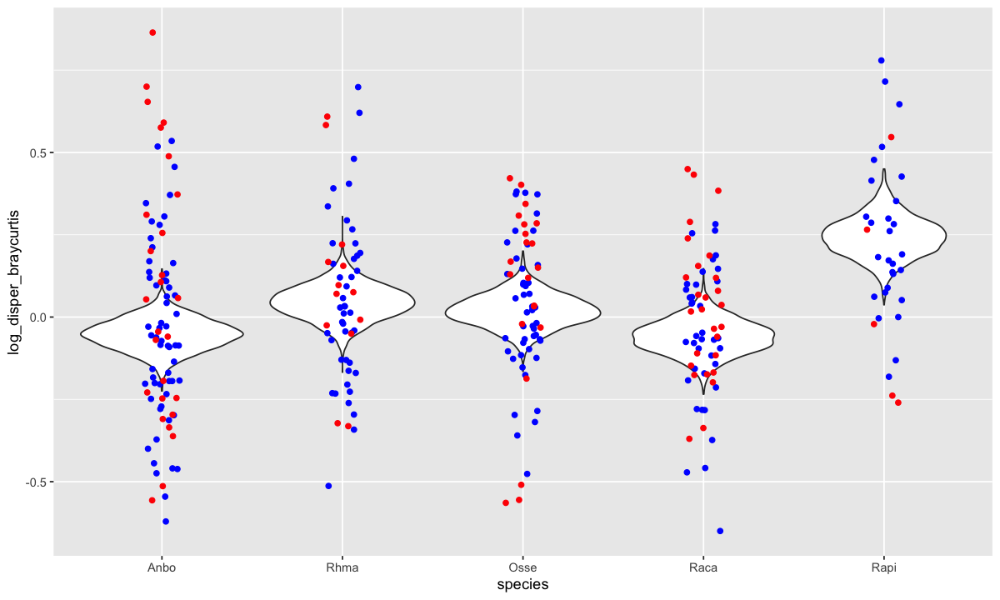

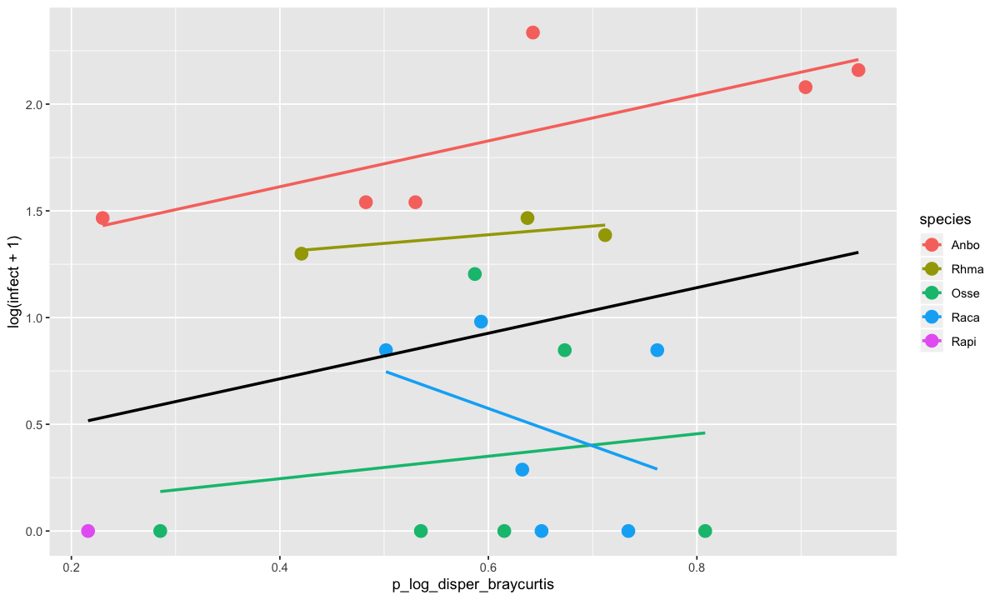

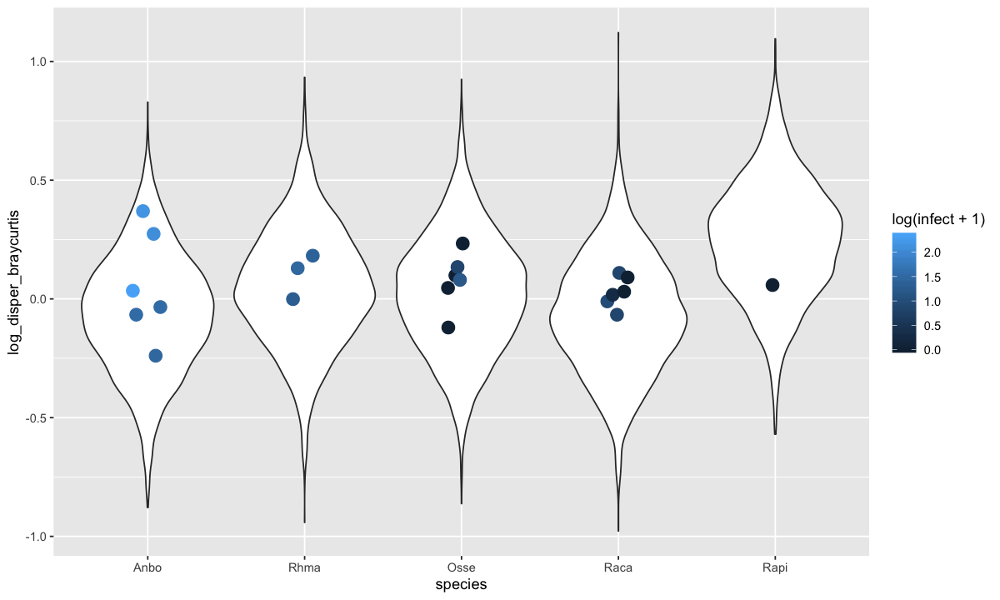

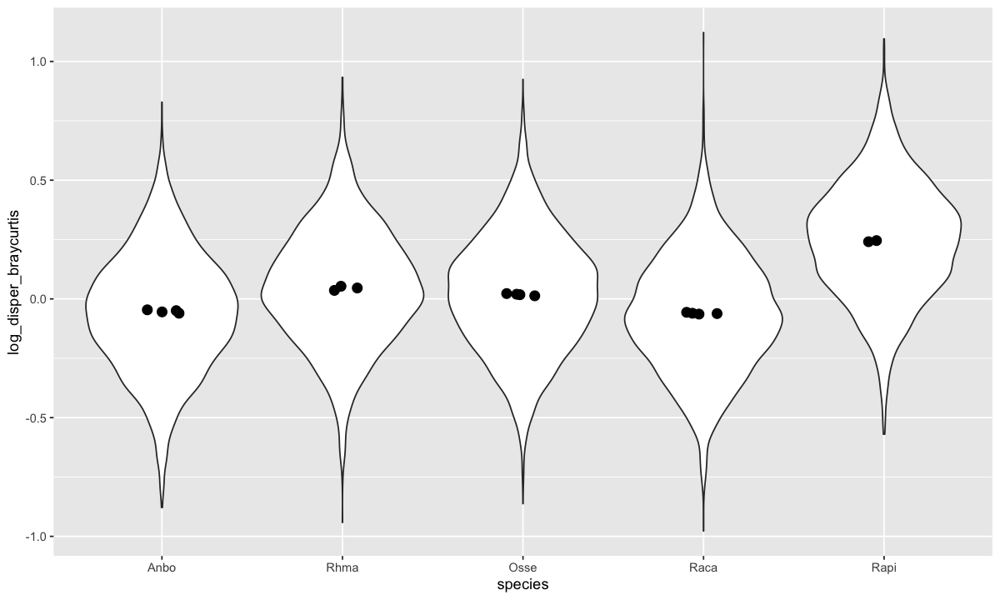

In [65]:
disper_braycurtis_processed <- process_glmer(g_lmer = lmer_disper_braycurtis
                                    , dep= "disper_braycurtis"
                                    , name_dep="log_disper_braycurtis"
                                    , transform_raw_func="log"
                                    , intercept_present=F
                                    , time_factor = T
                                    , fit_distr="normal"
                                    , mf_con=mf_con
                                    , mf_treat=mf_treat
)
disper_braycurtis_processed$gg_model_Distribution_of_all_values
disper_braycurtis_processed$gg_p
disper_braycurtis_processed$gg_ExpectedDistribution_and_Bd_exposed
disper_braycurtis_processed$gg_ExpectedDistribution_controls


### Unweighted Unifrac Dispersion 
log(u) ~ N(u_i, sigma_i)\
u_i = a_j + t_j\
a_j ~ N(u_sp, sigma_sp)\
t_j ~ N(t, sigma_t\
where i = sample, j = individual, sp = species, t = time

In [66]:
if ( RERUN_DISP ) {
  
  lmer_disper_unweighted_unifrac <- stan_lmer(log(disper_unweighted_unifrac) ~ -1 + species + (1|indivID) + time
                                      , data=mf_con
                                      , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                                      , prior = normal(location=0, scale=5, autoscale=TRUE)
                                      , seed= 29473
  )
  save(lmer_disper_unweighted_unifrac, file="./4_Bayesian_models/lmer_disper_unweighted_unifrac.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_unweighted_unifrac.RData")
}
prior_summary(lmer_disper_unweighted_unifrac)

Priors for model 'lmer_disper_unweighted_unifrac' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.03,1.03,1.03,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 4.9)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

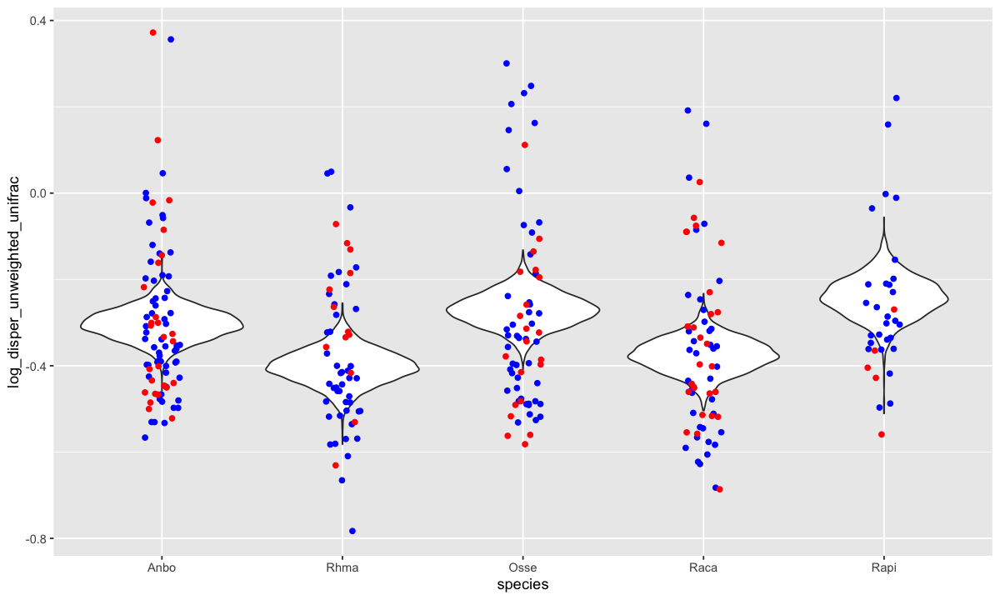

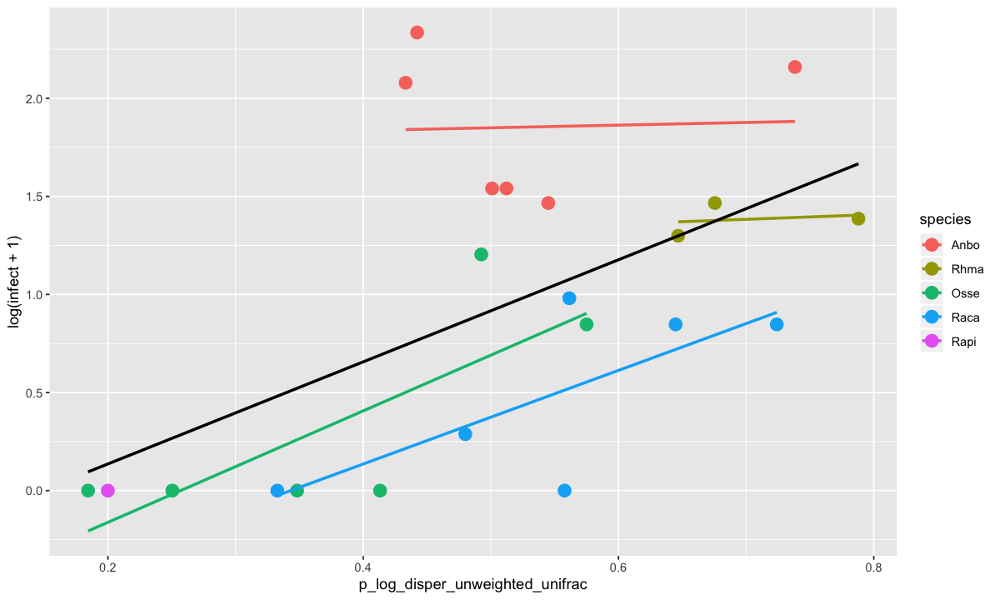

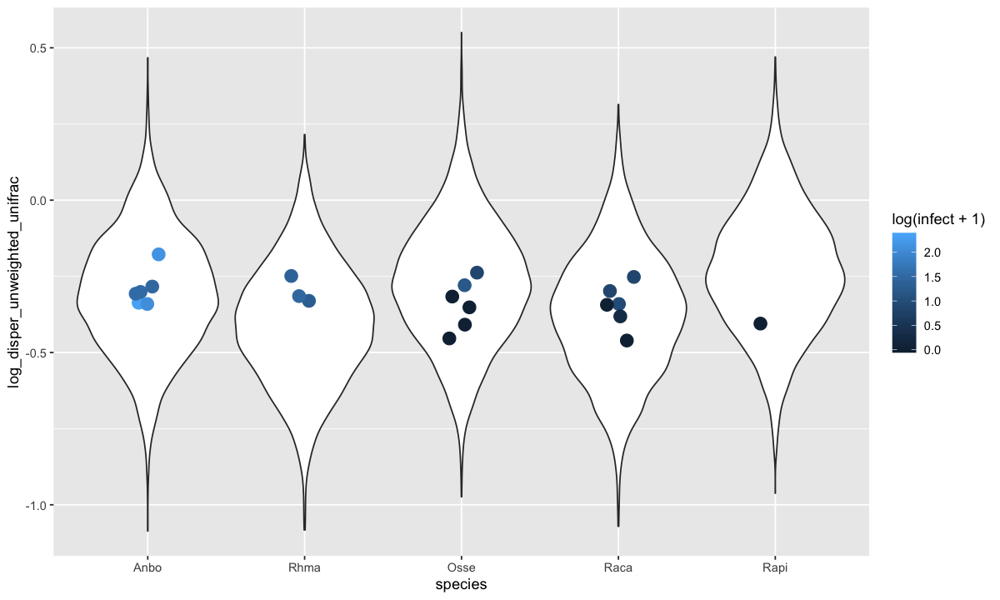

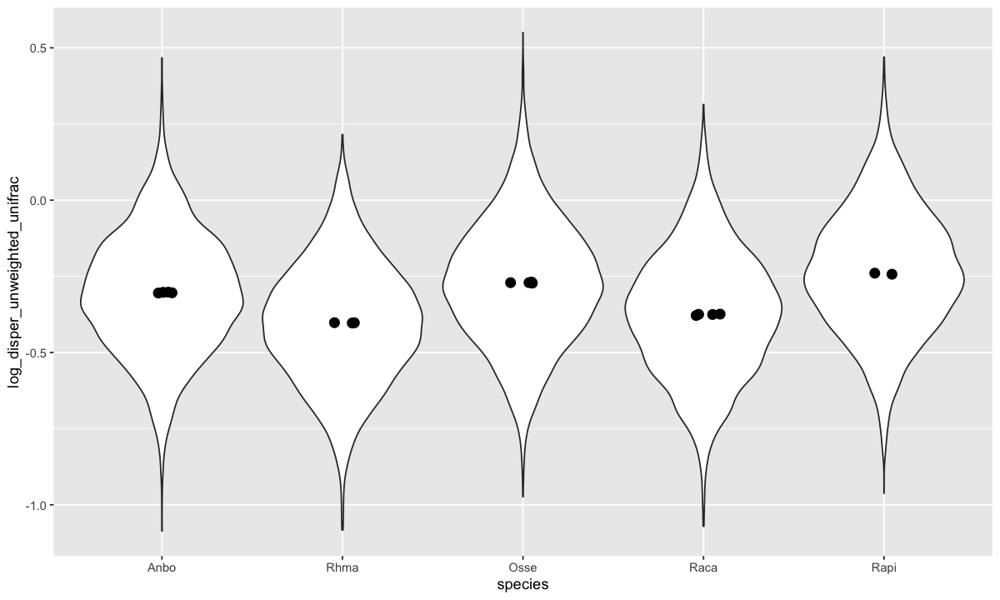

In [67]:
disper_unweighted_unifrac_processed <- process_glmer(g_lmer = lmer_disper_unweighted_unifrac
                                             , dep= "disper_unweighted_unifrac"
                                             , name_dep="log_disper_unweighted_unifrac"
                                             , transform_raw_func="log"
                                             , intercept_present=F
                                             , time_factor = T
                                             , fit_distr="normal"
                                             , mf_con=mf_con
                                             , mf_treat=mf_treat
)
disper_unweighted_unifrac_processed$gg_model_Distribution_of_all_values
disper_unweighted_unifrac_processed$gg_p
disper_unweighted_unifrac_processed$gg_ExpectedDistribution_and_Bd_exposed
disper_unweighted_unifrac_processed$gg_ExpectedDistribution_controls


### Weighted Unifrac Dispersion 
log(u) ~ N(u_i, sigma_i)\
u_i = a_j + t_j\
a_j ~ N(u_sp, sigma_sp)\
t_j ~ N(t, sigma_t\
where i = sample, j = individual, sp = species, t = time

In [68]:
if ( RERUN_DISP ) {
  
  lmer_disper_weighted_unifrac <- stan_lmer(log(disper_weighted_unifrac) ~ -1 + species + (1|indivID) + time
                                              , data=mf_con
                                              , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                                              , prior = normal(location=0, scale=5, autoscale=TRUE)
                                              , seed= 29473
  )
  save(lmer_disper_weighted_unifrac, file="./4_Bayesian_models/lmer_disper_weighted_unifrac.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_weighted_unifrac.RData")
}
prior_summary(lmer_disper_weighted_unifrac)

Priors for model 'lmer_disper_weighted_unifrac' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.86,1.86,1.86,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.7)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

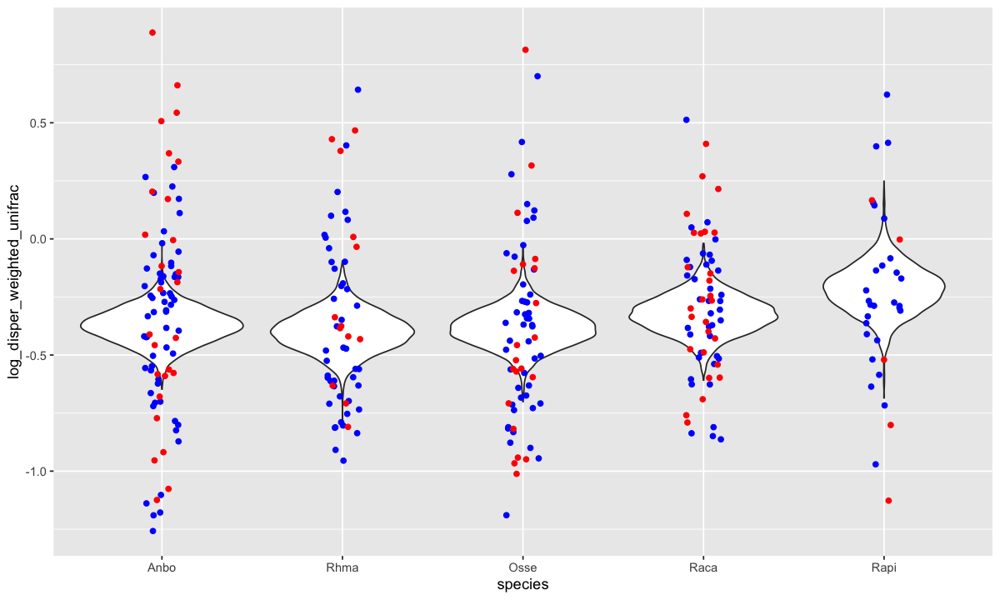

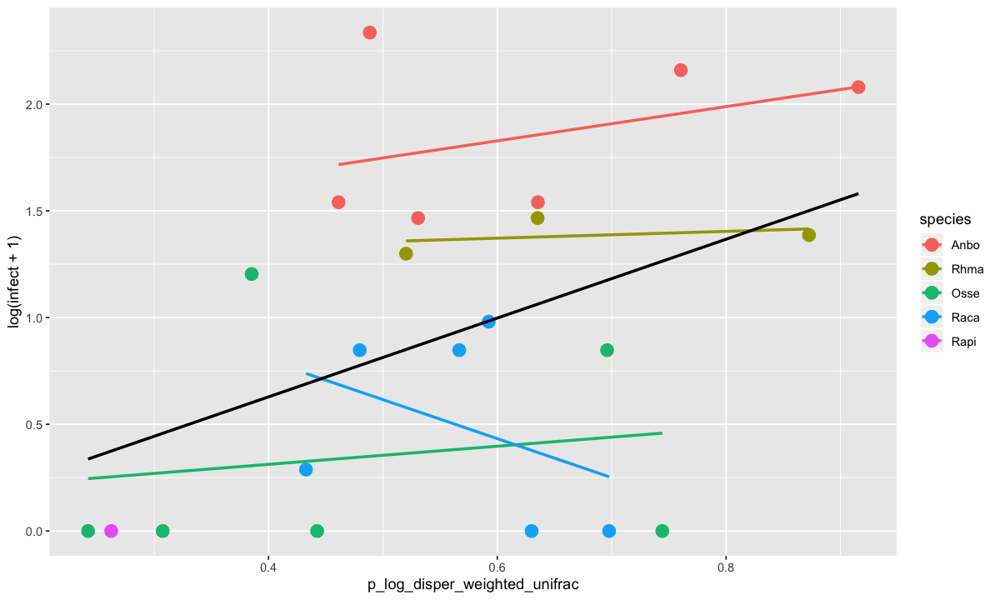

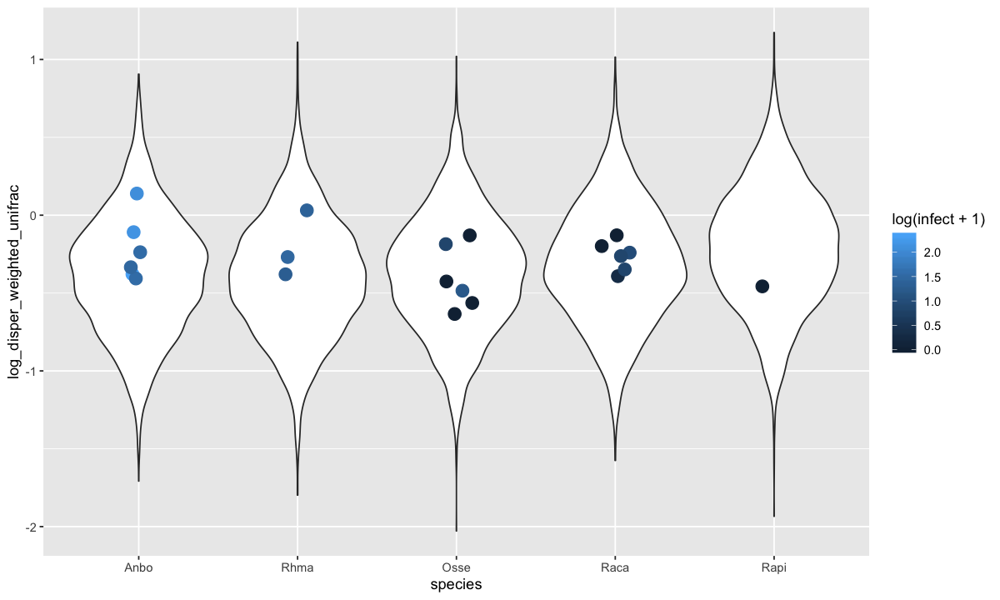

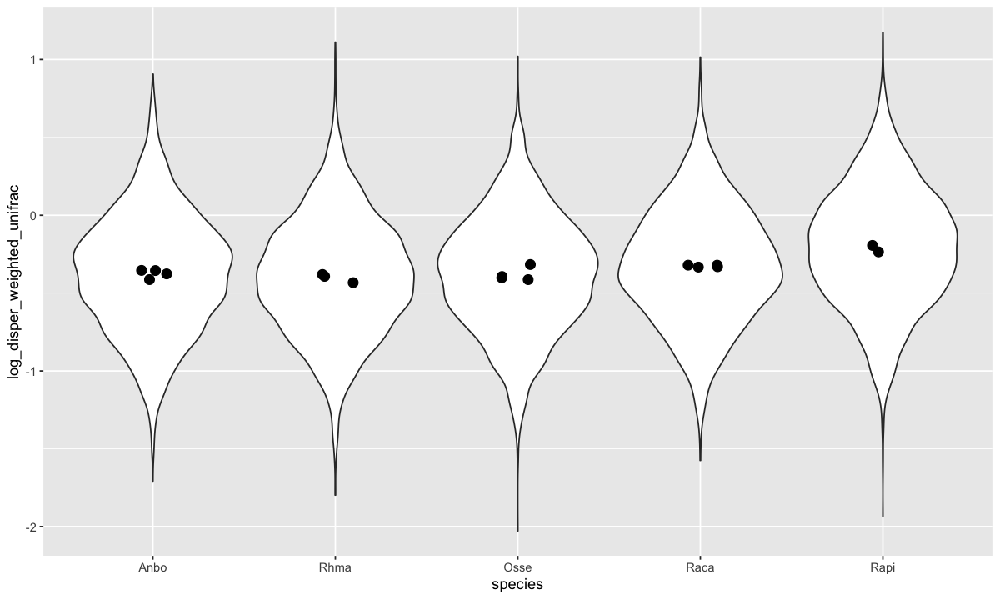

In [69]:
disper_weighted_unifrac_processed <- process_glmer(g_lmer = lmer_disper_weighted_unifrac
                                                     , dep= "disper_weighted_unifrac"
                                                     , name_dep="log_disper_weighted_unifrac"
                                                     , transform_raw_func="log"
                                                     , intercept_present=F
                                                     , time_factor = T
                                                     , fit_distr="normal"
                                                     , mf_con=mf_con
                                                     , mf_treat=mf_treat
)
disper_weighted_unifrac_processed$gg_model_Distribution_of_all_values
disper_weighted_unifrac_processed$gg_p
disper_weighted_unifrac_processed$gg_ExpectedDistribution_and_Bd_exposed
disper_weighted_unifrac_processed$gg_ExpectedDistribution_controls

### Braycurtis distance
u ~ beta(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [70]:
if ( RERUN_DIST ) {
  
  glmer_dist_braycurtis <- stan_glmer(dist_braycurtis ~ -1 + species + (1|indivID)
                           , data=mf_con
                           , family =mgcv::betar
                           , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                           , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                           , seed= 623445
  )
  save(glmer_dist_braycurtis, file="./4_Bayesian_models/glmer_dist_braycurtis.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_braycurtis.RData")
}
prior_summary(glmer_dist_braycurtis)


Priors for model 'glmer_dist_braycurtis' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 33 rows containing missing values (geom_point).”Warning message:
“Removed 25 rows containing missing values (geom_point).”

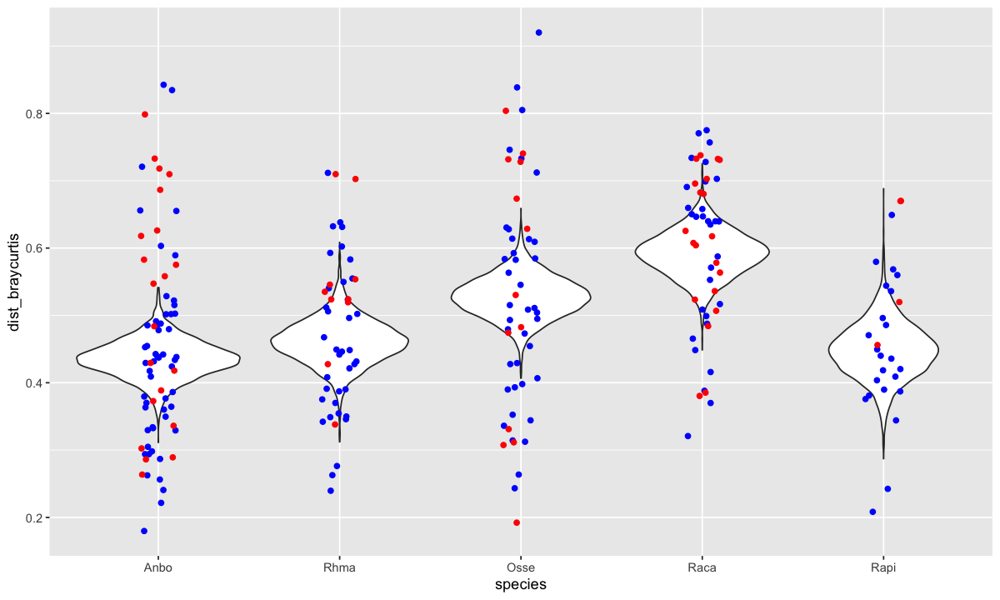

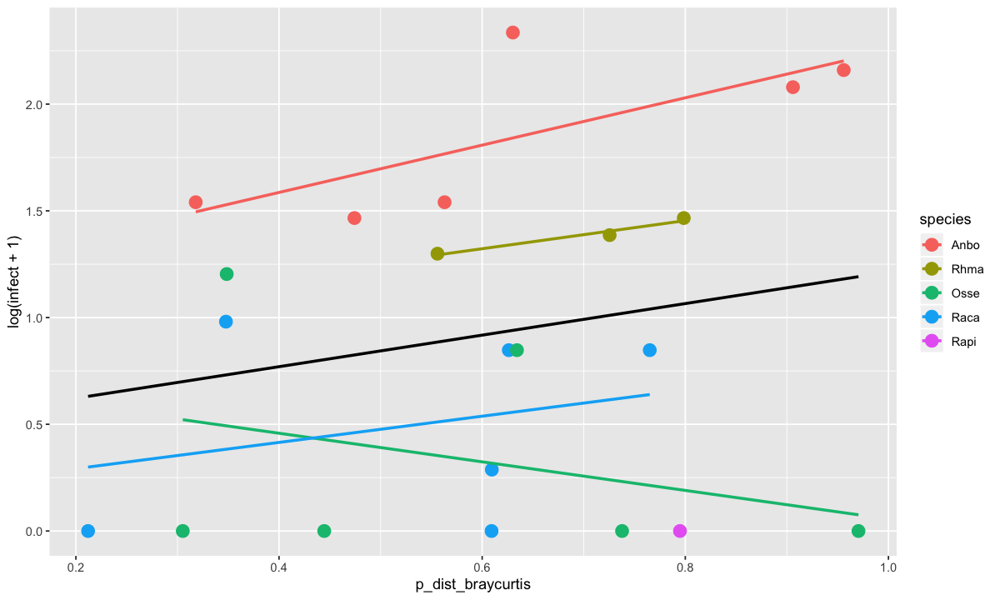

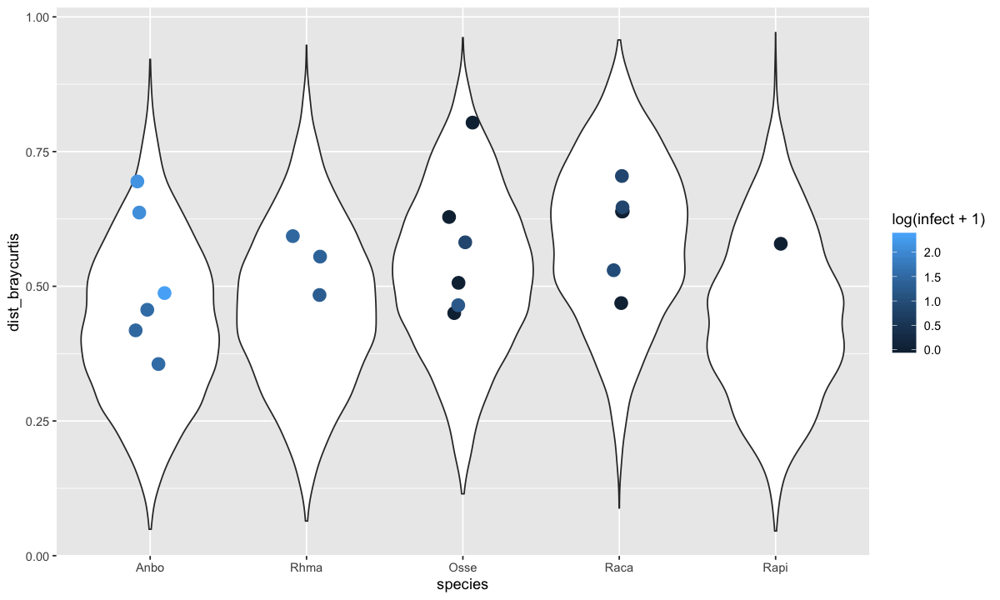

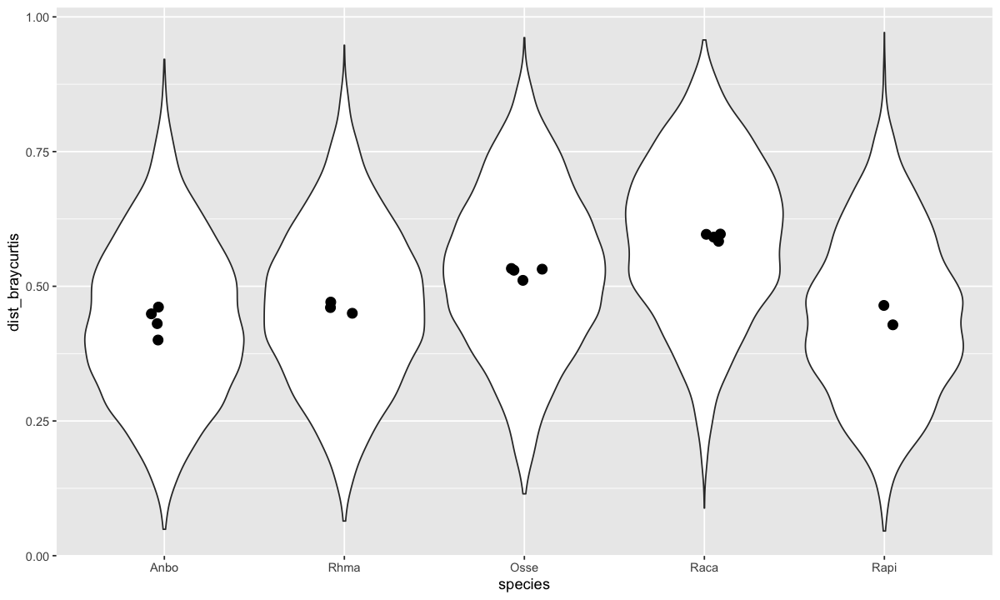

In [71]:
dist_braycurtis_processed <- process_glmer(g_lmer = glmer_dist_braycurtis
                                    , dep= "dist_braycurtis"
                                    , name_dep="dist_braycurtis"
                                    , transform_raw_func="beta"
                                    , intercept_present=F
                                    , fit_distr="Beta"
                                    , mf_con=mf_con
                                    , mf_treat=mf_treat
)

dist_braycurtis_processed$gg_model_Distribution_of_all_values
dist_braycurtis_processed$gg_p
dist_braycurtis_processed$gg_ExpectedDistribution_and_Bd_exposed
dist_braycurtis_processed$gg_ExpectedDistribution_controls


### Unweighted Unifrac distance
u ~ beta(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [72]:
if ( RERUN_DIST ) {
  
  glmer_dist_unweighted_unifrac <- stan_glmer(dist_unweighted_unifrac ~ -1 + species + (1|indivID)
                                      , data=mf_con
                                      , family =mgcv::betar
                                      , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                      , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                      , seed= 623445
  )
  save(glmer_dist_unweighted_unifrac, file="./4_Bayesian_models/glmer_dist_unweighted_unifrac.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_unweighted_unifrac.RData")
}
prior_summary(glmer_dist_unweighted_unifrac)

Priors for model 'glmer_dist_unweighted_unifrac' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 33 rows containing missing values (geom_point).”Warning message:
“Removed 25 rows containing missing values (geom_point).”

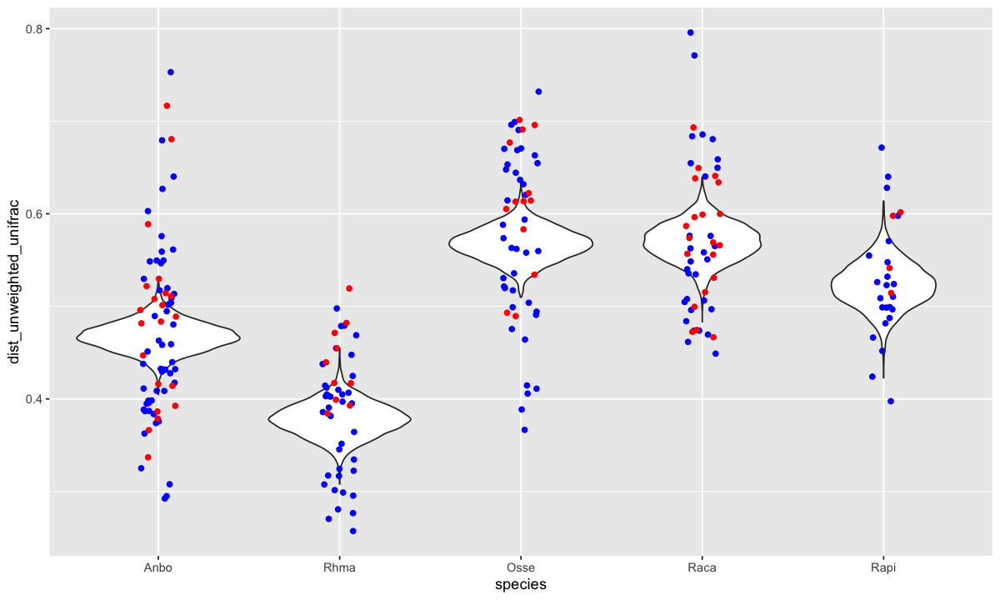

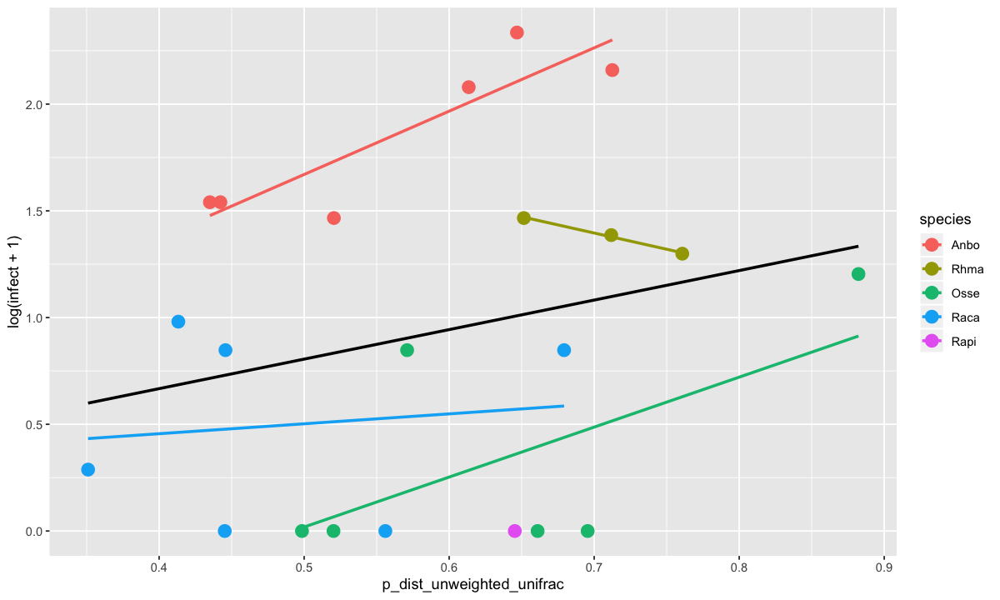

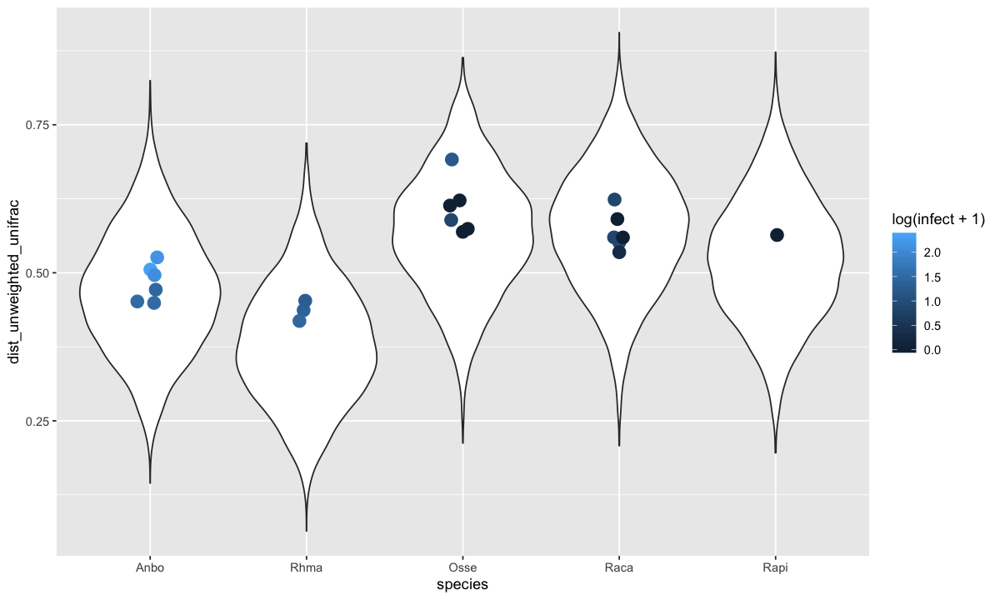

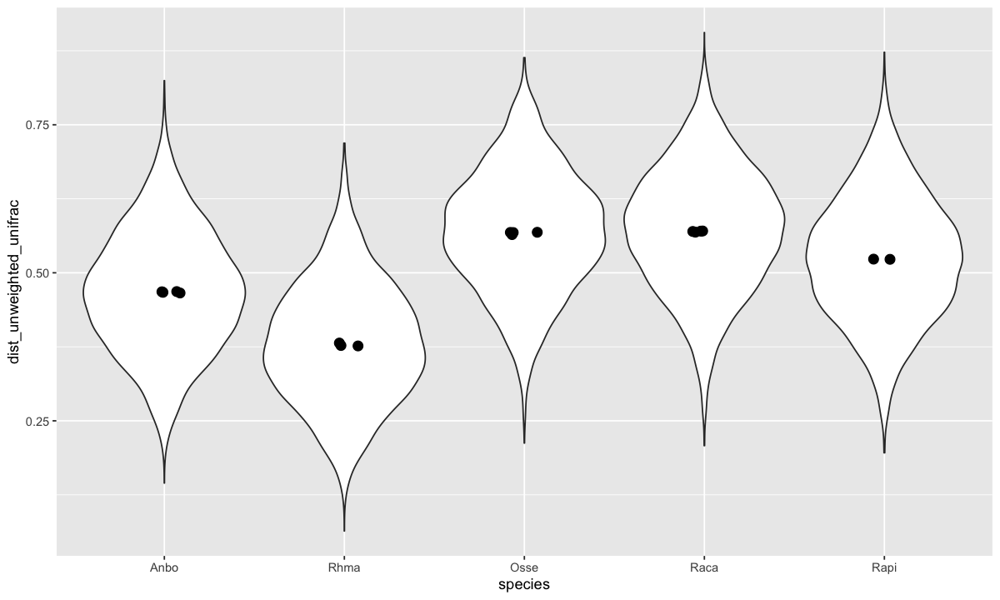

In [73]:
dist_unweighted_unifrac_processed <- process_glmer(g_lmer = glmer_dist_unweighted_unifrac
                                           , dep= "dist_unweighted_unifrac"
                                           , name_dep="dist_unweighted_unifrac"
                                           , transform_raw_func="beta"
                                           , intercept_present=F
                                           , fit_distr="Beta"
                                           , mf_con=mf_con
                                           , mf_treat=mf_treat
)

dist_unweighted_unifrac_processed$gg_model_Distribution_of_all_values
dist_unweighted_unifrac_processed$gg_p
dist_unweighted_unifrac_processed$gg_ExpectedDistribution_and_Bd_exposed
dist_unweighted_unifrac_processed$gg_ExpectedDistribution_controls

### Weighted Unifrac distance
u ~ beta(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [74]:
if ( RERUN_DIST ) {
  
  glmer_dist_weighted_unifrac <- stan_glmer(dist_weighted_unifrac ~ -1 + species + (1|indivID)
                                              , data=mf_con
                                              , family =mgcv::betar
                                              , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                              , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                              , seed= 623445
  )
  save(glmer_dist_weighted_unifrac, file="./4_Bayesian_models/glmer_dist_weighted_unifrac.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_weighted_unifrac.RData")
}
prior_summary(glmer_dist_weighted_unifrac)

Priors for model 'glmer_dist_weighted_unifrac' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 33 rows containing missing values (geom_point).”Warning message:
“Removed 25 rows containing missing values (geom_point).”

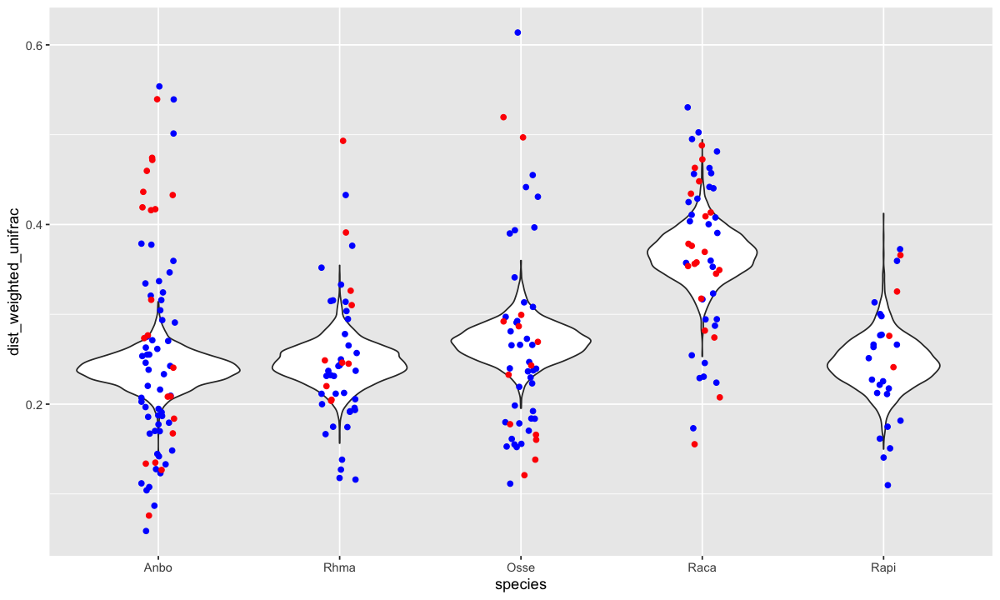

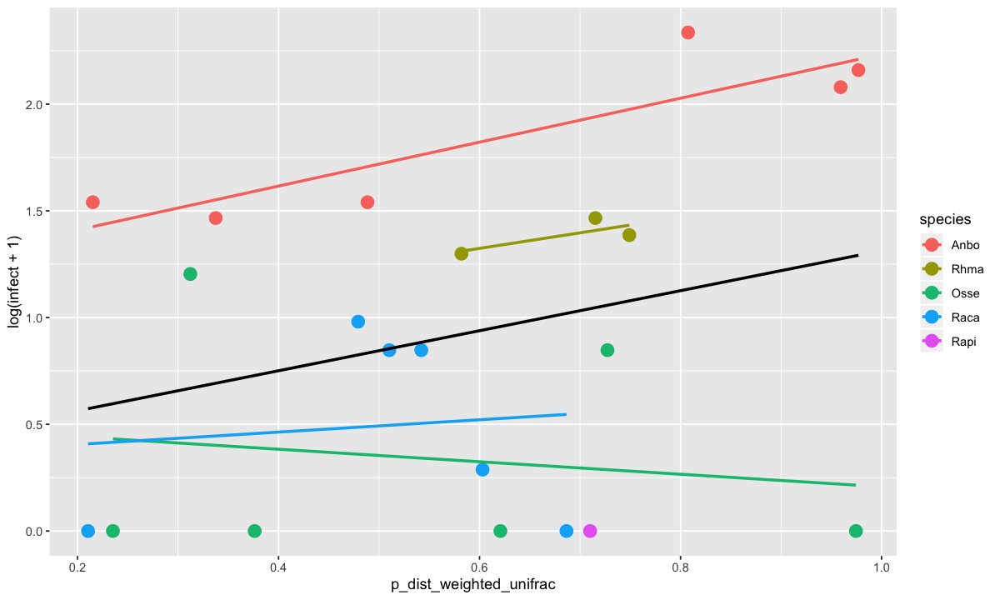

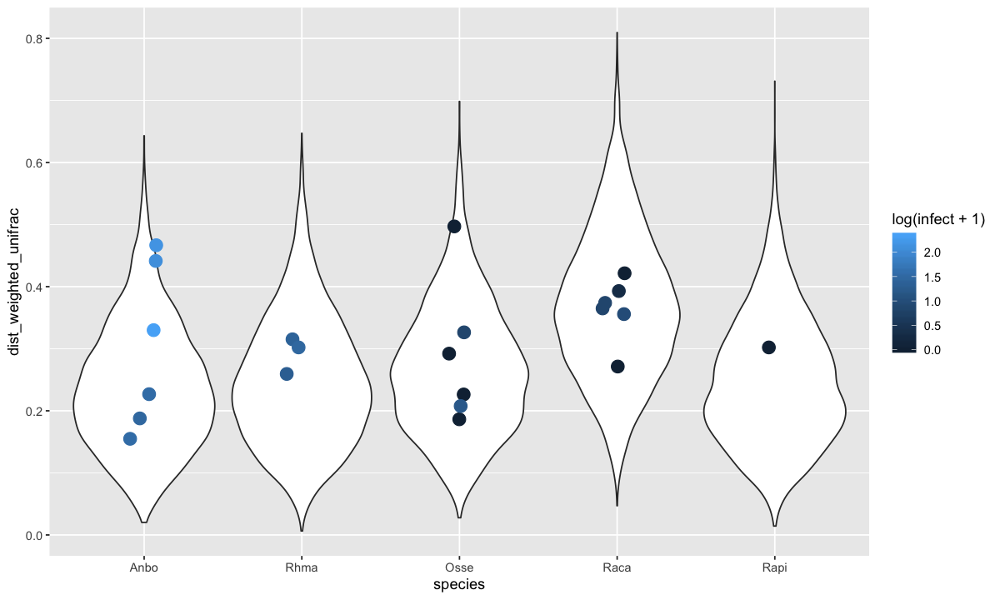

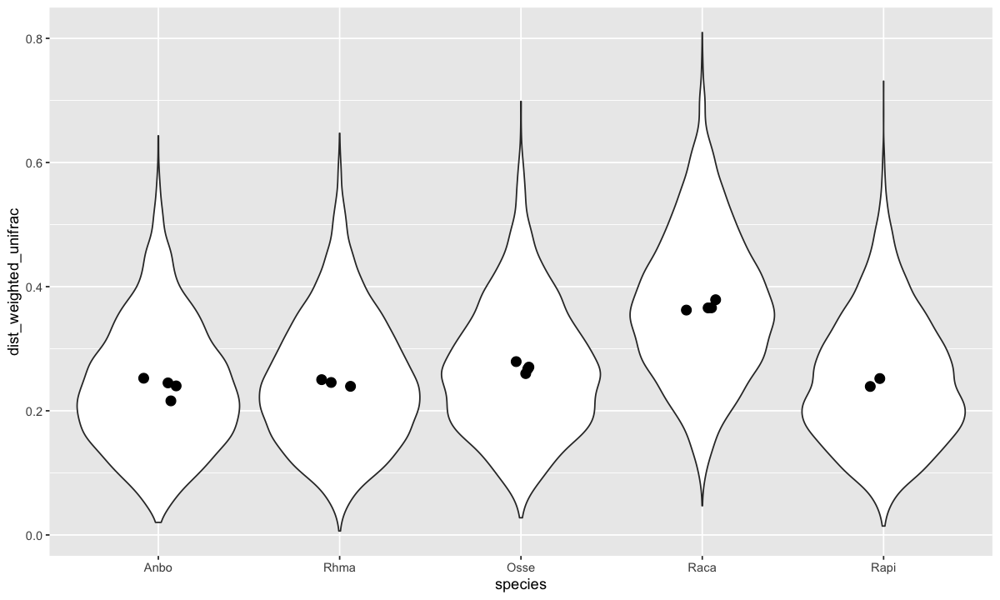

In [75]:
dist_weighted_unifrac_processed <- process_glmer(g_lmer = glmer_dist_weighted_unifrac
                                                   , dep= "dist_weighted_unifrac"
                                                   , name_dep="dist_weighted_unifrac"
                                                   , transform_raw_func="beta"
                                                   , intercept_present=F
                                                   , fit_distr="Beta"
                                                   , mf_con=mf_con
                                                   , mf_treat=mf_treat
)

dist_weighted_unifrac_processed$gg_model_Distribution_of_all_values
dist_weighted_unifrac_processed$gg_p
dist_weighted_unifrac_processed$gg_ExpectedDistribution_and_Bd_exposed
dist_weighted_unifrac_processed$gg_ExpectedDistribution_controls



### Percent Inhibitory
u ~ beta(u_i, sigma_i)\
u_i = a_j\
a_j ~ N(u_sp, sigma_sp)\
where i = sample, j = individual, sp = species

In [76]:
if ( RERUN_PERCINHIB ) {
  
  glmer_percInhib <- stan_glmer(percInhib ~ -1 + species + (1|indivID)
                                      , data=mf_con
                                      , family =mgcv::betar
                                      , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                      , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                      , seed= 59283
  )
  save(glmer_percInhib, file="./4_Bayesian_models/glmer_percInhib.RData")
} else {
  load("./4_Bayesian_models/glmer_percInhib.RData")
}
prior_summary(glmer_percInhib)

Priors for model 'glmer_percInhib' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

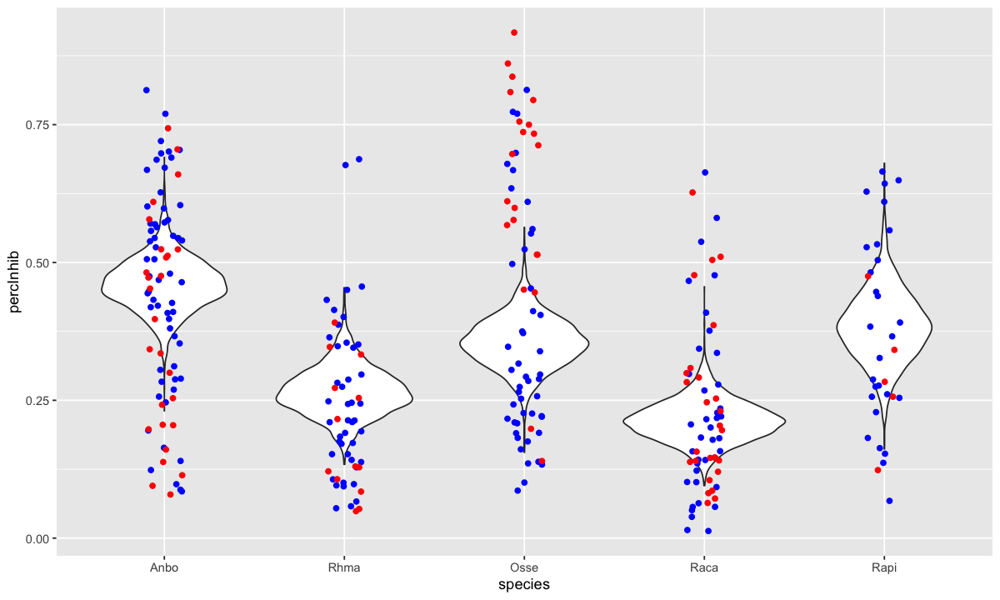

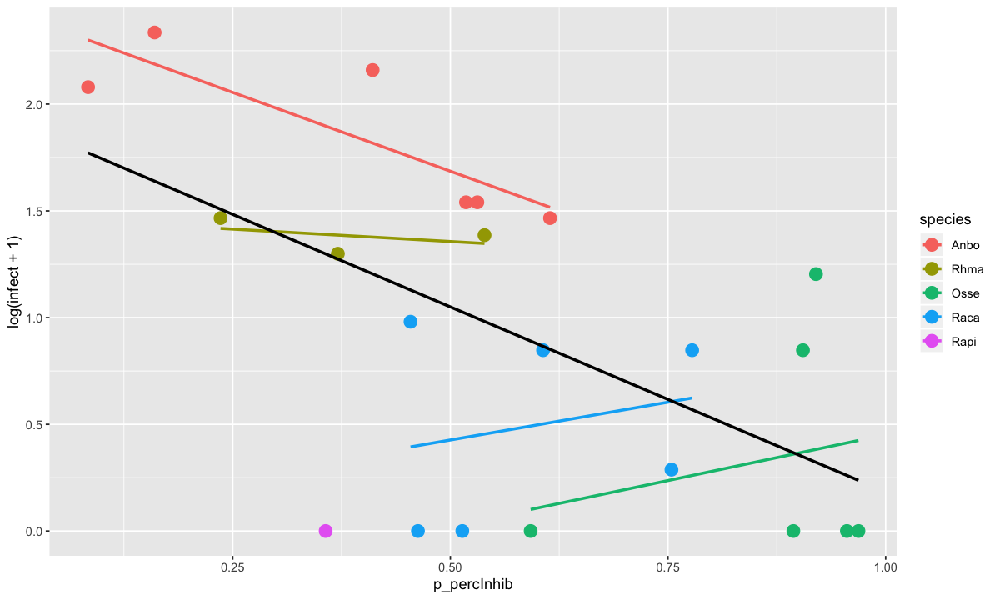

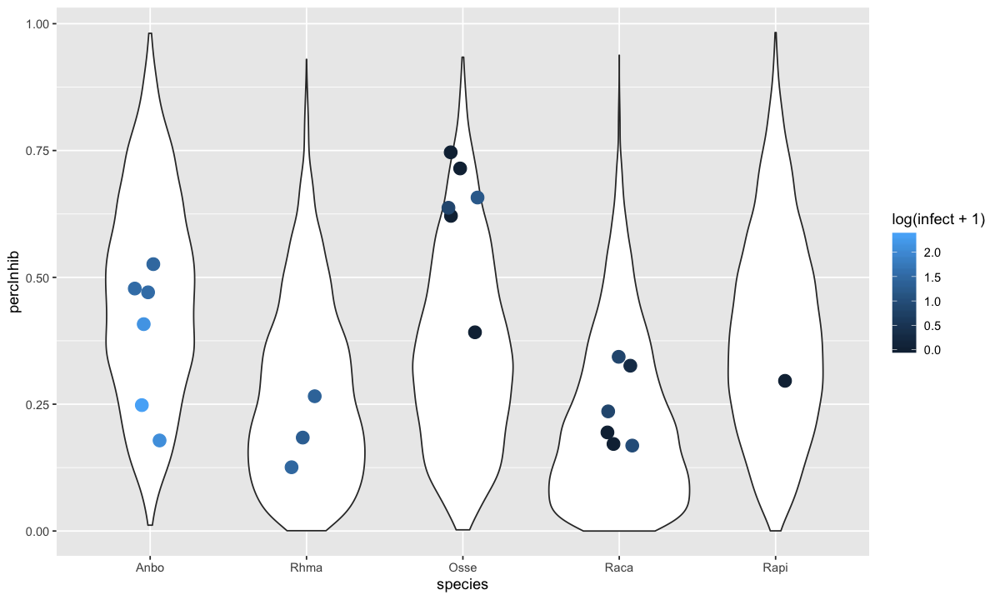

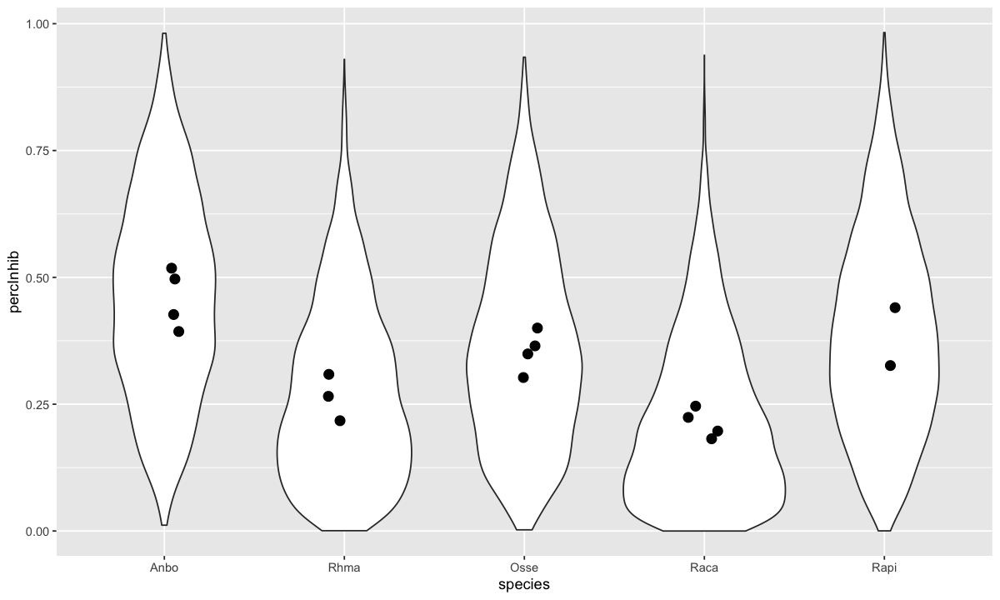

In [77]:
percInhib_processed <- process_glmer(g_lmer = glmer_percInhib
                                           , dep= "percInhib"
                                           , name_dep="percInhib"
                                           , transform_raw_func="beta"
                                           , intercept_present=F
                                           , fit_distr="Beta"
                                           , mf_con=mf_con
                                           , mf_treat=mf_treat
)

percInhib_processed$gg_model_Distribution_of_all_values
percInhib_processed$gg_p
percInhib_processed$gg_ExpectedDistribution_and_Bd_exposed
percInhib_processed$gg_ExpectedDistribution_controls

### Inhibitory Richness
u ~ pois(u_i)\
u_i = a_j + O_i + t\
a_j ~ N(u_sp, sigma_sp)\
O_i ~ N(0, sigma_i)
where i = sample, j = individual, sp = species, O = overdispersion

In [78]:
if ( RERUN_INHIBRICH ) {
  # Here, I include a random variable of sample because of over-dispersion from poisson
  glmer_inhibRich <- stan_glmer(inhibRich ~ species + (1|indivID) + (1|SampleID) + time, data=mf_con
                                    , prior = normal(0, 10, autoscale = TRUE)
                                    , family= poisson(link="identity")
                                    , seed = 5423409)
  save(glmer_inhibRich, file="./4_Bayesian_models/glmer_inhibRich.RData")
} else {
  load("./4_Bayesian_models/glmer_inhibRich.RData")
}
prior_summary(glmer_inhibRich)

Priors for model 'glmer_inhibRich' 
------
Intercept (after predictors centered)
 ~ normal(location = 0, scale = 10)

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [10.00,10.00,10.00,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.372122”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.124041”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.620204”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 10.248082”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.372122”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 12.124041”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 10.248082”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.496163”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 7.496163”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.248082”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.372122”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 4.620204”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.620

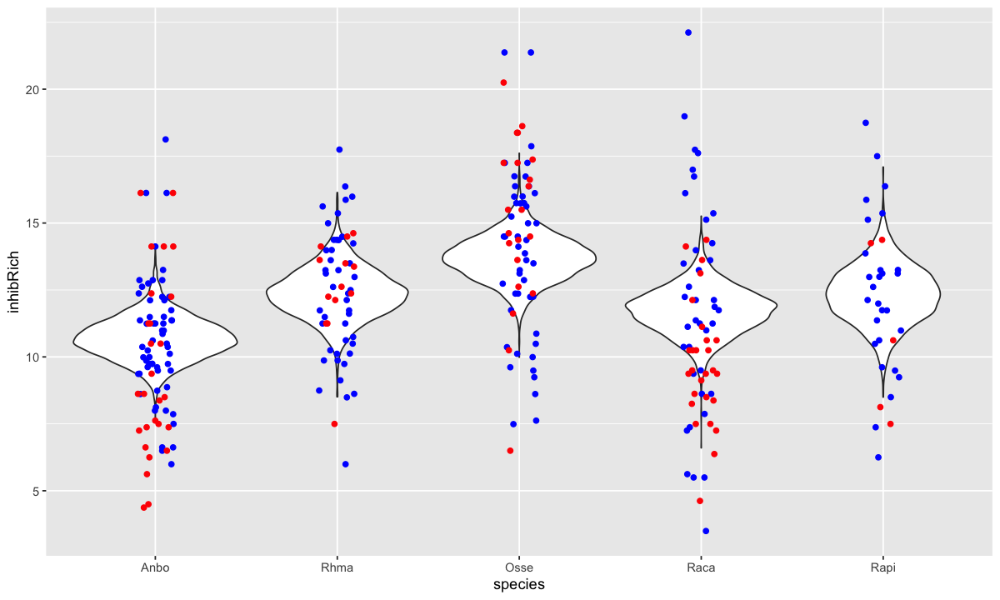

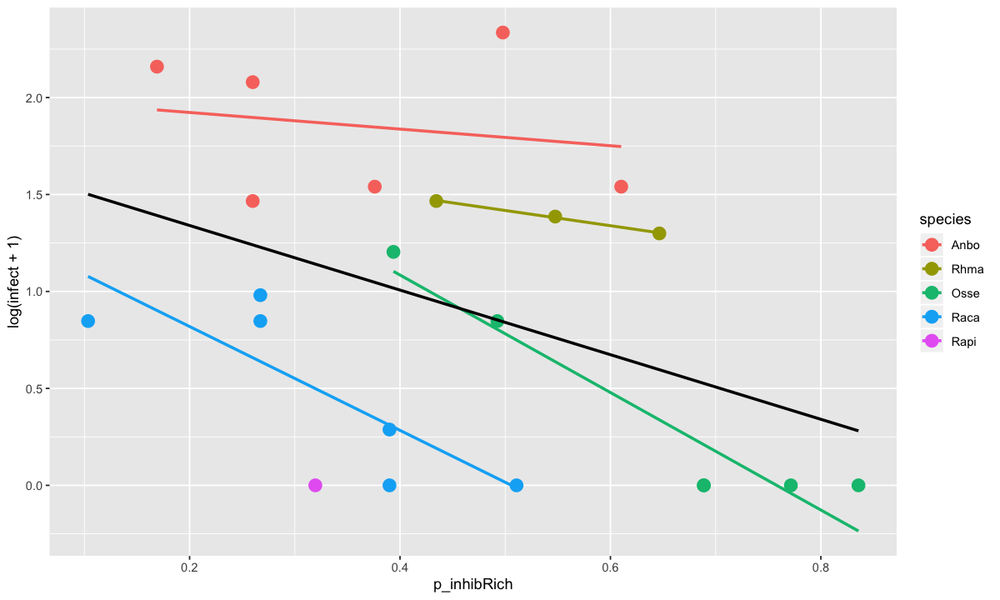

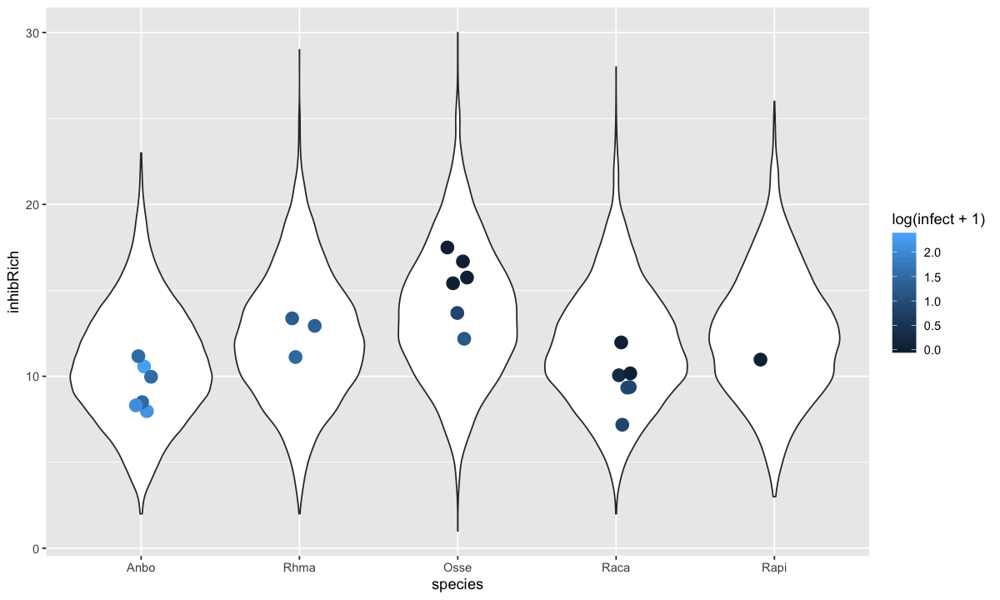

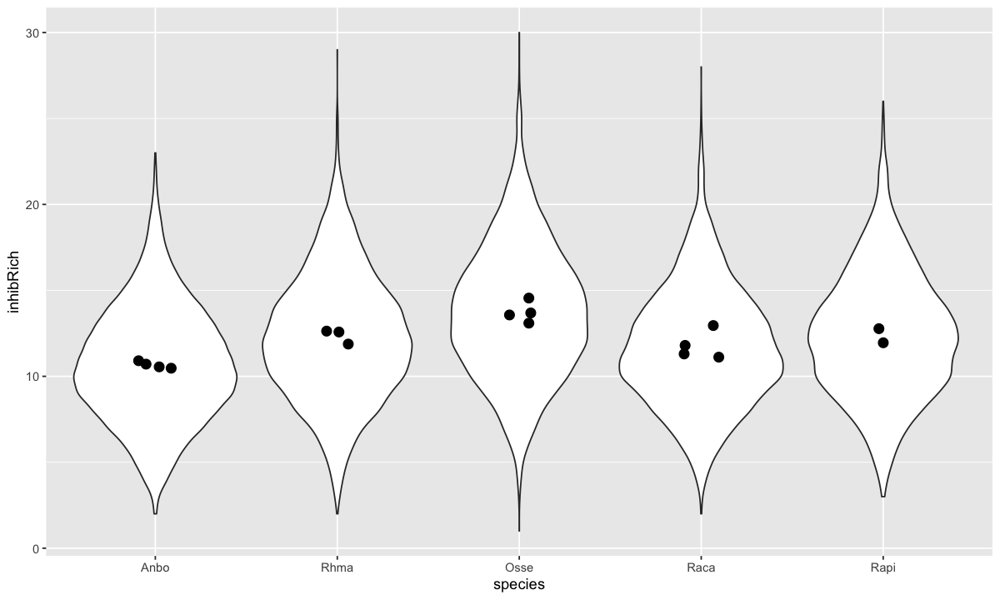

In [79]:
inhibRich_processed <- process_glmer(g_lmer = glmer_inhibRich
                                     , dep= "inhibRich"
                                     , name_dep="inhibRich"
                                     , transform_raw_func="None"
                                     , intercept_present=T
                                     , fit_distr="Poisson"
                                     , mf_con=mf_con
                                     , mf_treat=mf_treat
                                     , time_factor=T
)

inhibRich_processed$gg_model_Distribution_of_all_values
inhibRich_processed$gg_p
inhibRich_processed$gg_ExpectedDistribution_and_Bd_exposed
inhibRich_processed$gg_ExpectedDistribution_controls

### Combine info

In [80]:
# Combine all p values and save work
all_tabs <- c("observed_otus"
, "chao1"
, "shannon"
, "faith_pd"
, "disper_braycurtis"
, "disper_unweighted_unifrac"
, "disper_weighted_unifrac"
, "dist_braycurtis"
, "dist_unweighted_unifrac"
, "dist_weighted_unifrac"
, "percInhib"
, "inhibRich")
# Change names of columns so they're different
for ( tab in all_tabs) {
    temp_tab <- get(paste0(tab,"_processed"))$all_p
    name1 <- paste0("exp_",tab)
    name2 <- paste0("p_",tab)
    colnames(temp_tab) <- c("indivID",name1, name2,"infect")
    assign(paste0("all_p_",tab), temp_tab)
}
# combine all_p's
all_p <- data.frame(indivID=observed_otus_processed$all_p$indivID, infect=observed_otus_processed$all_p$infect)
for ( tab in all_tabs ) {
    all_p <- get(paste0("all_p_",tab)) %>%
    dplyr::select(indivID, paste0("exp_",tab), paste0("p_",tab)) %>%
    full_join(all_p, by="indivID")
}
save(all_p, file="./4_Bayesian_models/all_p.RData")


In [81]:
# Combine all p values from con and save work
# Change names of columns so they're different

for ( tab in all_tabs) {
    temp_tab <- get(paste0(tab,"_processed"))$Control_individuals
    name1 <- paste0("exp_",tab)
    name2 <- paste0("p_",tab)
    colnames(temp_tab) <- c("indivID","species","indiv",name1, name2)
    assign(paste0("all_p_con",tab), temp_tab)
}
# combine all_p's
all_p_con <- data.frame(indivID=observed_otus_processed$Control_individuals$indivID)
for ( tab in all_tabs ) {
    all_p_con <- get(paste0("all_p_con",tab)) %>%
    dplyr::select(indivID, paste0("exp_",tab), paste0("p_",tab)) %>%
    full_join(all_p_con, by="indivID")
}
save(all_p_con, file="./4_Bayesian_models/all_p_con.RData")

### Combine everything together

In [82]:
## Finally, combine all_p and all_p_con
all_p_temp <- all_p %>%
  mutate(Bd_exposure="Bd-exposed")
all_p_combined <- all_p_con %>%
  mutate(infect=0, Bd_exposure="Control") %>%
  rbind(all_p_temp)

save(all_p_combined, file="./4_Bayesian_models/all_p_combined.RData")

## Bayesian part II: How does infection affect microbial community?


In [83]:
# Make a mf with pre-exposure treatment individuals
mf_all_noinfect <- mf_alt_filt_final %>%
filter(!(Bd_exposure=="Bd-exposed"&prepost=="Post"))


In [84]:
process_glmer_all <- function(g_lmer, dep, name_dep, transform_raw_func, intercept_present, fit_distr, time_factor=FALSE, overdispersion=FALSE, mf_con, mf_treat) {
  
  # Need overdispersion term for poisson
 #  g_lmer = lmer_log_observed_otus_all
 #  dep= "observed_otus"
 #   name_dep="log_observed_otus"
 #   transform_raw_func="log"
 #   intercept_present=F
 # fit_distr="normal"
 #   mf_con=mf_con
 #   mf_treat=mf_treat
 #   time_factor=FALSE
 #   overdispersion=FALSE
  
  if (transform_raw_func == "log") {
    trans_func <- log
    alt_samps <- function(x) {return(x)} 
  } else if (transform_raw_func == "None") {
    trans_func <- function(x) {return(x)} 
    alt_samps <- function(x) {return(x)} 
  } else if (transform_raw_func == "beta") {
    trans_func <- function(x) {return(x)}
    a <- function(mu,phi){
      mu*phi
    }
    b <- function(mu,phi) {
      phi-mu*phi
    }
    mu <- function(a,phi) {
      a/phi
    }
    alt_samps <- function(x) {
      exp(x)/(exp(x)+1)
    }
    logit <- function(p) {
      log(p/(1-p))
    }
    mu_ab <- function(a,b) {
      a/(a+b)
    }
  } 
  
  # Alter mapping files
  mf_con_temp <- mf_con %>%
    rename(dep=paste0(dep)) %>%
    mutate(dep=trans_func(dep)) 
  mf_treat_temp <- mf_treat %>%
    rename(dep=paste0(dep)) %>%
    mutate(dep=trans_func(dep)) 
  # combine pre and post mapping files
  mf_uninfected <- mf_treat_temp %>%
    filter(time<6) %>%
    rbind(mf_con_temp)
  # Look at distributions according to models
  samps <- rstan::extract(g_lmer$stanfit)
  post_test_set <- mf_treat_temp %>%
    filter(time>=6) 
  
  # If time factor present
  if ( time_factor & intercept_present ) {
    t_var <- alt_samps(mean(samps$beta[,5]))
  } else if (time_factor) {
    t_var <- alt_samps(mean(samps$beta[,6]))
  } else {
    t_var <- 0
  }
  
  ## PLOT OF EXPECTED FOR EACH SPECIES
  if ( intercept_present ) {
    samps$beta <- samps$beta %>%
      as.data.frame() %>%
      mutate(Anbo=samps$alpha) %>%
      mutate(Rhma=alt_samps(Anbo+V1), Osse=alt_samps(Anbo+V2), Raca=alt_samps(Anbo+V3), Rapi=alt_samps(Anbo+V4)) %>%
      dplyr::select(Anbo, Rhma, Osse, Raca, Rapi) %>%
      rename(V1=Anbo, V2=Rhma, V3=Osse, V4=Raca, V5=Rapi) %>%
      as.matrix()
    gg_distr <- samps$beta %>%
      as.data.frame() %>%
      rename(Anbo=V1, Rhma=V2, Osse=V3, Raca=V4, Rapi=V5) %>%
      dplyr::select(Anbo,Rhma,Osse,Raca,Rapi) %>%
      gather(key=species, value=dependent_var) %>%
      mutate(species=factor(species, levels=c("Anbo","Rhma","Osse","Raca","Rapi"))) %>%
      ggplot(mapping=aes(x=species, y=dependent_var))+
      geom_violin() +
      geom_point(data=mf_uninfected, aes(y=dep-time*(t_var), x=species), position = position_jitter(width = 0.1, height=0), col="blue") +
      geom_point(data=post_test_set, aes(y=dep-time*(t_var), x=species), position=position_jitter(width = 0.1, height=0), col="red") +
      ylab(label=paste0(name_dep))
    
  } else {
    gg_distr <- samps$beta %>%
      as.data.frame() %>%
      rename(Anbo=V1, Rhma=V2, Osse=V3, Raca=V4, Rapi=V5) %>%
      mutate(Anbo=alt_samps(Anbo), Rhma=alt_samps(Rhma), Osse=alt_samps(Osse), Raca=alt_samps(Raca), Rapi=alt_samps(Rapi)) %>%
      dplyr::select(Anbo,Rhma,Osse,Raca,Rapi) %>%
      gather(key=species, value=depenent_var) %>%
      mutate(species=factor(species, levels=c("Anbo","Rhma","Osse","Raca","Rapi"))) %>%
      ggplot(mapping=aes(x=species, y=depenent_var))+
      geom_violin() +
      geom_point(data=mf_uninfected, aes(y=dep-time*(t_var), x=species), position = position_jitter(width = 0.1, height=0), col="blue") +
      geom_point(data=post_test_set, aes(y=dep-time*(t_var), x=species), position=position_jitter(width = 0.1, height=0), col="red") +
      ylab(label=paste0(name_dep))
    # Blue is controls, which the model is base don
    # Red is treatment individuals, which we are testing
  }
  
  ## Get standard deviation between toad individuals and samples
  ## For poisson, need to account for overdispersion
  # sd (variation) between samples
  samp_sigma <- samps$aux
  if ( overdispersion ) { 
    # sd (variation) between individuals of the same species
    randeffects_dist <- g_lmer$coefficients[grep("Intercept", names(g_lmer$coefficients))]
    names_randef <- names(randeffects_dist)
    names(randeffects_dist) <- gsub("]","",gsub("^.* indivID:", "", x=names_randef), fixed=TRUE)
    
    indiv_intercept <- data.frame(Intercept=randeffects_dist)
    indivID_sigma <- sd(samps$b[,ncol(samps$b)])
    
    # sd (variation) between samples taken (overdispersion)
    samprandeffects_dist <- g_lmer$coefficients[grep("SampleID", names(g_lmer$coefficients))]
    names_samprandef <- names(samprandeffects_dist)
    names(samprandeffects_dist) <- gsub("]","",gsub("^.* indivID:", "", x=names_samprandef), fixed=TRUE)
    
    samp_intercept <- data.frame(Intercept_SampleID=samprandeffects_dist)
    sampleID_sigma <- sd(samps$b[,nrow(samp_intercept)+1])
    # get toad_samps, which is change per toad
    # Get standard deviation between toad individuals and samples
    samp_indiv <- samps$b[,(nrow(samp_intercept)+2):(nrow(samp_intercept)+1+nrow(indiv_intercept))]
    colnames(samp_indiv) <- rownames(indiv_intercept)
    
  } else {
    # Get standard deviation between toad individuals and samples
    randeffects_dist <- g_lmer$coefficients[grep("Intercept", names(g_lmer$coefficients))]
    names_randef <- names(randeffects_dist)
    names(randeffects_dist) <- gsub("]","",gsub("^.* indivID:", "", x=names_randef), fixed=TRUE)
    
    indiv_intercept <- data.frame(Intercept=randeffects_dist)
    samp_indiv <- samps$b[,1:nrow(indiv_intercept)]
    colnames(samp_indiv) <- rownames(indiv_intercept)
    
    # sd (variation) between individuals of the same species
    indivID_sigma <- sd(samps$b[,ncol(samps$b)])
    sampleID_sigma <- 0
  }
  
  
  # Now, we can calculate the probability that the "test" dataset values come from this distribution
  # List of individuals-- including everything
  all_indiv <- unique(rbind(mf_con_temp, mf_treat_temp)$indivID)
  # List of each species
  species_list <- levels(factor(mf_con_temp$species))
  
  
  species_key <- all_indiv %>%
    as_tibble() %>%
    rename(indivID=value) %>%
    separate(indivID,into=c("species","indiv"), remove=FALSE)
  species_order <- levels(as.factor(mf_uninfected$species))
  
  exp_distr <- as.data.frame(matrix(ncol=length(all_indiv), nrow=4000, dimnames = list(1:4000, all_indiv)))
  for ( num_indiv in 1:length(all_indiv)) {
    indiv <- all_indiv[num_indiv]
    sp <- pull(species_key[num_indiv,"species"])
    num_sp <- match(sp, species_order)
    
    if ( fit_distr == "normal" ) {
      # Expected value at each species level
      exp_sp <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=indivID_sigma)
      # Expected value after "sampling"
      exp_distr[,num_indiv] <- rnorm(length(samps$beta[,num_sp]), mean=exp_sp+samp_indiv[,indiv], sd=samp_sigma)
    } else if ( fit_distr == "Gamma" ) {
      # Expected value at each species level
      exp_sp <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=indivID_sigma)
      # Expected value after "sampling"
      exp_distr[,num_indiv] <- rgamma(n=length(samps$beta[,num_sp]), shape=exp_sp+samp_indiv[,indiv], scale=1) # pretty sure default is 1
    } else if  ( fit_distr == "Beta" ) {
      
      mu <- alt_samps(rnorm(4000, mean=samps$beta[,num_sp], sd=indivID_sigma) +samp_indiv[,indiv])
      
      exp_distr[,num_indiv] <-  rbeta(length(samps$beta[,num_sp])
                                      ,shape1=a(mu,(samps$aux))
                                      ,shape2=b(mu,(samps$aux)))
      
      
    } else if ( fit_distr == "Poisson" ) {
      mu <- rnorm(length(samps$beta[,num_sp]), mean=samps$beta[,num_sp], sd=sampleID_sigma) + +samp_indiv[,indiv]
      exp_distr[,num_indiv] <- rpois(length(samps$beta[,num_sp]), lambda=mu)
      
    }
    
  }
  
  # Loop through and calculate probability of having diversity at that level
  pos_exp_indiv <- mf_treat_temp %>%
    as.data.frame() %>%
    filter(time>5, Bd_exposure=="Bd-exposed") %>%
    dplyr::select(indivID, species, Bd_load) %>%
    group_by(indivID, species) %>%
    summarize(max_Bd_load=max(Bd_load)) %>%
    mutate(p=NA, exp=NA)
  ##################### PASTED ########
  for ( i in pos_exp_indiv$indivID ) {
    #n_row <- match(i, treat_indiv)
    sp <- unlist(strsplit(i,"_"))
    num_sp <- match(sp[1], levels(factor(mf_treat_temp$species)))
    temp_dep <- mf_treat_temp %>%
      filter(indivID==i, time >5 ) %>%
      dplyr::select(dep) %>%
      pull()
    temp_time <- mf_treat_temp %>%
      filter(indivID==i, time >5 ) %>%
      dplyr::select(time) %>%
      pull()
    
    x.fit <- temp_dep-temp_time*mean(t_var)
    x.fit <- x.fit[!is.na(x.fit)]
    # I don't use a beta distribution here because often times optimization fails.
    # I think the sample size is too small to adequeately estimate shape1 and shape2?
    if ( fit_distr != "Beta" ) {
      if ( length(x.fit)>1 ) {
        fitted <- fitdistr(x.fit, densfun = paste0(fit_distr))$estimate
        if ( fit_distr!="Gamma") {
          exp <- fitted[1]
        } else {
          exp <-  fitted[1]/fitted[2]
          
        }
      } else if (length(x.fit) == 1 ) {
        exp <- x.fit
      } else {
        exp <- NA
      }
    } else {
      if ( length(x.fit)>1 ) {
        exp <-  fitdistr(x.fit, densfun = "normal")$estimate[1]
      } else if (length(x.fit) == 1) {
        exp <- (x.fit)
      } else {
        exp <- NA
      }
    }
    
    
    # pred_distr <- rnorm(length(samps_lmer_shannon$beta[,num_sp]), mean=rnorm(length(samps_lmer_shannon$beta[,num_sp]), mean=samps_lmer_shannon$beta[,num_sp], sd=toadID_sigma), sd=samp_sigma)
    p <- sum(exp_distr[,i]<exp)/length(exp_distr[,i])
    
    ### Did they get infected?
    # infect <- max(mf_treat %>%
    #                 filter(indivID==i) %>%
    #                 dplyr::select(Bd_load) %>%
    #                 pull()
    # )
    
    pos_exp_indiv[match(i, pos_exp_indiv$indivID),c("exp","p")] <- c(exp, p)
    
  }
  
  # Get all control individuals and individuals before exposure
  con_exp_indiv <- data.frame(indivID=mf_uninfected$indivID, exp=rep(NA, length(mf_uninfected$indivID)), p=rep(NA, length(mf_uninfected$indivID)), time=mf_uninfected$time)
  for ( i in 1:nrow(mf_uninfected) ) {
    indiv <- pull(mf_uninfected[i,"indivID"])
    exp <- pull(mf_uninfected[i,"dep"])-pull(mf_uninfected[i,"time"])*t_var
    
    p <- sum(exp_distr[,indiv]<exp)/length(exp_distr[,indiv])
    
    con_exp_indiv[i,c("exp","p")] <- c(exp, p)
  }
  con_exp_indiv <- con_exp_indiv %>%
    separate(indivID, into=c("species","indiv"), remove=FALSE)
  
  # Plot results 
  gg_p <- ggplot(pos_exp_indiv, aes(x=p, y=max_Bd_load)) +
    geom_point(aes(color=species), cex=4) +
    geom_smooth(aes(color=species),method=lm, se = FALSE) +
    geom_smooth(method=lm, se=FALSE, col="black") +
    xlab(label=paste0("p_",name_dep))
  # if we'd JUST plotted raw values
  gg_raw <- ggplot(pos_exp_indiv, aes(x=exp, y=max_Bd_load))+
    geom_point(aes(color=species), cex=4) +
    geom_smooth(method=lm, se=FALSE, col="black") +
    geom_smooth(aes(color=species),method=lm, se = FALSE) +
    xlab(label=paste0("exp_",name_dep))
  #grid.arrange(gg_p, gg_raw, nrow=1)
  
  gg_exp_distr <- exp_distr %>%
    # add time adjustment to raw data values
    gather(key=indivID, value=dep_var) %>%
    separate(indivID, into=c("species","indiv"), remove=FALSE) %>%
    mutate(species=factor(species,levels=c("Anbo","Rhma","Osse","Raca","Rapi")))%>%
    ggplot(aes(x=species, y=dep_var)) +
    geom_violin() +
    geom_point(data=pos_exp_indiv, aes(x=species, y=exp, col=max_Bd_load),  cex=2, position=position_jitter(height=0, width=0.1)) +
    ylab(label=paste0(name_dep))
  
  gg_exp_distr_controls <- exp_distr %>%
    # add time adjustment to raw data values
    gather(key=indivID, value=dep_var) %>%
    separate(indivID, into=c("species","indiv"), remove=FALSE) %>%
    mutate(species=factor(species,levels=c("Anbo","Rhma","Osse","Raca","Rapi")))%>%
    ggplot(aes(x=species, y=dep_var)) +
    geom_violin() +
    geom_point(data=con_exp_indiv, aes(x=species, y=exp),  cex=2, position=position_jitter(height=0, width=0.1)) +
    ylab(label=paste0(name_dep))
  
  all_p <- pos_exp_indiv %>%
    rename(infect=max_Bd_load) %>%
    dplyr::select(indivID, exp, p, infect) 
  
  # Make list of items
  output <- list()
  output[["Var"]] <- data.frame( dep=dep, name_dep=name_dep
                                 , transform_raw_func=transform_raw_func
                                 , intercept_present=intercept_present
                                 ,fit_distr=fit_distr)
  output[["gg_model_Distribution_of_all_values"]] <- gg_distr
  output[["gg_p"]] <- gg_p
  output[["gg_raw"]] <- gg_raw
  output[["gg_ExpectedDistribution_and_Bd_exposed"]] <- gg_exp_distr
  output[["gg_ExpectedDistribution_controls"]] <- gg_exp_distr_controls
  output[["all_p"]] <- all_p
  
  return(output)
}

### Observed otus

In [85]:
##### RICHNESS (observed otus) (II) #######
# There was no effect of time
if ( RERUN_RICH ) {
  lmer_log_observed_otus_all <- stan_lmer(log(observed_otus) ~ -1 + species + (1|indivID), data=mf_all_noinfect
                                      , prior = normal(0, 10, autoscale = TRUE)
                                      #, family = gaussian(link="log")
                                      , seed = 298473
                                      , adapt_delta = 0.999
                                      
  )
  save(lmer_log_observed_otus_all, file="./4_Bayesian_models/lmer_log_observed_otus_all.RData")
} else {
  load("./4_Bayesian_models/lmer_log_observed_otus_all.RData")
}
prior_summary(lmer_log_observed_otus_all)


Priors for model 'lmer_log_observed_otus_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [3.72,3.72,3.72,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.7)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

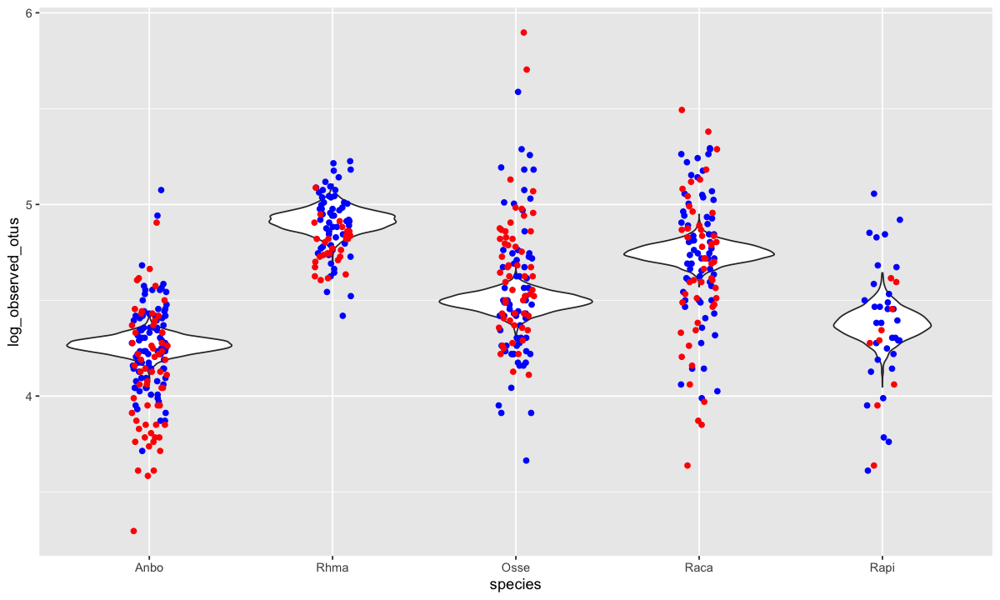

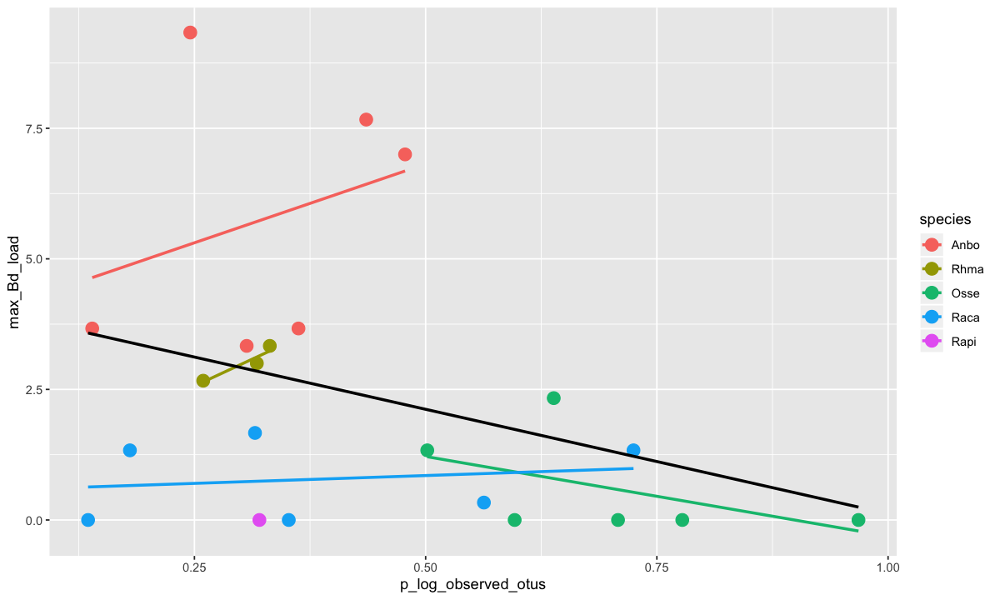

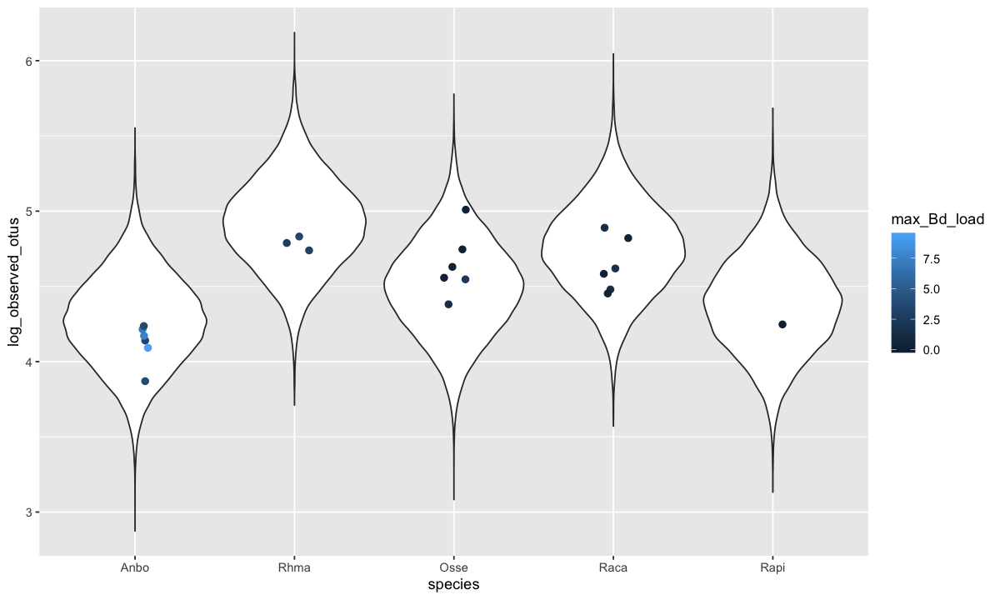

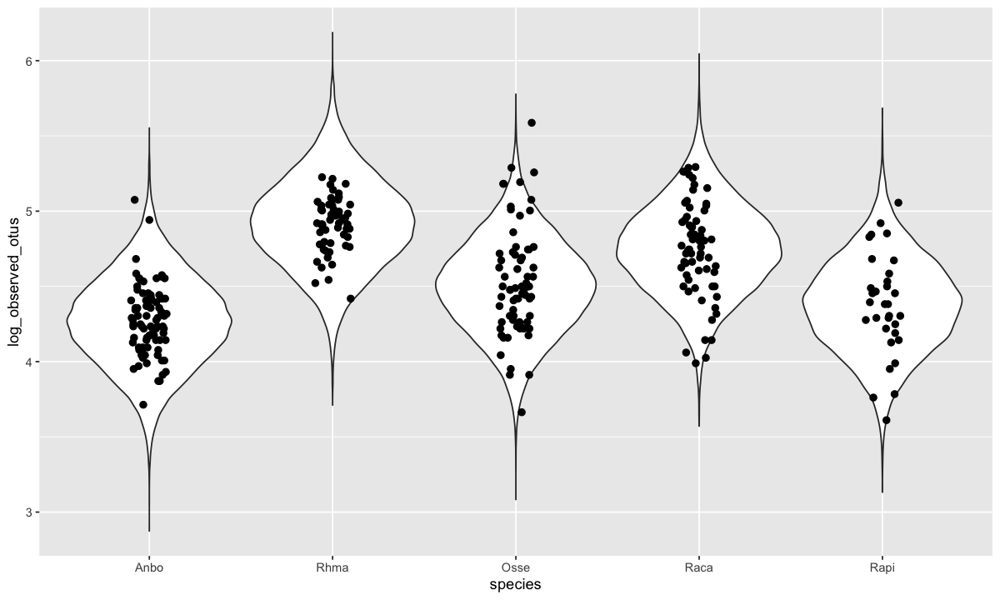

In [86]:
observed_otus_processed_all <- process_glmer_all(g_lmer = lmer_log_observed_otus_all
                                         , dep= "observed_otus"
                                         , name_dep="log_observed_otus"
                                         , transform_raw_func="log"
                                         , intercept_present=F
                                         , fit_distr="normal"
                                         , mf_con=mf_con
                                         , mf_treat=mf_treat)
observed_otus_processed_all$gg_model_Distribution_of_all_values
observed_otus_processed_all$gg_p
observed_otus_processed_all$gg_ExpectedDistribution_and_Bd_exposed
observed_otus_processed_all$gg_ExpectedDistribution_controls


### Chao1

In [87]:
##### RICHNESS (Chao1) (II) #######

if ( RERUN_RICH ) {
  
  lmer_log_chao1_all <- stan_lmer(log(chao1) ~ -1 + species + (1|indivID), data=mf_all_noinfect
                              , prior = normal(0, 10, autoscale = TRUE)
                              #, family = gaussian(link="log")
                              , seed = 5793482
                              , adapt_delta = 0.999
                              
  )
  save(lmer_log_chao1_all, file="./4_Bayesian_models/lmer_log_chao1_all.RData")
} else {
  load("./4_Bayesian_models/lmer_log_chao1_all.RData")
}
prior_summary(lmer_log_chao1_all)


Priors for model 'lmer_log_chao1_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [4.06,4.06,4.06,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.5)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

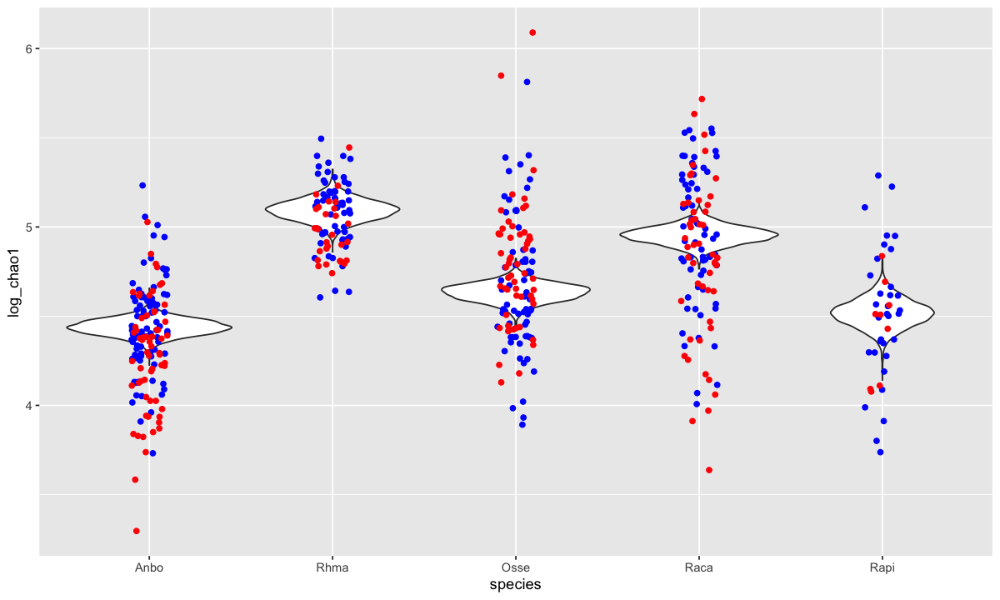

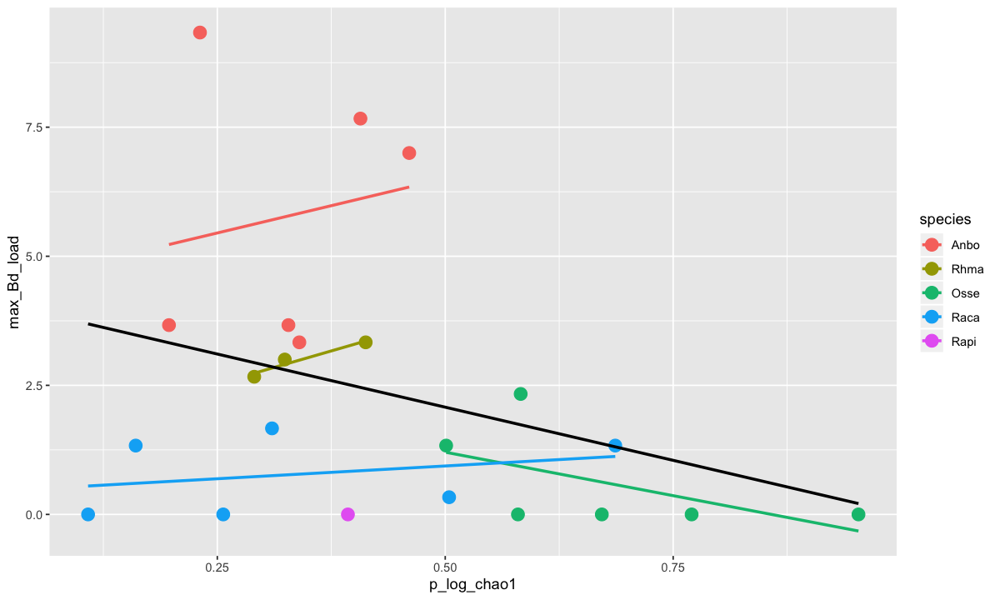

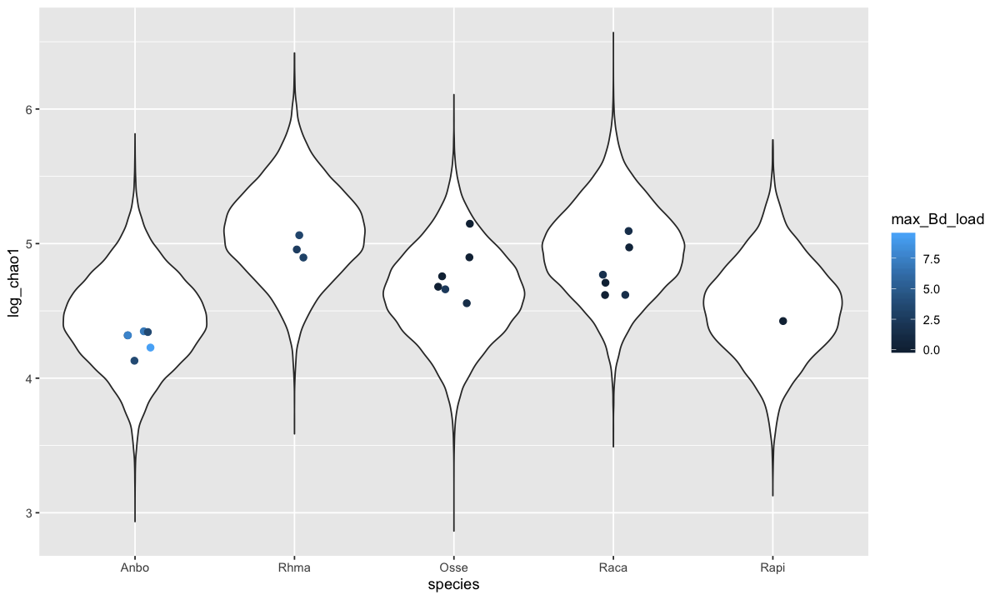

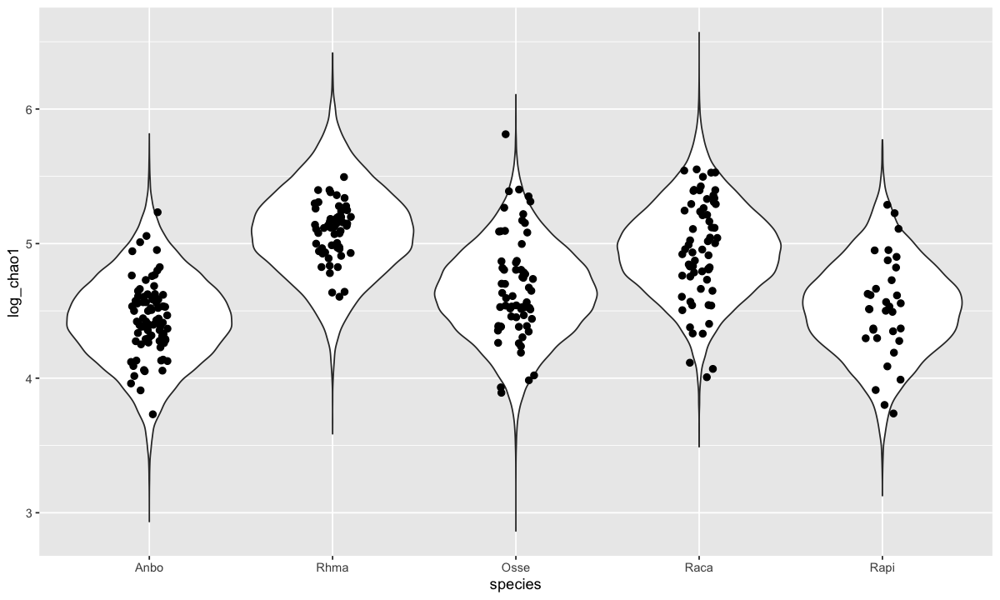

In [88]:
chao1_processed_all <- process_glmer_all(g_lmer = lmer_log_chao1_all
                                 , dep= "chao1"
                                 , name_dep="log_chao1"
                                 , transform_raw_func="log"
                                 , intercept_present=F
                                 , fit_distr="normal"
                                 , mf_con=mf_con
                                 , mf_treat=mf_treat)
chao1_processed_all$gg_model_Distribution_of_all_values
chao1_processed_all$gg_p
chao1_processed_all$gg_ExpectedDistribution_and_Bd_exposed
chao1_processed_all$gg_ExpectedDistribution_controls


### Shannon

In [89]:
##### DIVERSITY (Shannon) (II) #######

if ( RERUN_RICH ) {
  
  lmer_shannon_all <- stan_lmer(shannon ~ -1 + species + (1|indivID), data=mf_all_noinfect
                            , prior = normal(0, 10, autoscale = TRUE)
                            , seed = 5793482
                            , adapt_delta = 0.999
                            
  )
  save(lmer_shannon_all, file="./4_Bayesian_models/lmer_shannon_all.RData")
} else {
  load("./4_Bayesian_models/lmer_shannon_all.RData")
}
prior_summary(lmer_shannon_all)


Priors for model 'lmer_shannon_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [7.55,7.55,7.55,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 1.3)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

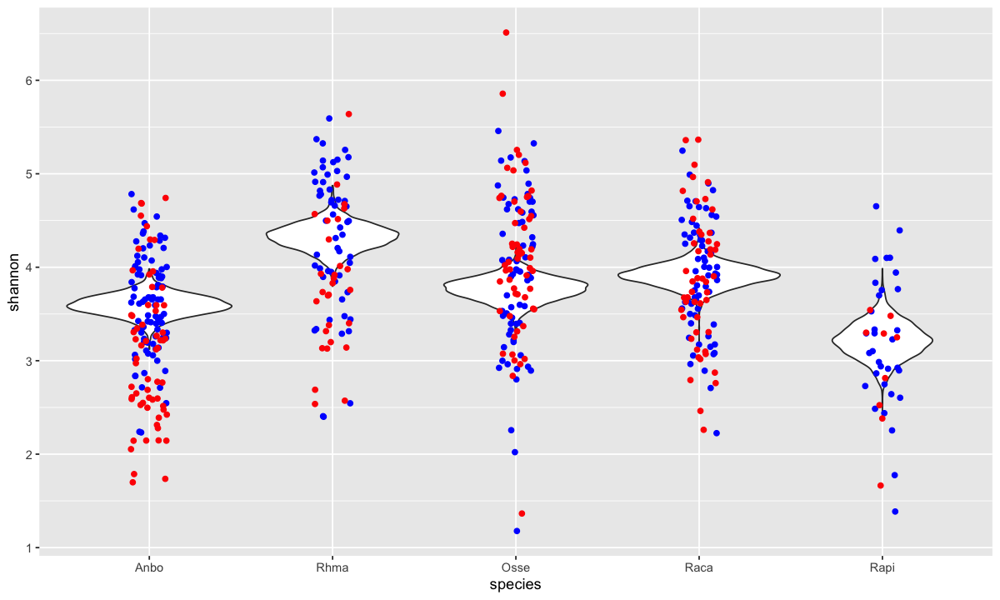

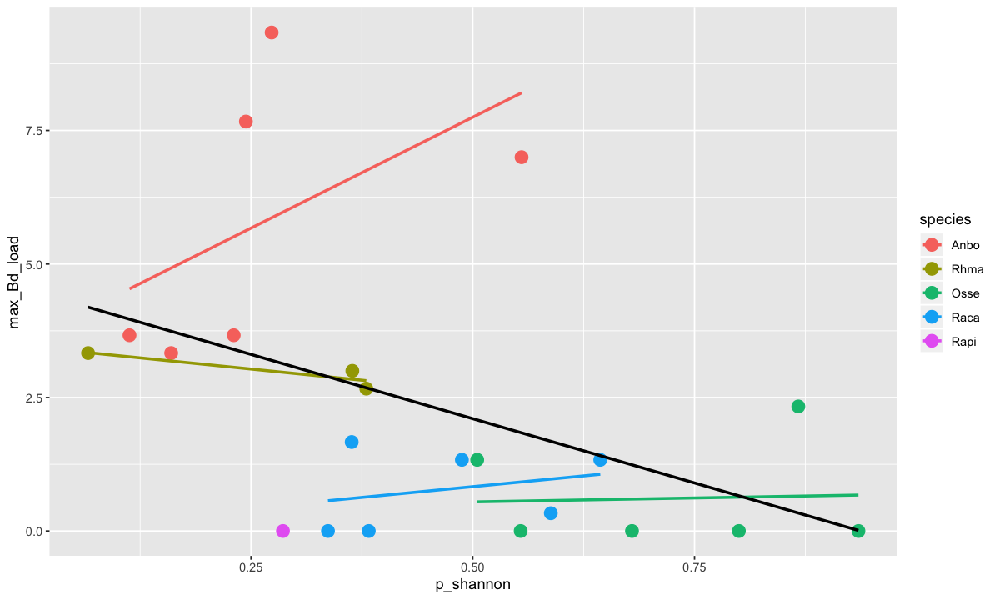

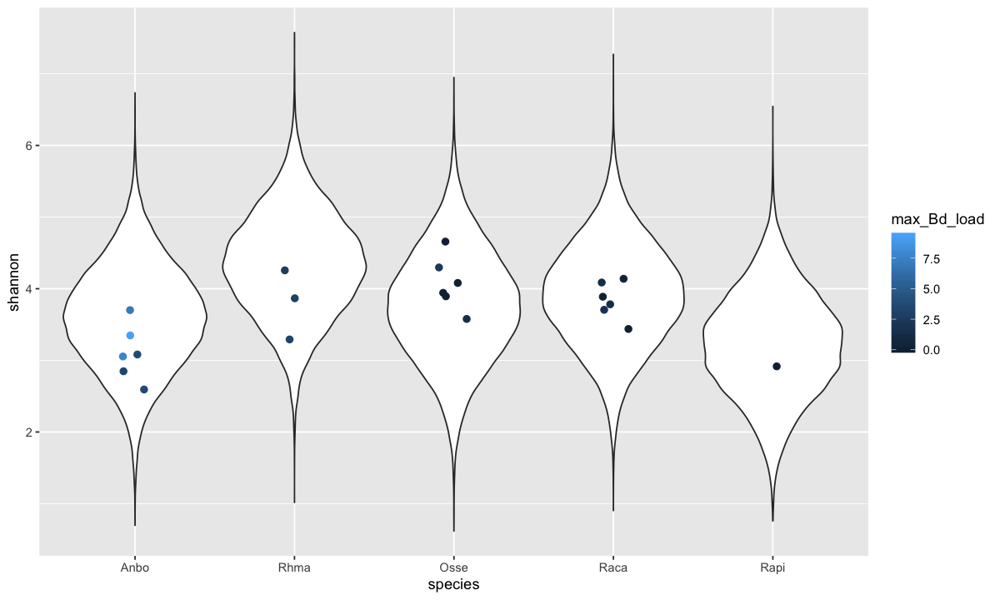

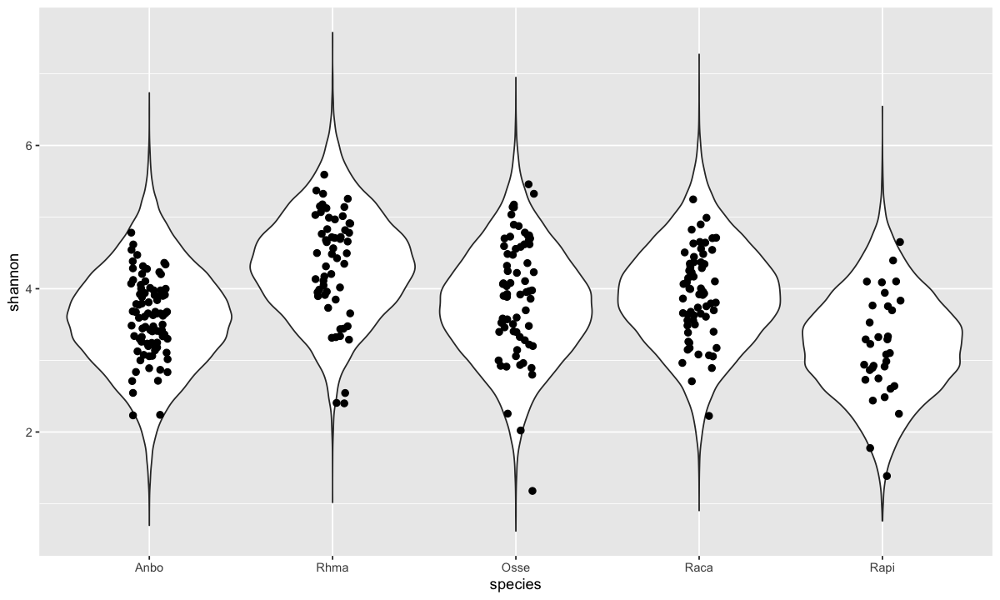

In [90]:
shannon_processed_all <- process_glmer_all(g_lmer = lmer_shannon_all
                                   , dep= "shannon"
                                   , name_dep="shannon"
                                   , transform_raw_func="None"
                                   , intercept_present=F
                                   , fit_distr="normal"
                                   , mf_con=mf_con
                                   , mf_treat=mf_treat)
shannon_processed_all$gg_model_Distribution_of_all_values
shannon_processed_all$gg_p
shannon_processed_all$gg_ExpectedDistribution_and_Bd_exposed
shannon_processed_all$gg_ExpectedDistribution_controls

### Faith's PD

In [91]:
##### DIVERSITY (Faith's PD) (II) #######

if ( RERUN_RICH ) {
  
  glmer_faith_pd_all <- stan_glmer(faith_pd ~ species + (1|indivID), data=mf_all_noinfect
                               , prior = normal(0, 10, autoscale = TRUE)
                               , seed = 5793482
                               , family=Gamma(link="identity")
                               , adapt_delta = 0.999
                               
  )
  save(glmer_faith_pd_all, file="./4_Bayesian_models/glmer_faith_pd_all.RData")
} else {
  load("./4_Bayesian_models/glmer_faith_pd_all.RData")
}
prior_summary(glmer_faith_pd_all)

Priors for model 'glmer_faith_pd_all' 
------
Intercept (after predictors centered)
 ~ normal(location = 0, scale = 10)

Coefficients
 ~ normal(location = [0,0,0,...], scale = [10,10,10,...])

Auxiliary (shape)
 ~ exponential(rate = 1)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

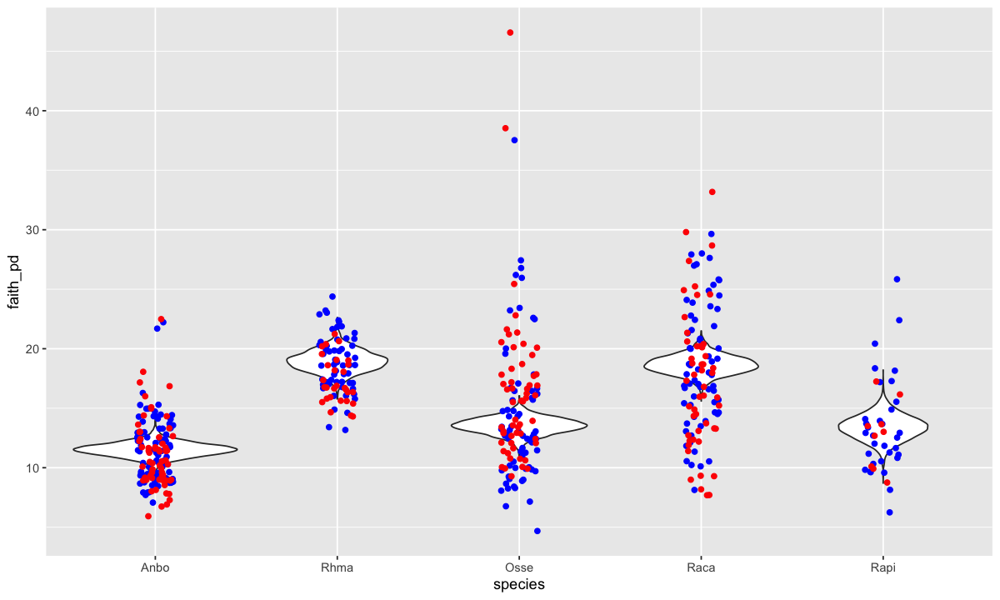

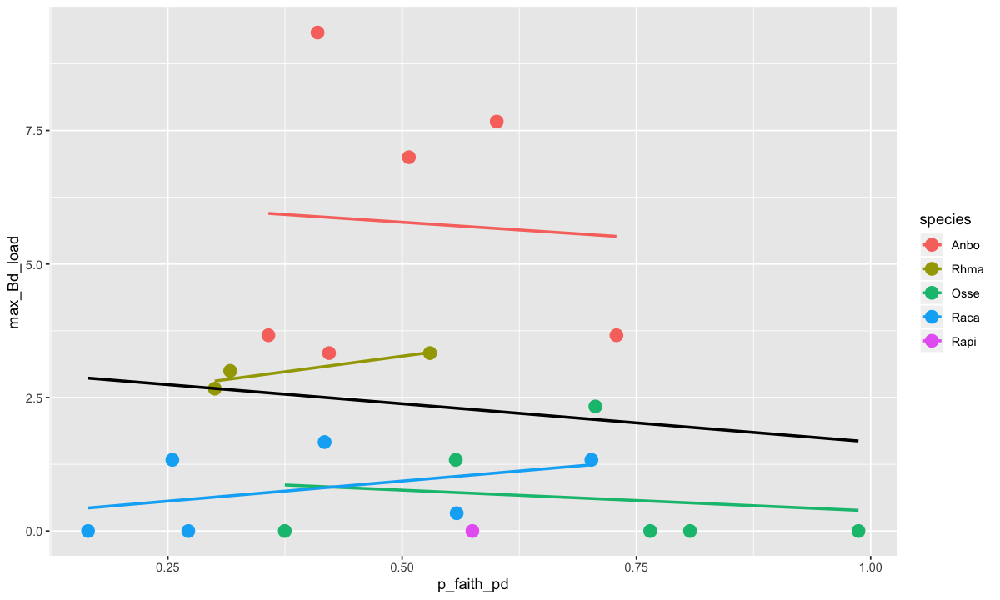

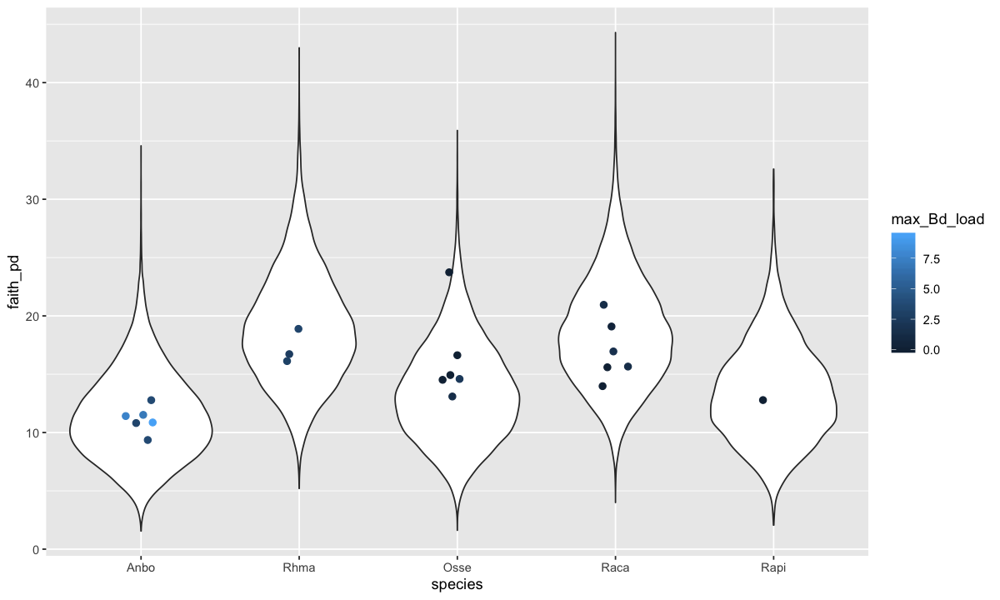

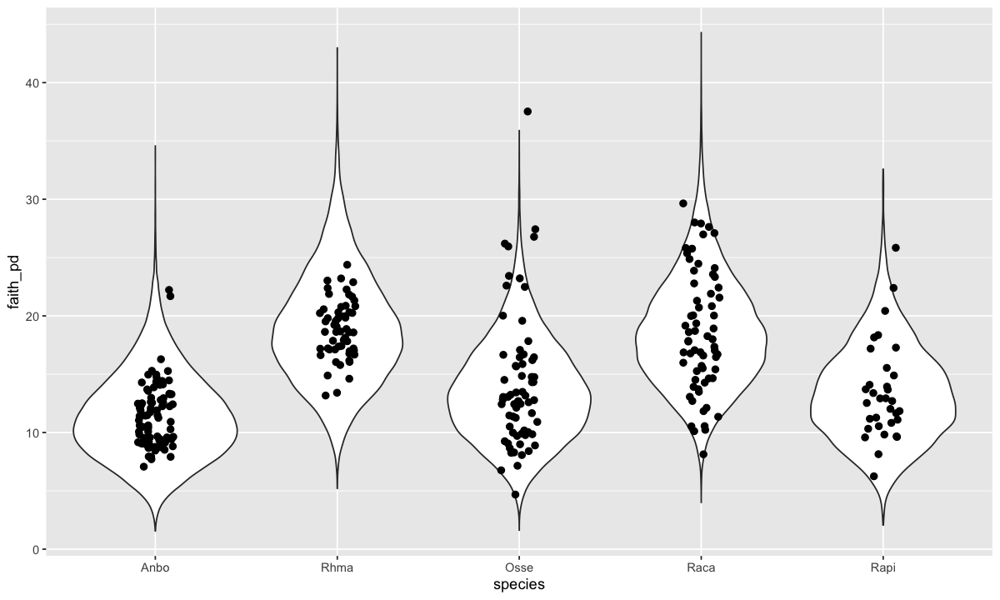

In [92]:
faith_pd_processed_all <- process_glmer_all(g_lmer = glmer_faith_pd_all
                                    , dep= "faith_pd"
                                    , name_dep="faith_pd"
                                    , transform_raw_func="None"
                                    , intercept_present=T
                                    , fit_distr="Gamma"
                                    , mf_con = mf_con
                                    , mf_treat=mf_treat
)

faith_pd_processed_all$gg_model_Distribution_of_all_values
faith_pd_processed_all$gg_p
faith_pd_processed_all$gg_ExpectedDistribution_and_Bd_exposed
faith_pd_processed_all$gg_ExpectedDistribution_controls

### Bray-curtis dispersion

In [93]:
##### DISPERSION (Bray-curtis) (II) #######
if ( RERUN_DISP ) {
  
  lmer_disper_braycurtis_all <- stan_lmer(log(disper_braycurtis) ~ -1 + species + (1|indivID) + time
                                      , data=mf_all_noinfect
                                      , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                                      , prior = normal(location=0, scale=5, autoscale=TRUE)
                                      , seed= 29473
  )
  save(lmer_disper_braycurtis_all, file="./4_Bayesian_models/lmer_disper_braycurtis_all.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_braycurtis_all.RData")
}
prior_summary(lmer_disper_braycurtis_all)

Priors for model 'lmer_disper_braycurtis_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.42,1.42,1.42,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 3.5)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

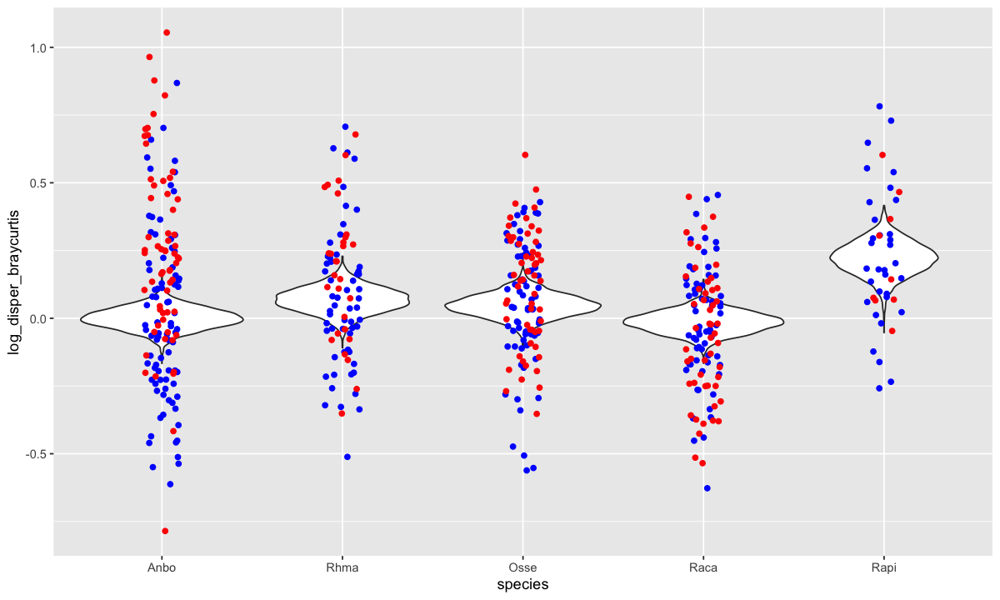

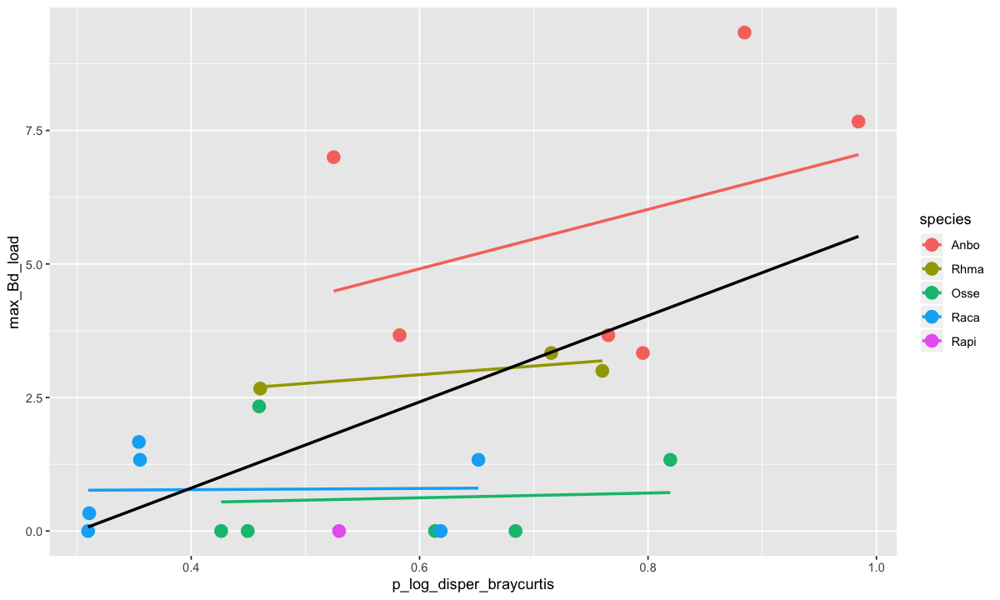

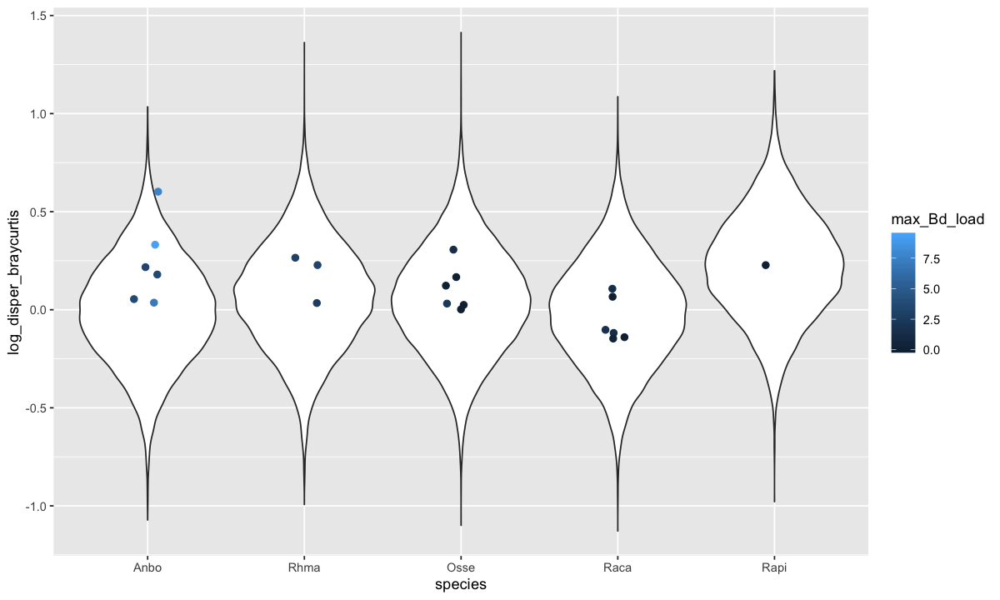

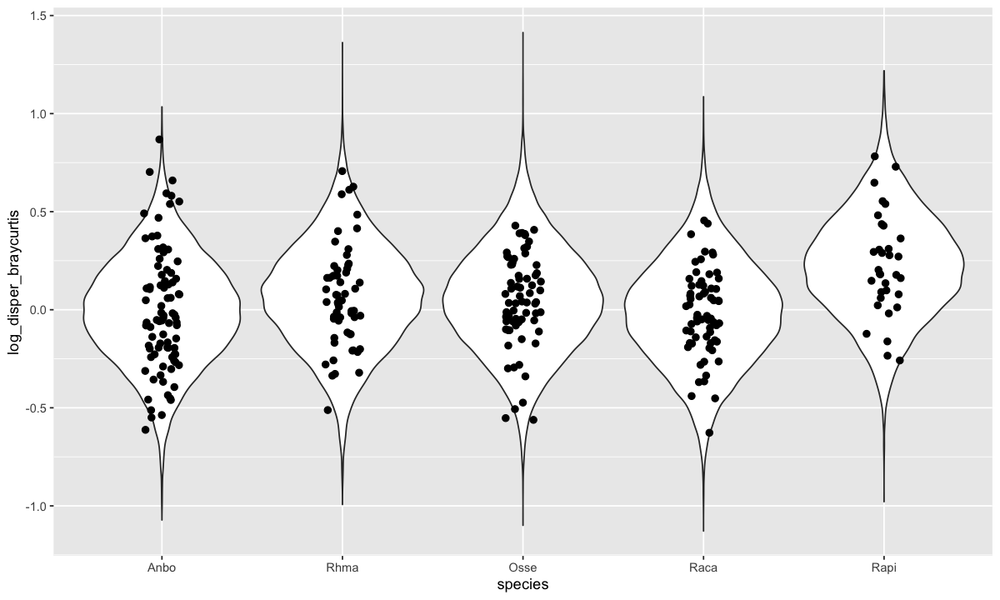

In [94]:
disper_braycurtis_processed_all <- process_glmer_all(g_lmer = lmer_disper_braycurtis_all
                                             , dep= "disper_braycurtis"
                                             , name_dep="log_disper_braycurtis"
                                             , transform_raw_func="log"
                                             , intercept_present=F
                                             , time_factor = T
                                             , fit_distr="normal"
                                             , mf_con=mf_con
                                             , mf_treat=mf_treat
)
disper_braycurtis_processed_all$gg_model_Distribution_of_all_values
disper_braycurtis_processed_all$gg_p
disper_braycurtis_processed_all$gg_ExpectedDistribution_and_Bd_exposed
disper_braycurtis_processed_all$gg_ExpectedDistribution_controls


#### Unweighted Unifrac dispersion

In [95]:
##### DISPERSION (unweighted Unifrac) (II) #######
if ( RERUN_DISP ) {
  
  lmer_disper_unweighted_unifrac_all <- stan_lmer(log(disper_unweighted_unifrac) ~ -1 + species + (1|indivID) + time
                                              , data=mf_all_noinfect
                                              , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                                              , prior = normal(location=0, scale=5, autoscale=TRUE)
                                              , seed= 29473
  )
  
  save(lmer_disper_unweighted_unifrac_all, file="./4_Bayesian_models/lmer_disper_unweighted_unifrac_all.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_unweighted_unifrac_all.RData")
}
prior_summary(lmer_disper_unweighted_unifrac_all)

Priors for model 'lmer_disper_unweighted_unifrac_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.00,1.00,1.00,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 5)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

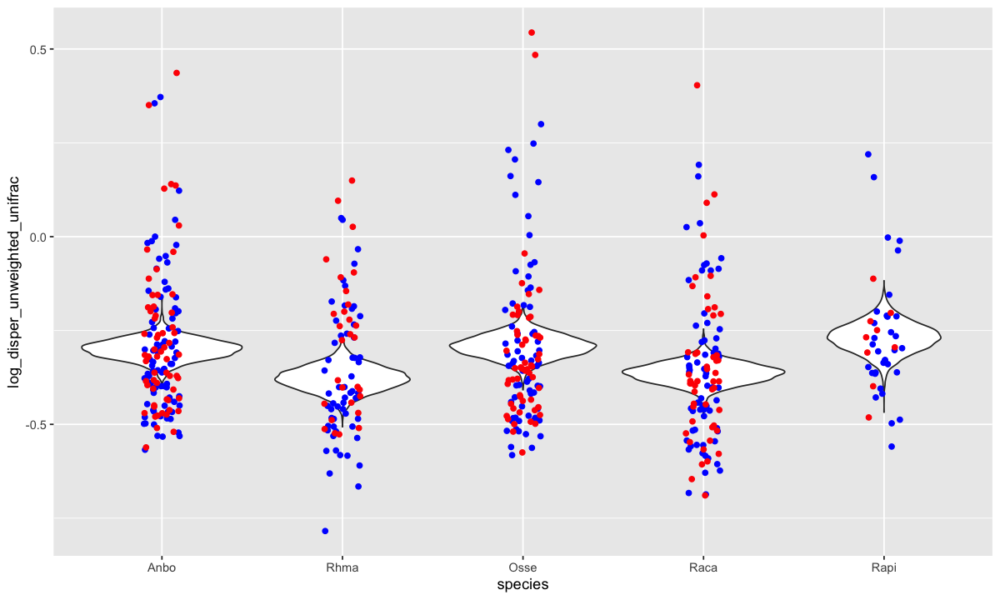

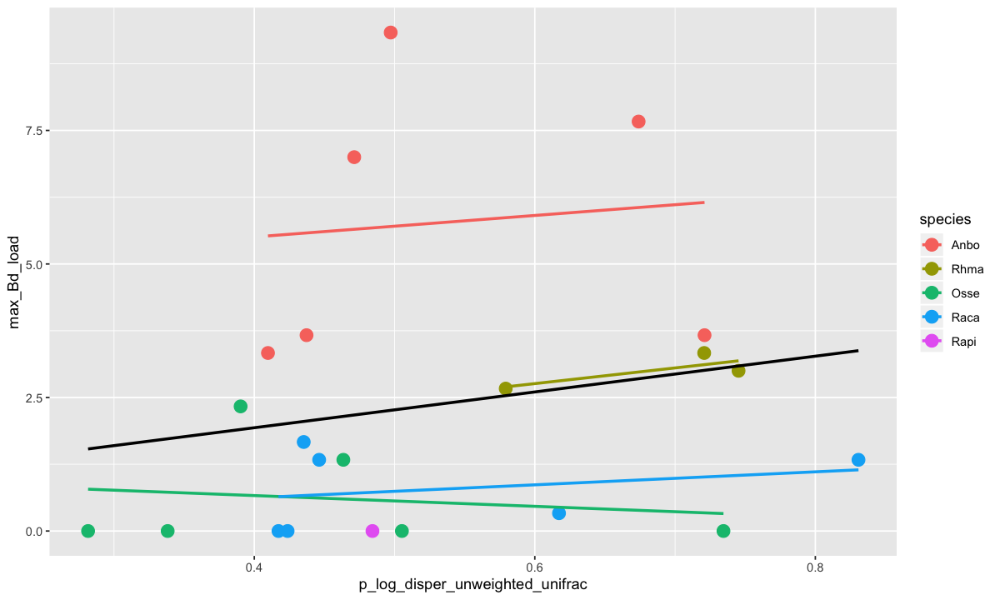

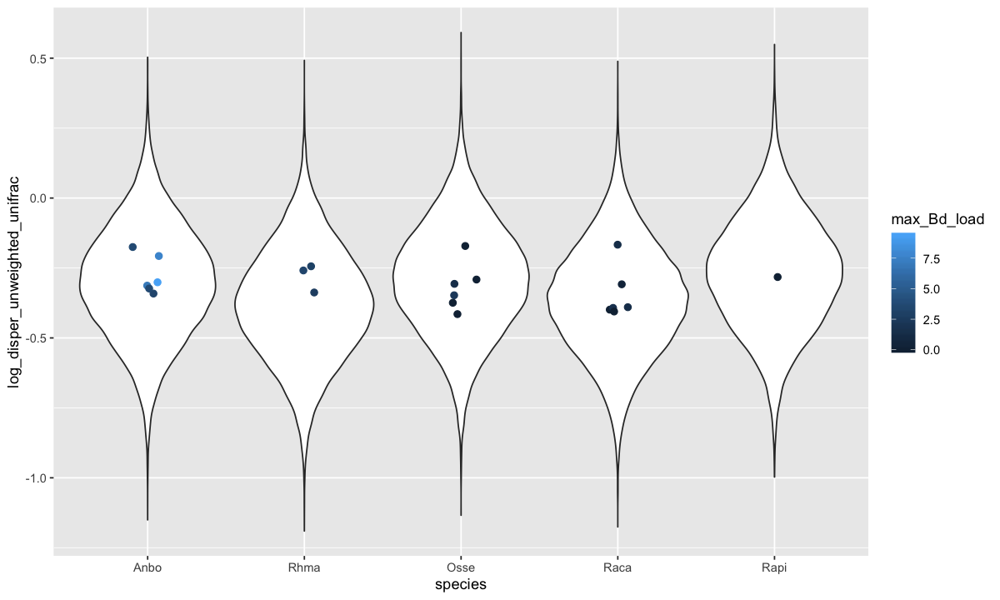

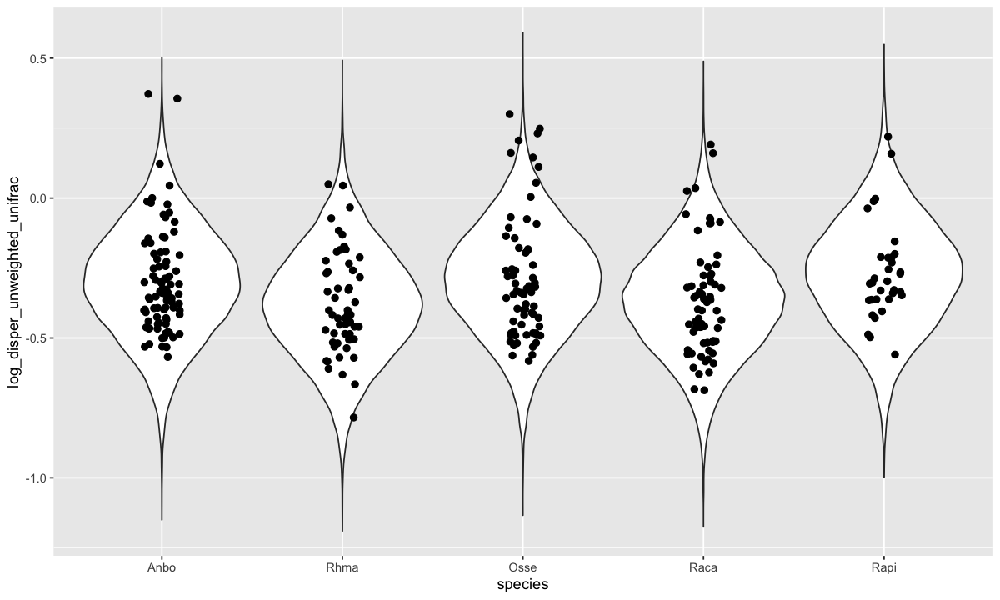

In [96]:
disper_unweighted_unifrac_processed_all <- process_glmer_all(g_lmer = lmer_disper_unweighted_unifrac_all
                                                     , dep= "disper_unweighted_unifrac"
                                                     , name_dep="log_disper_unweighted_unifrac"
                                                     , transform_raw_func="log"
                                                     , intercept_present=F
                                                     , time_factor = T
                                                     , fit_distr="normal"
                                                     , mf_con=mf_con
                                                     , mf_treat=mf_treat
)
disper_unweighted_unifrac_processed_all$gg_model_Distribution_of_all_values
disper_unweighted_unifrac_processed_all$gg_p
disper_unweighted_unifrac_processed_all$gg_ExpectedDistribution_and_Bd_exposed
disper_unweighted_unifrac_processed_all$gg_ExpectedDistribution_controls



### Weighted Unifrac dispersion

In [97]:
##### DISPERSION (weighted Unifrac) (II) #######
if ( RERUN_DISP ) {
  
  lmer_disper_weighted_unifrac_all <- stan_lmer(log(disper_weighted_unifrac) ~ -1 + species + (1|indivID) + time
                                            , data=mf_all_noinfect
                                            , prior_intercept = normal(location = 0,scale = 5, autoscale = TRUE)
                                            , prior = normal(location=0, scale=5, autoscale=TRUE)
                                            , seed= 29473
  )
  save(lmer_disper_weighted_unifrac_all, file="./4_Bayesian_models/lmer_disper_weighted_unifrac_all.RData")
} else {
  load("./4_Bayesian_models/lmer_disper_weighted_unifrac_all.RData")
}
prior_summary(lmer_disper_weighted_unifrac_all)

Priors for model 'lmer_disper_weighted_unifrac_all' 
------

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [5,5,5,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [1.99,1.99,1.99,...])

Auxiliary (sigma)
  Specified prior:
    ~ exponential(rate = 1)
  Adjusted prior:
    ~ exponential(rate = 2.5)

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

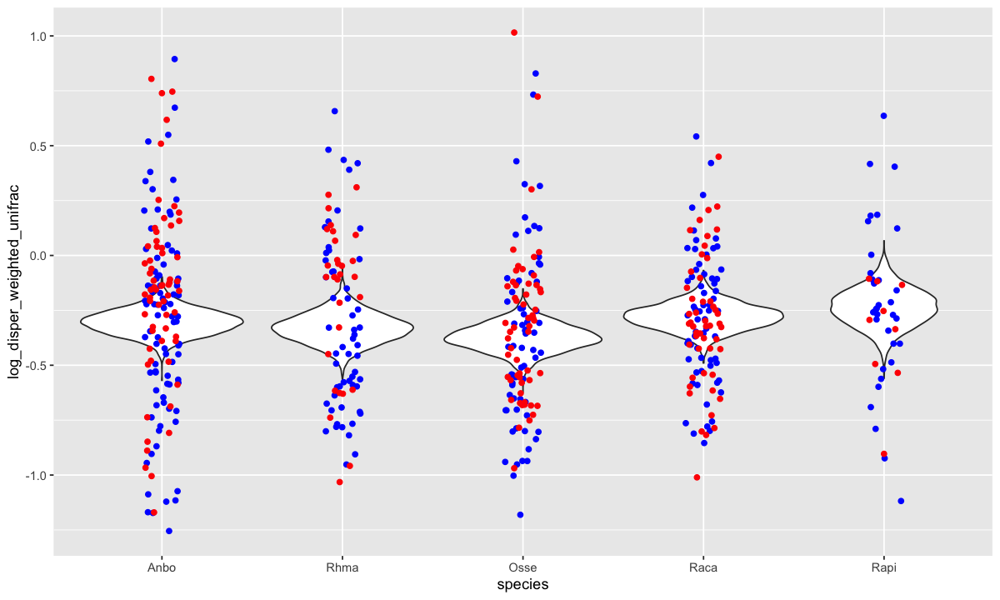

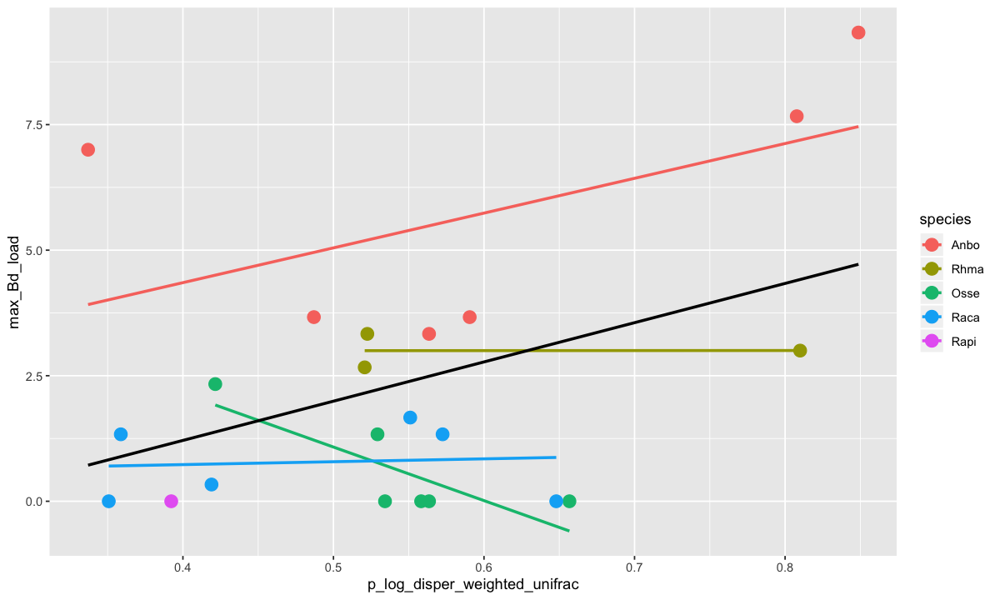

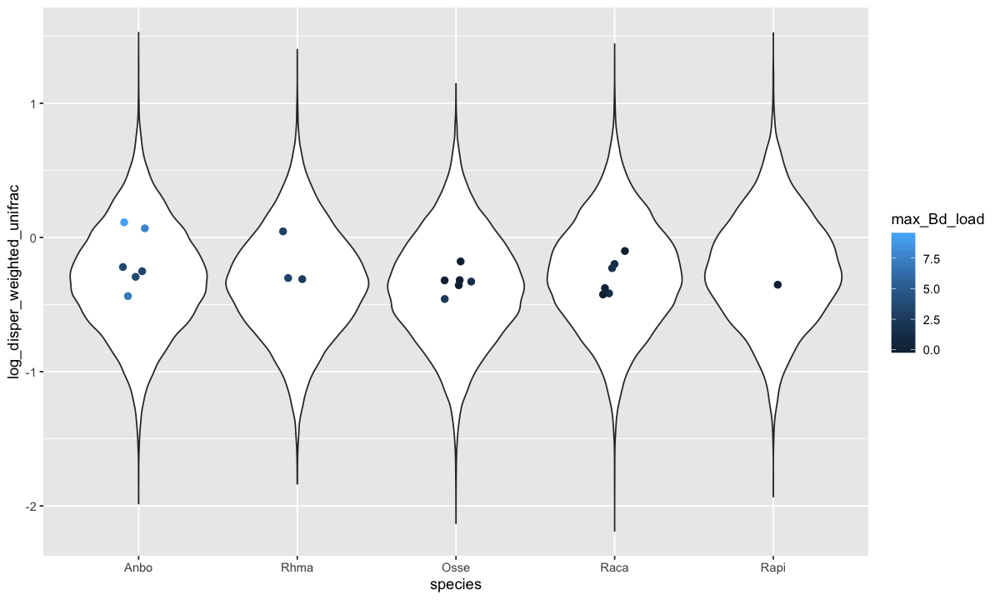

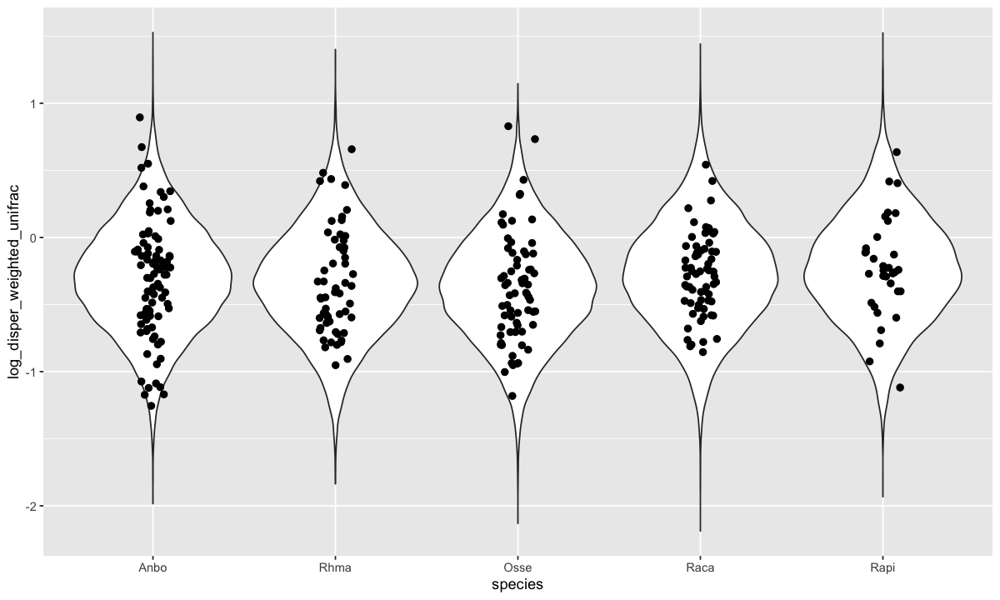

In [98]:
disper_weighted_unifrac_processed_all <- process_glmer_all(g_lmer = lmer_disper_weighted_unifrac_all
                                                   , dep= "disper_weighted_unifrac"
                                                   , name_dep="log_disper_weighted_unifrac"
                                                   , transform_raw_func="log"
                                                   , intercept_present=F
                                                   , time_factor = T
                                                   , fit_distr="normal"
                                                   , mf_con=mf_con
                                                   , mf_treat=mf_treat
)
disper_weighted_unifrac_processed_all$gg_model_Distribution_of_all_values
disper_weighted_unifrac_processed_all$gg_p
disper_weighted_unifrac_processed_all$gg_ExpectedDistribution_and_Bd_exposed
disper_weighted_unifrac_processed_all$gg_ExpectedDistribution_controls



### Bray-curtis distance

In [99]:
##### DISTANCE (Bray-curtis) (II) #######
if ( RERUN_DIST ) {
  
  glmer_dist_braycurtis_all <- stan_glmer(dist_braycurtis ~ -1 + species + (1|indivID)
                                      , data=mf_all_noinfect
                                      , family =mgcv::betar
                                      , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                      , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                      , seed= 623445
  )
  save(glmer_dist_braycurtis_all, file="./4_Bayesian_models/glmer_dist_braycurtis_all.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_braycurtis_all.RData")
}
prior_summary(glmer_dist_braycurtis_all)


Priors for model 'glmer_dist_braycurtis_all' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 58 rows containing missing values (geom_point).”Warning message:
“Removed 26 rows containing missing values (geom_point).”

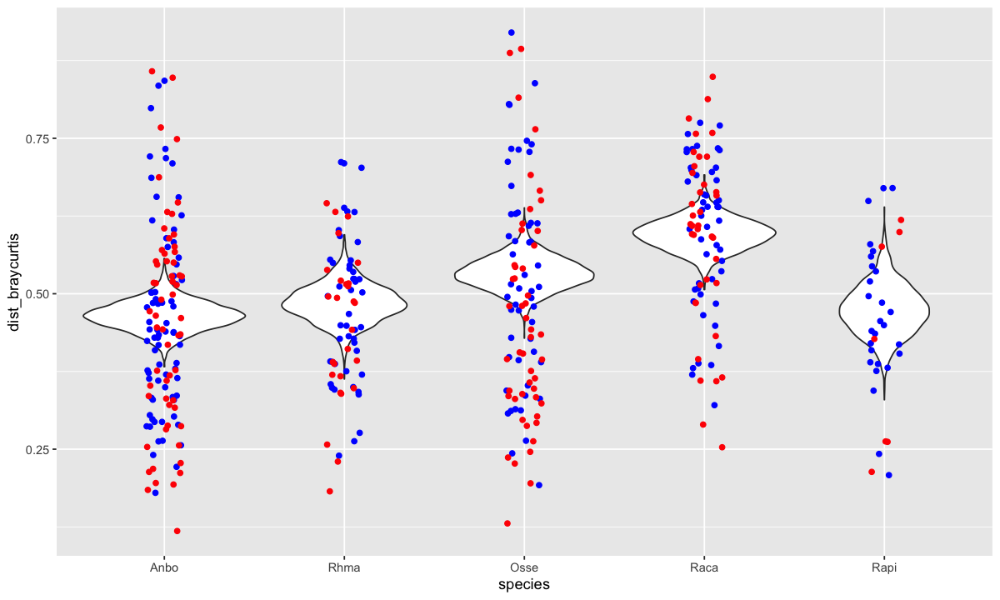

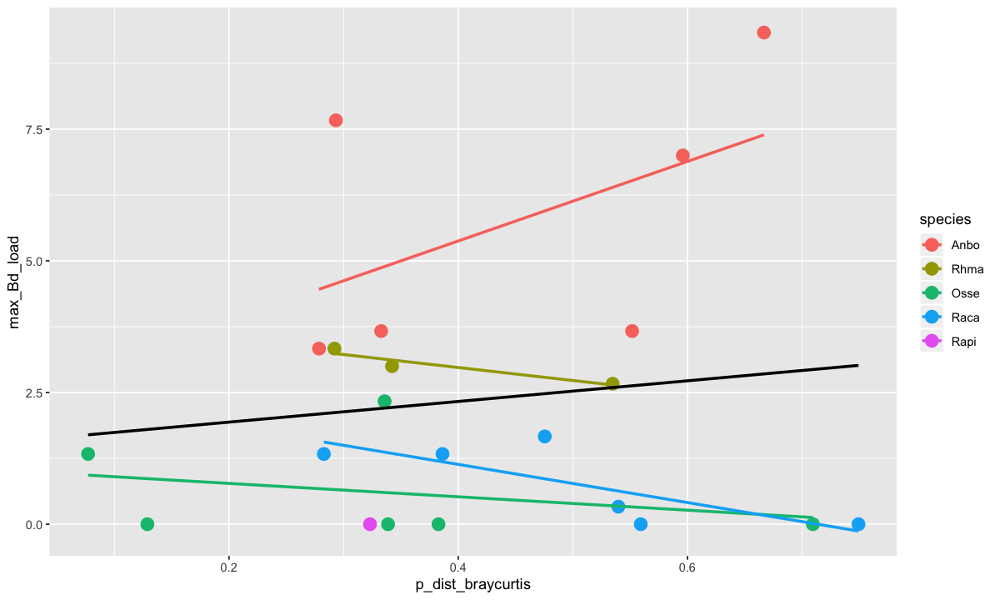

Warning message:
“Removed 58 rows containing missing values (geom_point).”

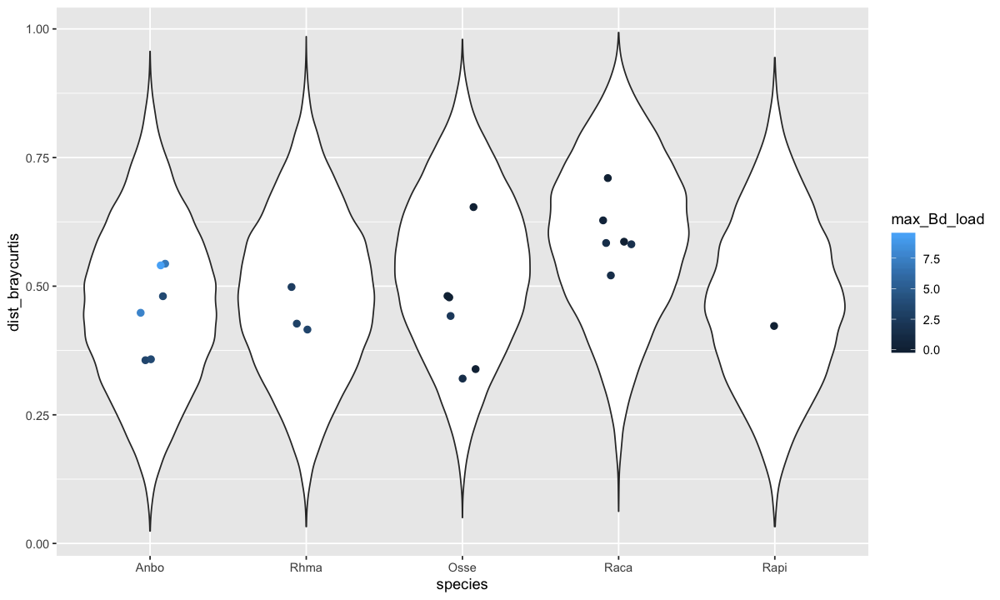

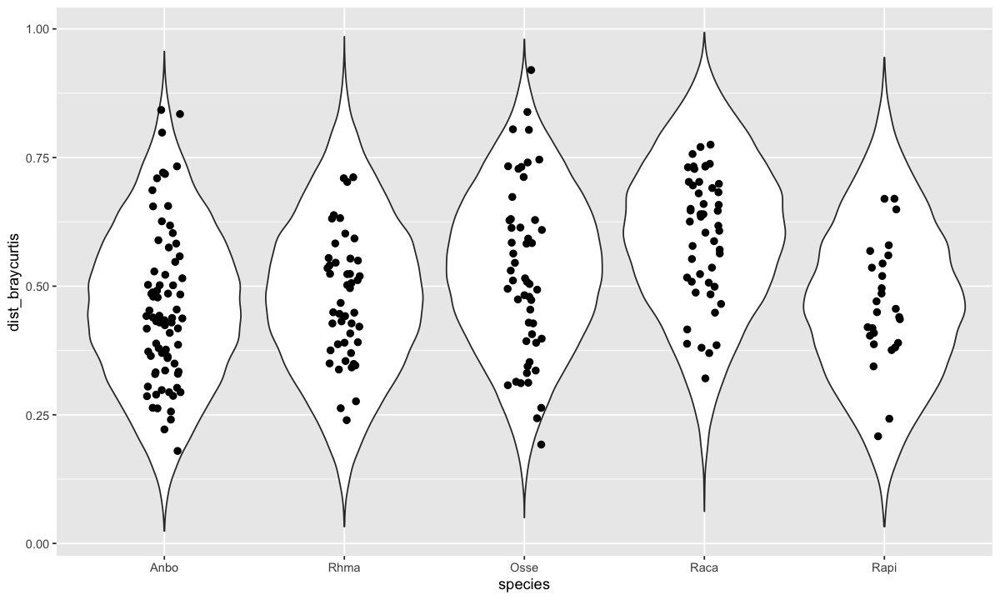

In [100]:
dist_braycurtis_processed_all <- process_glmer_all(g_lmer = glmer_dist_braycurtis_all
                                           , dep= "dist_braycurtis"
                                           , name_dep="dist_braycurtis"
                                           , transform_raw_func="beta"
                                           , intercept_present=F
                                           , fit_distr="Beta"
                                           , mf_con=mf_con
                                           , mf_treat=mf_treat
)

dist_braycurtis_processed_all$gg_model_Distribution_of_all_values
dist_braycurtis_processed_all$gg_p
dist_braycurtis_processed_all$gg_ExpectedDistribution_and_Bd_exposed
dist_braycurtis_processed_all$gg_ExpectedDistribution_controls


### Unweighted Unifrac distance

In [101]:
##### DISTANCE (unweighted Unifrac) (II) #######
if ( RERUN_DIST ) {
  
  glmer_dist_unweighted_unifrac_all <- stan_glmer(dist_unweighted_unifrac ~ -1 + species + (1|indivID)
                                              , data=mf_all_noinfect
                                              , family =mgcv::betar
                                              , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                              , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                              , seed= 623445
  )
  save(glmer_dist_unweighted_unifrac_all, file="./4_Bayesian_models/glmer_dist_unweighted_unifrac_all.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_unweighted_unifrac_all.RData")
}
prior_summary(glmer_dist_unweighted_unifrac_all)

Priors for model 'glmer_dist_unweighted_unifrac_all' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 58 rows containing missing values (geom_point).”Warning message:
“Removed 26 rows containing missing values (geom_point).”

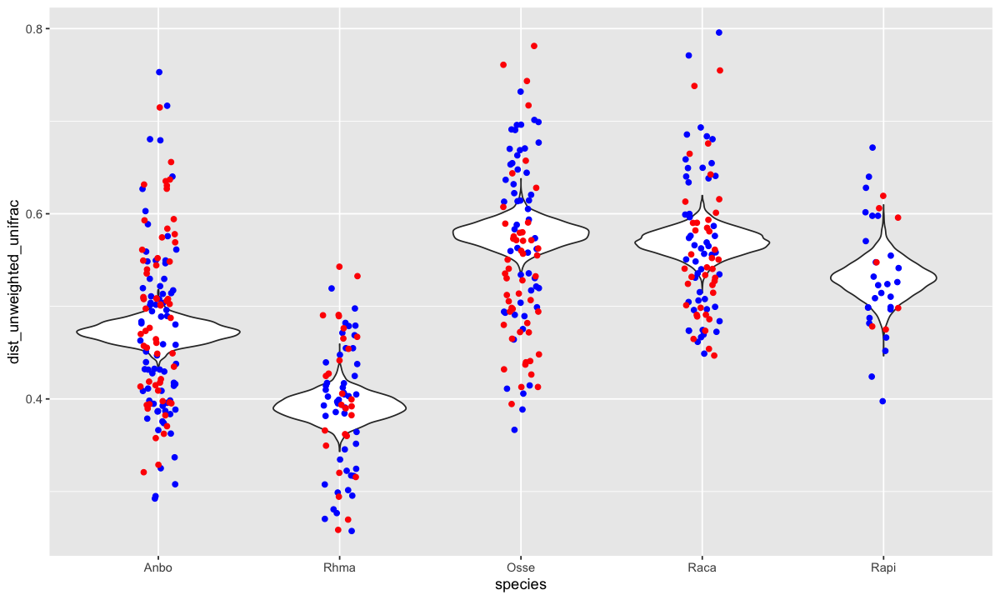

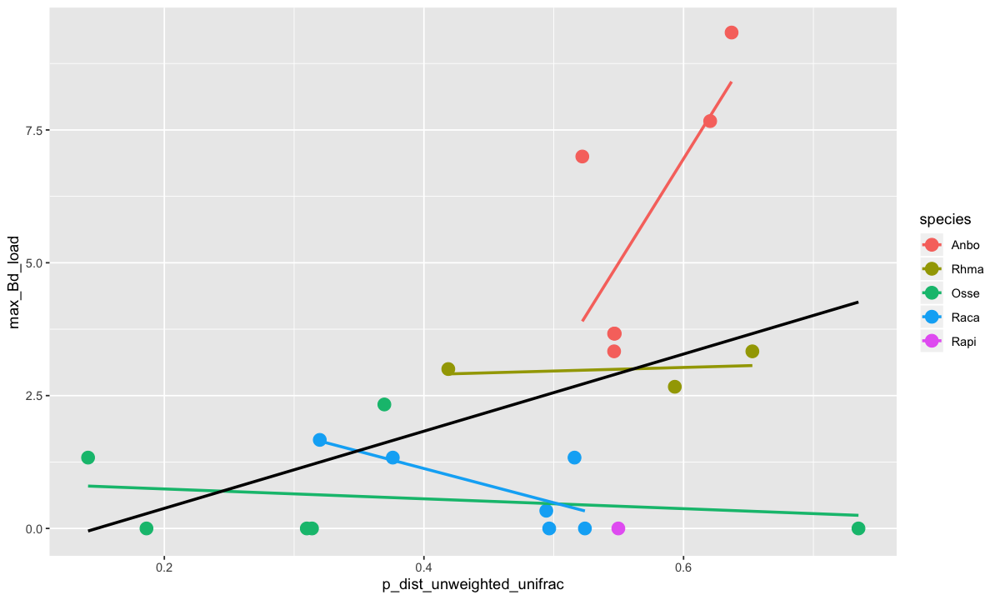

Warning message:
“Removed 58 rows containing missing values (geom_point).”

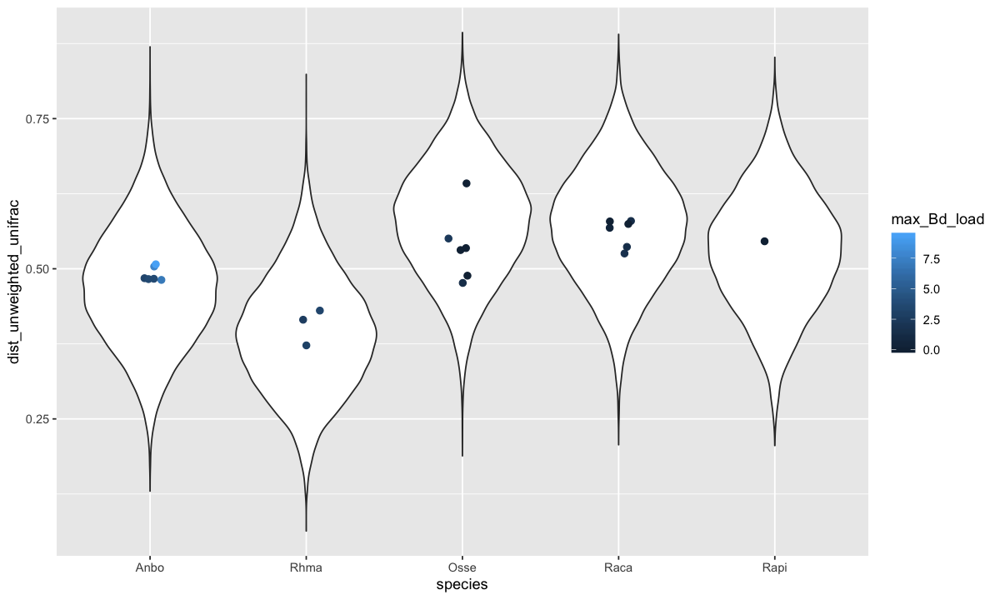

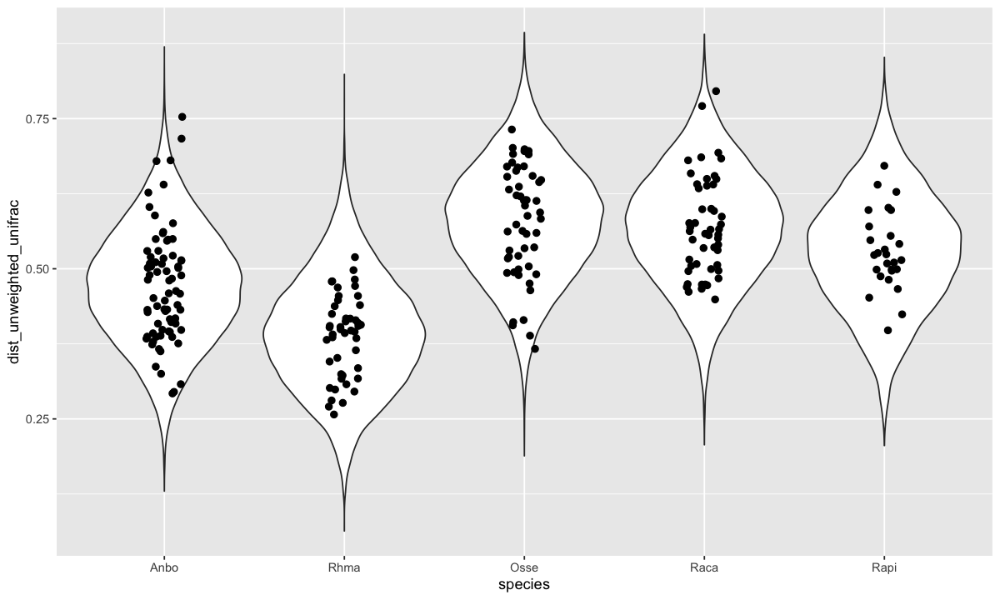

In [102]:
dist_unweighted_unifrac_processed_all <- process_glmer_all(g_lmer = glmer_dist_unweighted_unifrac_all
                                                   , dep= "dist_unweighted_unifrac"
                                                   , name_dep="dist_unweighted_unifrac"
                                                   , transform_raw_func="beta"
                                                   , intercept_present=F
                                                   , fit_distr="Beta"
                                                   , mf_con=mf_con
                                                   , mf_treat=mf_treat
)

dist_unweighted_unifrac_processed_all$gg_model_Distribution_of_all_values
dist_unweighted_unifrac_processed_all$gg_p
dist_unweighted_unifrac_processed_all$gg_ExpectedDistribution_and_Bd_exposed
dist_unweighted_unifrac_processed_all$gg_ExpectedDistribution_controls

### Weighted Unifrac distance

In [103]:
##### DISTANCE (weighted Unifrac) (II) #######
if ( RERUN_DIST ) {
  
  glmer_dist_weighted_unifrac_all <- stan_glmer(dist_weighted_unifrac ~ -1 + species + (1|indivID)
                                            , data=mf_all_noinfect
                                            , family =mgcv::betar
                                            , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                            , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                            , seed= 623445
  )
  save(glmer_dist_weighted_unifrac_all, file="./4_Bayesian_models/glmer_dist_weighted_unifrac_all.RData")
} else {
  load("./4_Bayesian_models/glmer_dist_weighted_unifrac_all.RData")
}
prior_summary(glmer_dist_weighted_unifrac_all)

Priors for model 'glmer_dist_weighted_unifrac_all' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message:
“Removed 58 rows containing missing values (geom_point).”Warning message:
“Removed 26 rows containing missing values (geom_point).”

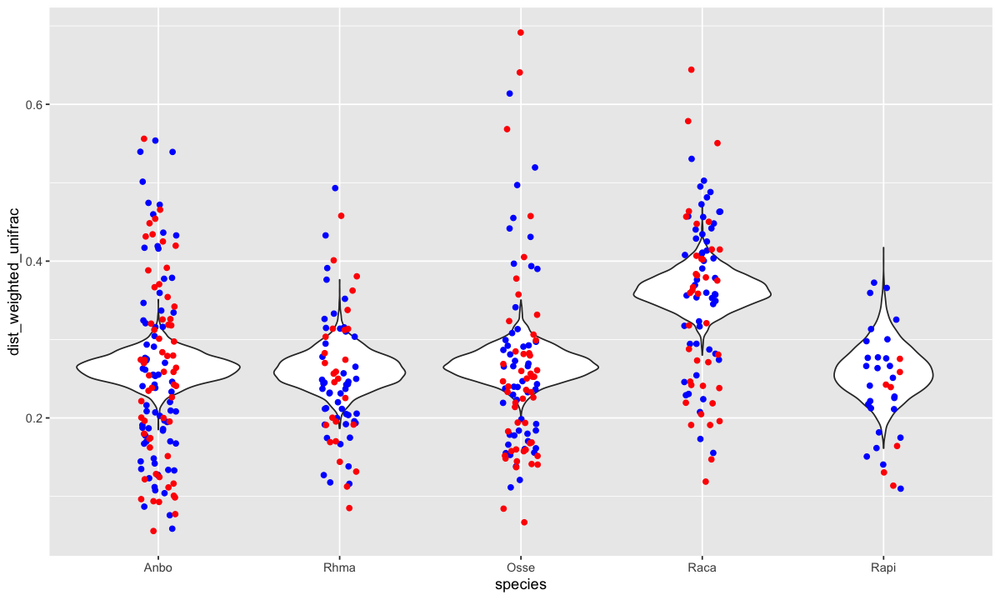

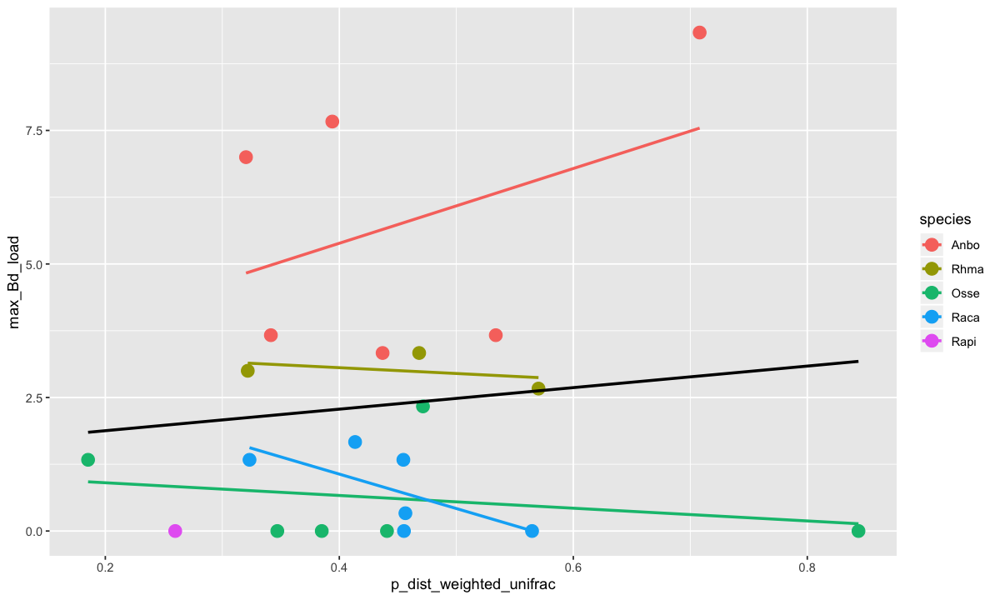

Warning message:
“Removed 58 rows containing missing values (geom_point).”

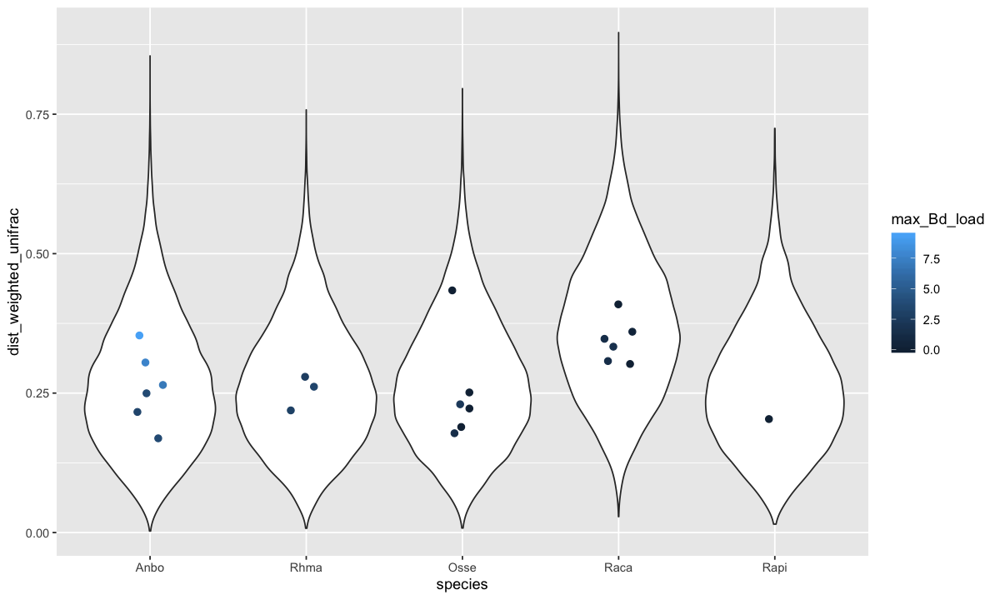

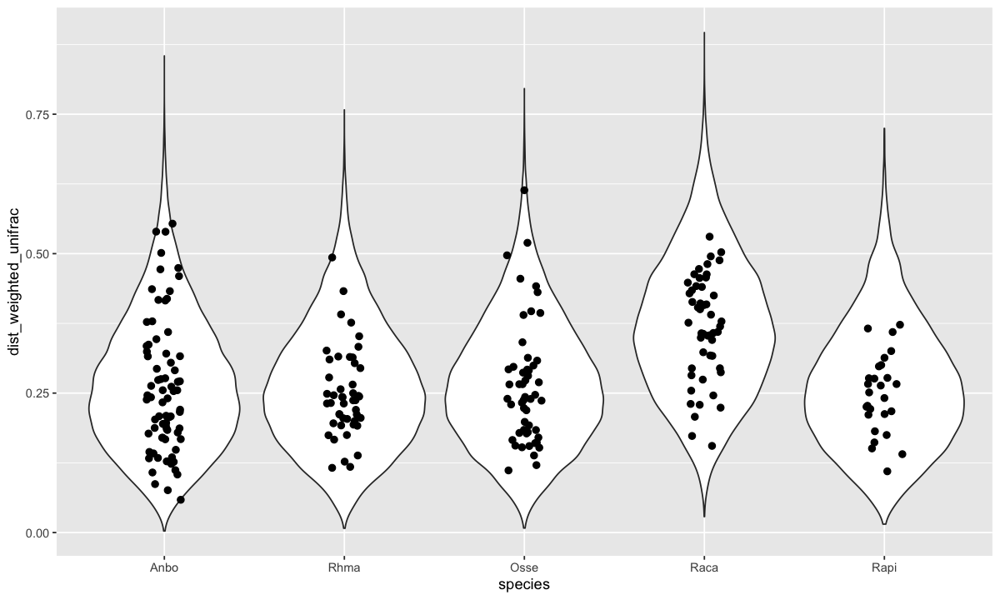

In [104]:
dist_weighted_unifrac_processed_all <- process_glmer_all(g_lmer = glmer_dist_weighted_unifrac_all
                                                 , dep= "dist_weighted_unifrac"
                                                 , name_dep="dist_weighted_unifrac"
                                                 , transform_raw_func="beta"
                                                 , intercept_present=F
                                                 , fit_distr="Beta"
                                                 , mf_con=mf_con
                                                 , mf_treat=mf_treat
)

dist_weighted_unifrac_processed_all$gg_model_Distribution_of_all_values
dist_weighted_unifrac_processed_all$gg_p
dist_weighted_unifrac_processed_all$gg_ExpectedDistribution_and_Bd_exposed
dist_weighted_unifrac_processed_all$gg_ExpectedDistribution_controls

### Percent inhibitory

In [105]:
##### PERCENT INHIBITORY (II) #######
if ( RERUN_PERCINHIB ) {
  
  glmer_percInhib_all <- stan_glmer(percInhib ~ -1 + species + (1|indivID)
                                , data=mf_all_noinfect
                                , family =mgcv::betar
                                , prior_intercept = normal(location = 0.5,scale = 2.5, autoscale = TRUE)
                                , prior = normal(location=0.5, scale=2.5, autoscale=TRUE)
                                , seed= 59283
  )
  save(glmer_percInhib_all, file="./4_Bayesian_models/glmer_percInhib_all.RData")
} else {
  load("./4_Bayesian_models/glmer_percInhib_all.RData")
}
prior_summary(glmer_percInhib_all)

Priors for model 'glmer_percInhib_all' 
------

Coefficients
 ~ normal(location = [0.5,0.5,0.5,...], scale = [2.5,2.5,2.5,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

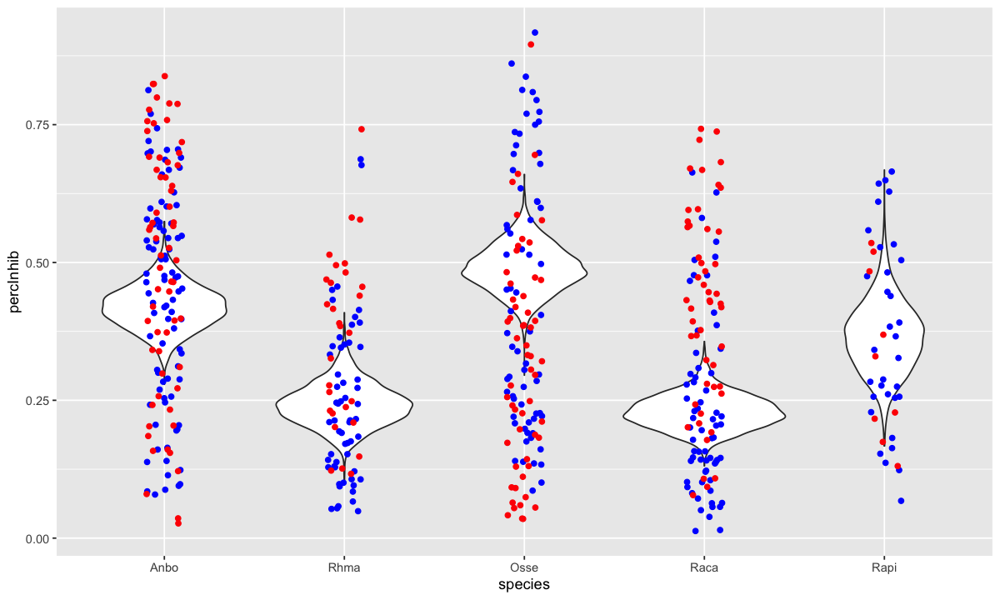

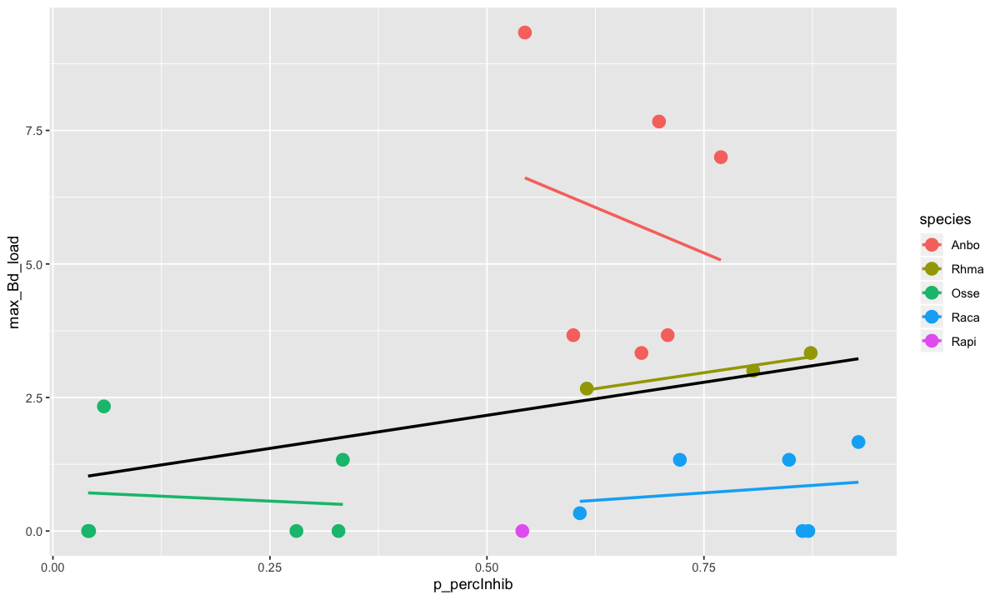

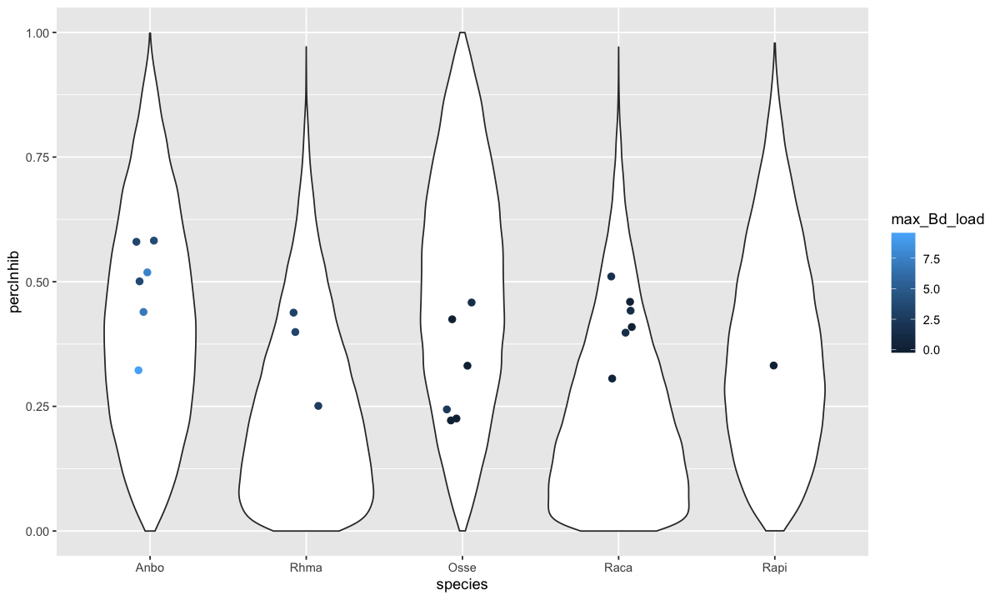

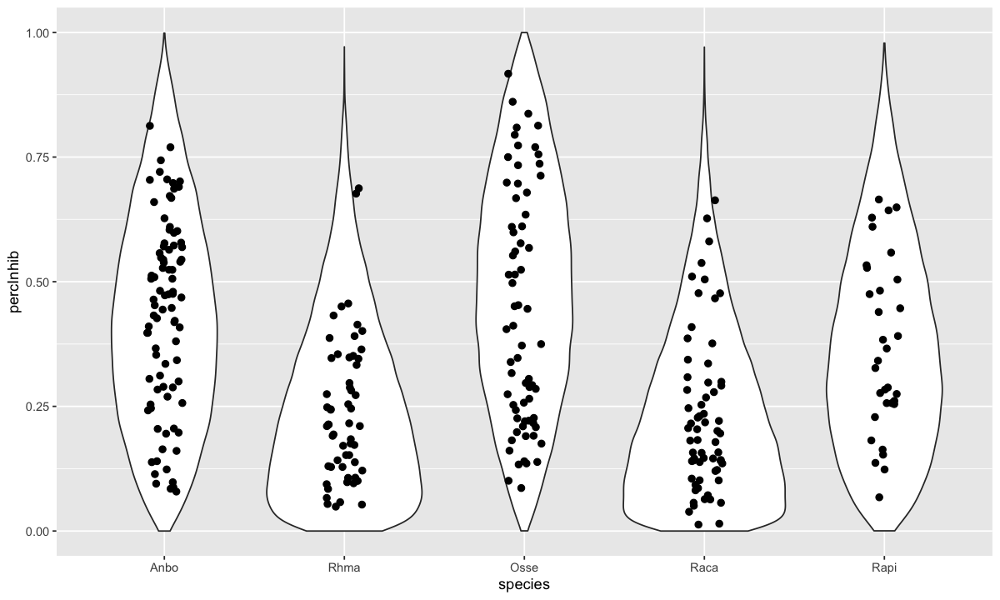

In [106]:
percInhib_processed_all <- process_glmer_all(g_lmer = glmer_percInhib_all
                                     , dep= "percInhib"
                                     , name_dep="percInhib"
                                     , transform_raw_func="beta"
                                     , intercept_present=F
                                     , fit_distr="Beta"
                                     , mf_con=mf_con
                                     , mf_treat=mf_treat
)

percInhib_processed_all$gg_model_Distribution_of_all_values
percInhib_processed_all$gg_p
percInhib_processed_all$gg_ExpectedDistribution_and_Bd_exposed
percInhib_processed_all$gg_ExpectedDistribution_controls

### Inhibitory richness

In [108]:
##### INHIBITORY RICHNESS (II) #######
if ( RERUN_INHIBRICH ) {
  # Here, I include a random variable of sample because of over-dispersion from poisson
  glmer_inhibRich_all <- stan_glmer(inhibRich ~ species + (1|indivID) + (1|SampleID) + time, data=mf_all_noinfect
                                , prior = normal(0, 10, autoscale = TRUE)
                                , family= poisson(link="identity")
                                , seed = 5423409)
  
  save(glmer_inhibRich_all, file="./4_Bayesian_models/glmer_inhibRich_all.RData")
} else {
  load("./4_Bayesian_models/glmer_inhibRich_all.RData")
}
prior_summary(glmer_inhibRich_all)

Priors for model 'glmer_inhibRich_all' 
------
Intercept (after predictors centered)
 ~ normal(location = 0, scale = 10)

Coefficients
  Specified prior:
    ~ normal(location = [0,0,0,...], scale = [10,10,10,...])
  Adjusted prior:
    ~ normal(location = [0,0,0,...], scale = [10.00,10.00,10.00,...])

Covariance
 ~ decov(reg. = 1, conc. = 1, shape = 1, scale = 1)
------
See help('prior_summary.stanreg') for more details

Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 7.420671”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.162367”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.291519”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 10.774911”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.549823”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 12.066430”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.904063”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.808126”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.678975”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 8.033215”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.291519”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 5.904063”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 11.774

“non-integer x = 11.774911”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 9.162367”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 10.291519”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 15.904063”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 21.033215”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 19.774911”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 14.808126”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 16.420671”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 15.066430”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 14.549823”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 12.904063”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 16.291519”Warning message in dpois(x, estimate, log = TRUE):
“non-integer x = 14.678975”Warning message in dpois(x, estimate, 

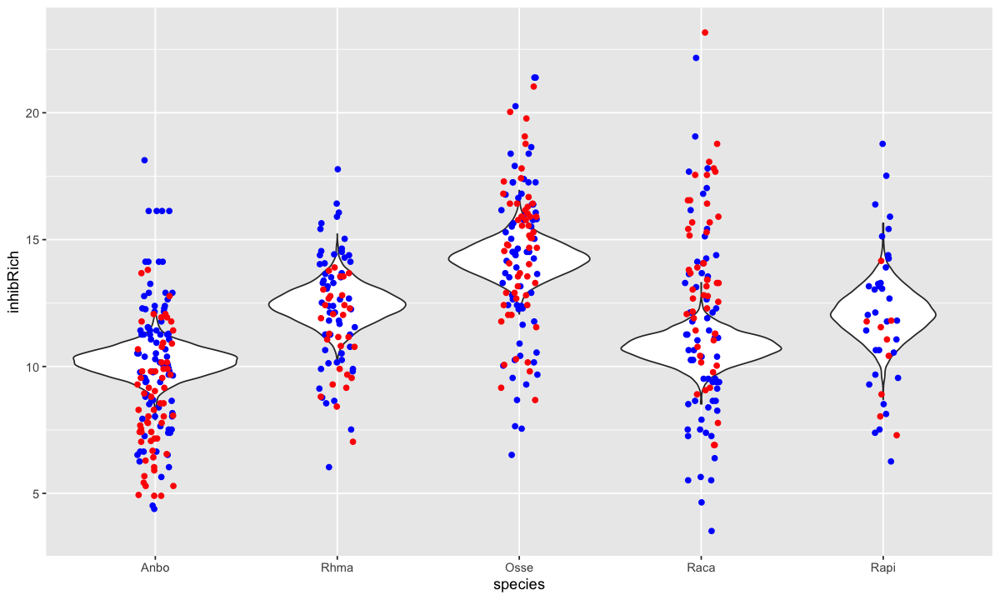

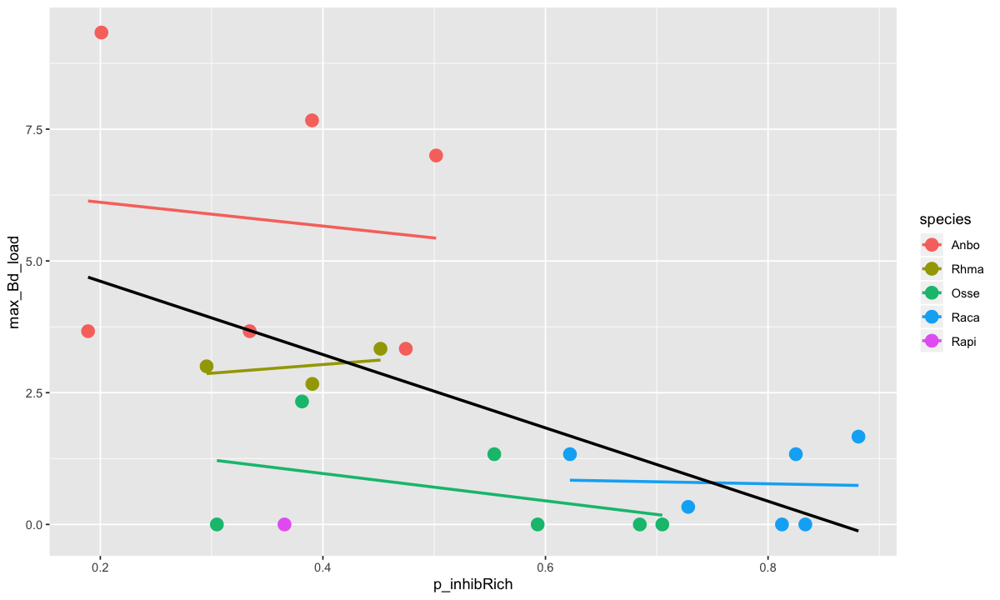

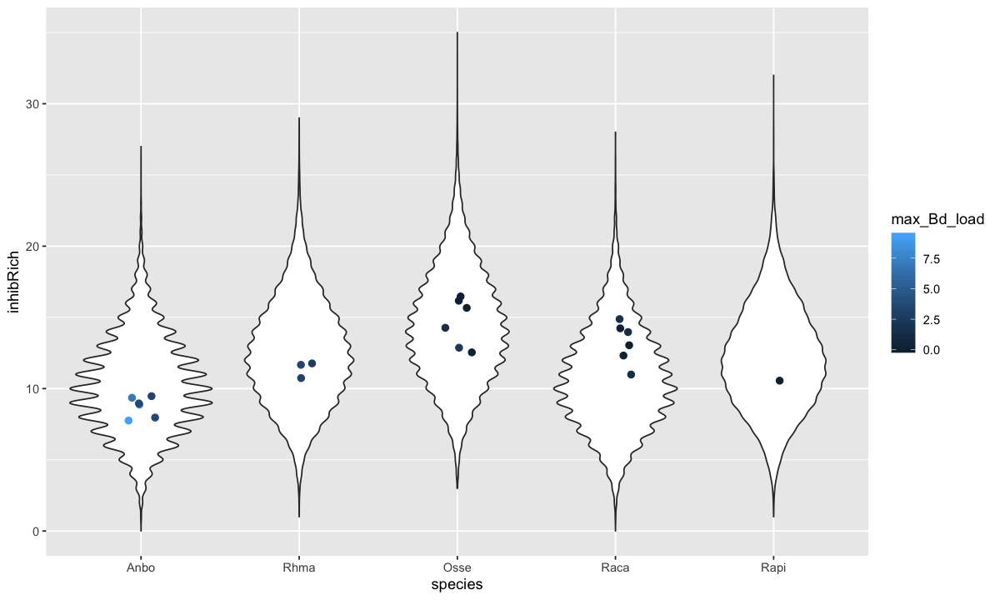

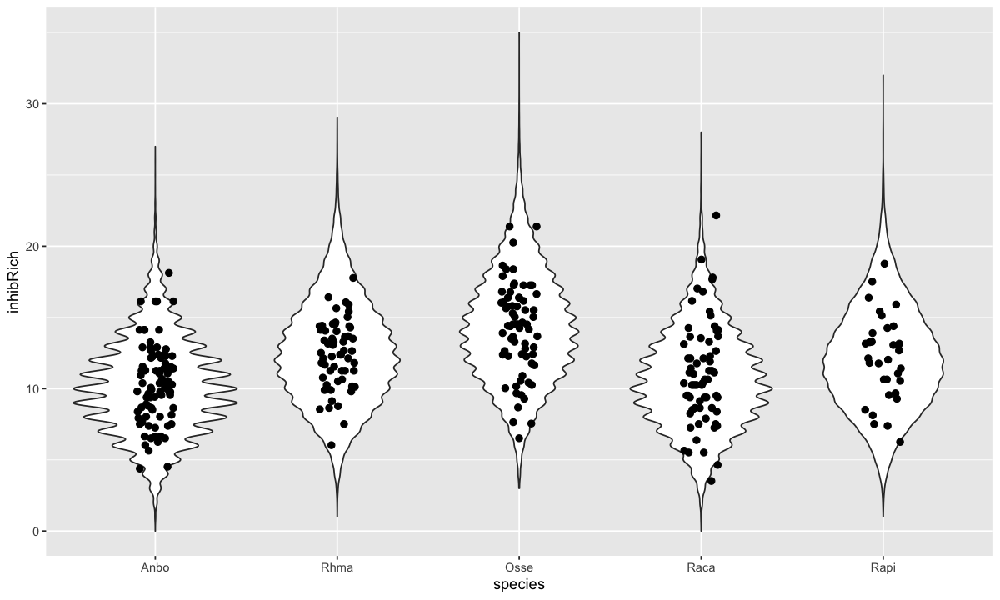

In [109]:
inhibRich_processed_all <- process_glmer_all(g_lmer = glmer_inhibRich_all
                                     , dep= "inhibRich"
                                     , name_dep="inhibRich"
                                     , transform_raw_func="None"
                                     , intercept_present=T
                                     , fit_distr="Poisson"
                                     , mf_con=mf_con
                                     , mf_treat=mf_treat
                                     , time_factor=T
)

inhibRich_processed_all$gg_model_Distribution_of_all_values
inhibRich_processed_all$gg_p
inhibRich_processed_all$gg_ExpectedDistribution_and_Bd_exposed
inhibRich_processed_all$gg_ExpectedDistribution_controls


### Combine info

In [110]:
# Combine all p values and save work
all_tabs <- c("observed_otus"
              , "chao1"
              , "shannon"
              , "faith_pd"
              , "disper_braycurtis"
              , "disper_unweighted_unifrac"
              , "disper_weighted_unifrac"
              , "dist_braycurtis"
              , "dist_unweighted_unifrac"
              , "dist_weighted_unifrac"
              , "percInhib"
              , "inhibRich")
# Change names of columns so they're different
for ( tab in all_tabs) {
  temp_tab <- get(paste0(tab,"_processed_all"))$all_p 
  name1 <- paste0("exp_",tab)
  name2 <- paste0("p_",tab)
  colnames(temp_tab) <- c("indivID",name1, name2,"max_Bd_load")
  assign(paste0("all_p_pred_",tab), temp_tab)
}


In [111]:
# combine all_p's
all_p_pred <- data.frame(indivID=observed_otus_processed_all$all_p$indivID, infect=observed_otus_processed_all$all_p$infect) 
for ( tab in all_tabs ) {
  all_p_pred <- get(paste0("all_p_pred_",tab)) %>%
    dplyr::select(indivID,paste0("exp_",tab), paste0("p_",tab)) %>%
    left_join(all_p_pred)
}

save(all_p_pred, file="./4_Bayesian_models/all_p_pred.RData")

Joining, by = "indivID"Warning message:
“Column `indivID` joining character vector and factor, coercing into character vector”Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"Joining, by = "indivID"